# Self-Driving Car Engineer Nanodegree

## Deep Learning

## Project: Build a Traffic Sign Recognition Classifier

In this notebook, a template is provided for you to implement your functionality in stages, which is required to successfully complete this project. If additional code is required that cannot be included in the notebook, be sure that the Python code is successfully imported and included in your submission if necessary. 

> **Note**: Once you have completed all of the code implementations, you need to finalize your work by exporting the iPython Notebook as an HTML document. Before exporting the notebook to html, all of the code cells need to have been run so that reviewers can see the final implementation and output. You can then export the notebook by using the menu above and navigating to  \n",
    "**File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission. 

In addition to implementing code, there is a writeup to complete. The writeup should be completed in a separate file, which can be either a markdown file or a pdf document. There is a [write up template](https://github.com/udacity/CarND-Traffic-Sign-Classifier-Project/blob/master/writeup_template.md) that can be used to guide the writing process. Completing the code template and writeup template will cover all of the [rubric points](https://review.udacity.com/#!/rubrics/481/view) for this project.

The [rubric](https://review.udacity.com/#!/rubrics/481/view) contains "Stand Out Suggestions" for enhancing the project beyond the minimum requirements. The stand out suggestions are optional. If you decide to pursue the "stand out suggestions", you can include the code in this Ipython notebook and also discuss the results in the writeup file.


>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut. In addition, Markdown cells can be edited by typically double-clicking the cell to enter edit mode.

---
## Step 0: Load The Data

In [1]:
import numpy as np
import cv2
import pickle
import csv
import os
import matplotlib.image as mpimg

class DeepDataEngine:
    """
    Data engine.
    Main purpose - work with augmented data amounts of any size, create it and feed it to leaning and validation process
    """

    def __init__(
        self,
        set_name,
        storage_dir = './deep_storage',
        mem_size = 128 * 1024 * 1024,
        batch_size = 128):

        self.set_name = set_name
        self.storage_dir = storage_dir
        self.mem_size = mem_size
        self.batch_size = batch_size
        self.features = None
        self.labels = None
        self.descriptions = None
        self.storage_files = []
        self.storage_file_active = -1
        self.storage_buf_x = None
        self.storage_buf_y = None
        self.storage_buf_pos = 0
        self.data_depth = 2 # Depends on storage pre-processing algorithm
        self.hist_clache = cv2.createCLAHE(clipLimit = 40.0, tileGridSize = (4, 4))

    def isVirtual(self):
        return False

    def loadDescriptionsFromFile(self, file_path):
        self.descriptions = {}

        n_classes = -1
        with open(file_path) as csvfile:
            reader = csv.DictReader(csvfile)
        
            for row in reader:
                curClass = int(row['ClassId'])
                n_classes = max(n_classes, curClass)
                self.descriptions[curClass] = row['SignName']

        n_classes += 1
        for curClass in range(n_classes):
            if not(curClass in self.descriptions):
                self.descriptions[curClass] = 'Class {}'.format(curClass)

    def _unpickleFromFile(self, file_path):
        with open(file_path, mode='rb') as f:
            data_set = pickle.load(f)
    
        X_data, y_data = data_set['features'], data_set['labels']

        assert(X_data.shape[0] == y_data.shape[0])

        return X_data, y_data

    def _pickleToFile(self, file_path, X_data, y_data):
        with open(file_path, mode='wb') as f:
            data_set = {'features' : X_data, 'labels' : y_data}
            pickle.dump(data_set, f, pickle.HIGHEST_PROTOCOL)

    def loadDataFromFile(self, file_path):
        self.features, self.labels = self._unpickleFromFile(file_path)

    def loadDataFromImageSet(self, dir_path, img_width = 32, img_height = 32):
        images_list = os.listdir(dir_path)

        x_data = []
        y_data = []

        for image_name in images_list:
            idx = image_name.find('_')
            if idx > 0:
                img_class = int(image_name[:idx])

                image_path = dir_path + '/' + image_name
                image = cv2.imread(image_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                image = cv2.resize(image, (img_height, img_width), interpolation = cv2.INTER_AREA)
                
                x_data += [image]
                y_data += [img_class]

        self.features = np.reshape(x_data, (-1, 32, 32, 3))
        self.labels = np.reshape(y_data, (-1))

        assert(self.features.shape[0] == self.labels.shape[0])

    def saveDataToImages(self, dir_path, img_format = 'png'):
        try:
            os.makedirs(dir_path)
        except:
            pass

        cnt = self.features.shape[0]
        for idx in range(cnt):
            mpimg.imsave('{}/{:0>3}_{:0>6}.{}'.format(dir_path, self.labels[idx], idx, img_format), self.features[idx], format = img_format)

    def getData(self):
        return self.features, self.labels

    def getDataSize(self):
        return self.features.shape[0]

    def getImageShape(self):
        return self.features.shape[1::]

    def getDataShape(self):
        return (self.features.shape[1], self.features.shape[2], self.data_depth)

    def getClassesNum(self):
        return np.max(self.labels) + 1

    def getDescriptions(self):
        return self.descriptions

    def getDataStatistic(self, samples = 5):
        permutation = np.random.permutation(self.features.shape[0])
        x_data = self.features[permutation]
        y_data = self.labels[permutation]

        n_classes = np.max(y_data) + 1
        stat_classes = np.zeros(n_classes, dtype = int)
        samples_dict = {idx : [] for idx in range(n_classes)}
        for idx in range(x_data.shape[0]):
            curClass = y_data[idx]
            stat_classes[curClass] += 1
            
            dict_smpl_list = samples_dict[curClass]
            
            if len(dict_smpl_list) < samples:
                dict_smpl_list += [x_data[idx]]

        return stat_classes, samples_dict

    def clearData(self):
        self.features = None
        self.labels = None

    def _loadStorage(self):
        self.storage_files = []
        self.storage_file_active = -1

        set_file_base_name = self.set_name + '_';

        try:
            os.makedirs(self.storage_dir)
        except:
            pass

        try:
            for file_name in os.listdir(self.storage_dir):
                file_path = self.storage_dir + '/' + file_name
                if (os.path.exists(file_path) and
                    os.path.isfile(file_path) and
                    (str(os.path.splitext(file_path)[1]).upper() in ('.DAT')) and
                    (str(file_name[:len(set_file_base_name)]).upper() == str(set_file_base_name).upper())):
                    
                    self.storage_files += [file_path]

        except:
            pass

    def _delete_storage(self):
        for file_name in self.storage_files:
            try:
                os.remove(file_name)
            except:
                pass

        self.storage_files = []

    def _pre_transform_image(self, img):
        data_width = img.shape[1]
        data_height = img.shape[0]

        center_col = np.random.uniform(data_width / 3.0, 2.0 * (data_width / 3.0))
        center_row = np.random.uniform(data_height / 3.0, 2.0 * (data_height / 3.0))
        rot_angle = np.random.uniform(-30.0, 30.0)
        scale_factor = np.random.uniform(-0.3, 0.3)
        affineM = cv2.getRotationMatrix2D((center_col, center_row), rot_angle, 1.0 + scale_factor)

        img_proc = cv2.warpAffine(img, affineM, (data_width, data_height), borderMode = cv2.BORDER_REFLECT)
        
        return img_proc

    def _pre_process_image(self, img):
        img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        img_gray_norm = self.hist_clache.apply(img_gray)

        max_val = float(np.max(img_gray))
        min_val = float(np.min(img_gray))

        if min_val < max_val:
            mid_val = (max_val + min_val) / 2.0
            dif_val = (max_val - min_val) / 2.0

            img_gray = (img_gray - mid_val) / dif_val

        max_val = float(np.max(img_gray_norm))
        min_val = float(np.min(img_gray_norm))

        if min_val < max_val:
            mid_val = (max_val + min_val) / 2.0
            dif_val = (max_val - min_val) / 2.0

            img_gray_norm = (img_gray_norm - mid_val) / dif_val

        img_set = (img_gray, img_gray_norm)

        return img_set

    def _create_storage(self, class_samples):
        try:
            os.makedirs(self.storage_dir)
        except:
            pass

        data_shape = self.features.shape
        n_classes = np.max(self.labels) + 1

        data_size = data_shape[0]
        data_height = data_shape[1]
        data_width = data_shape[2]

        buf_size = int(self.mem_size / (data_height * data_width * self.data_depth))

        x_buf = np.zeros((buf_size, data_height, data_width, self.data_depth))
        y_buf = np.zeros(buf_size, dtype = self.labels.dtype)

        samples_cnt = np.zeros(n_classes, dtype = int)
        samples_idx = {idx : [] for idx in range(n_classes)}
        for idx in range(data_size):
            curClass = self.labels[idx]
            samples_cnt[curClass] += 1
            class_idx = samples_idx[curClass]
            class_idx += [idx]

        class_size = max(np.max(samples_cnt), class_samples)

        generation_plan = []
        for curClass in range(n_classes):
            if samples_cnt[curClass] > 0:
                class_idx = samples_idx[curClass]

                cnt = 0
                isFirstPass = True
                while isFirstPass or (cnt < class_size):
                    np.random.shuffle(class_idx)

                    for idx in class_idx:
                        generation_plan += [(idx, isFirstPass)]
                        
                        cnt += 1

                        if (not isFirstPass) and (cnt >= class_size):
                            break

                    isFirstPass = False

                    if class_samples < 0:
                        break

        np.random.shuffle(generation_plan)
        
        file_idx = 0
        buf_pos = 0

        for idx, isFirstPass in generation_plan:
            if isFirstPass:
                img_proc = self.features[idx]
            else:
                img_proc = self._pre_transform_image(self.features[idx])

            img_proc = self._pre_process_image(img_proc)
            
            for img_depth_idx in range(min(self.data_depth, len(img_proc))):
                x_buf[buf_pos, :, :, img_depth_idx] = img_proc[img_depth_idx]

            y_buf[buf_pos] = self.labels[idx]
                        
            buf_pos += 1

            if buf_pos >= buf_size:
                self._pickleToFile('{}/{}_{:0>6}.dat'.format(self.storage_dir, self.set_name, file_idx), x_buf, y_buf)
                file_idx += 1
                buf_pos = 0

        if buf_pos > 0:
            x_buf = x_buf[:buf_pos]
            y_buf = y_buf[:buf_pos]
            self._pickleToFile('{}/{}_{:0>6}.dat'.format(self.storage_dir, self.set_name, file_idx), x_buf, y_buf)

    def initStorage(self, override = False, base_file_path = '', class_samples = -1):
        self._loadStorage()

        if override or (len(self.storage_files) <= 0):
            if len(base_file_path) > 0:
                self.loadDataFromFile(base_file_path)

            assert(len(self.features) > 0)
            assert(len(self.labels) > 0)

            self._delete_storage()

            self._create_storage(class_samples)

            self._loadStorage()

    def _readNextStorageFile(self):
        self.storage_buf_x, self.storage_buf_y = self._unpickleFromFile(self.storage_files[self.storage_file_active])
        permutation = np.random.permutation(self.storage_buf_x.shape[0])
        self.storage_buf_x = self.storage_buf_x[permutation]
        self.storage_buf_y = self.storage_buf_y[permutation]
        self.storage_buf_pos = 0

    def initRead(self):
        if (len(self.storage_files) == 1) and (self.storage_file_active == 0):
            permutation = np.random.permutation(self.storage_buf_x.shape[0])
            self.storage_buf_x = self.storage_buf_x[permutation]
            self.storage_buf_y = self.storage_buf_y[permutation]
            self.storage_buf_pos = 0
        else:
            np.random.shuffle(self.storage_files)
            self.storage_file_active = 0
            self._readNextStorageFile()

            while self.storage_buf_pos >= self.storage_buf_x.shape[0]:
                if (self.storage_file_active + 1) < len(self.storage_files):
                    self.storage_file_active += 1
                    self._readNextStorageFile()
                else:
                    break

    def canReadMore(self):
        if self.storage_buf_pos < self.storage_buf_x.shape[0]:
            return True

        return False

    def readNext(self):
        x_data = self.storage_buf_x[self.storage_buf_pos:self.storage_buf_pos + self.batch_size]
        y_data = self.storage_buf_y[self.storage_buf_pos:self.storage_buf_pos + self.batch_size]

        self.storage_buf_pos += len(x_data)

        try_read_next = True

        while try_read_next:
            try_read_next = False

            if self.storage_buf_pos >= self.storage_buf_x.shape[0]:
                if (self.storage_file_active + 1) < len(self.storage_files):
                    self.storage_file_active += 1
                    self._readNextStorageFile()

                    if self.storage_buf_pos < self.storage_buf_x.shape[0]:
                        if len(x_data) <= 0:
                            x_data = self.storage_buf_x[self.storage_buf_pos:self.storage_buf_pos + self.batch_size]
                            y_data = self.storage_buf_y[self.storage_buf_pos:self.storage_buf_pos + self.batch_size]

                            self.storage_buf_pos += len(x_data)
                        elif len(x_data) < self.batch_size:
                            size_orig = len(x_data)
                            batch_remain = self.batch_size - size_orig
                            x_data = np.append(x_data, self.storage_buf_x[self.storage_buf_pos:self.storage_buf_pos + batch_remain], axis = 0)
                            y_data = np.append(y_data, self.storage_buf_y[self.storage_buf_pos:self.storage_buf_pos + batch_remain], axis = 0)

                            self.storage_buf_pos += len(x_data) - size_orig

                    if self.storage_buf_pos >= self.storage_buf_x.shape[0]:
                        try_read_next = True

        return x_data, y_data

    def saveStorageToImages(self, dir_path, plane = -1, img_format = 'png'):
        try:
            os.makedirs(dir_path)
        except:
            pass

        self.initRead()

        total_idx = 0
        while (self.canReadMore()):
            x_data, y_data = self.readNext()
            samples = x_data.shape[0]
            planes = x_data.shape[3]
            for idx in range(samples):
                for plane_idx in range(planes):
                    if (plane < 0) or (plane == plane_idx):
                        mpimg.imsave('{}/{:0>3}_{:0>6}_{}.{}'.format(dir_path, y_data[idx], total_idx, plane_idx, img_format), x_data[idx, :, :, plane_idx], cmap='Greys_r', format = img_format)

                total_idx += 1

print('Deep data engine is loaded')

Deep data engine is loaded


In [2]:
def load_base_data():
    """
    Load pickled base data
    """

    training_file = './signs_data/train.p'
    validation_file = './signs_data/valid.p'
    testing_file = './signs_data/test.p'
    descriptions_file = './signnames.csv'
    
    data_train = DeepDataEngine('train')
    data_train.loadDataFromFile(training_file)
    data_train.loadDescriptionsFromFile(descriptions_file)
    
    data_valid = DeepDataEngine('valid')
    data_valid.loadDataFromFile(validation_file)
    data_valid.loadDescriptionsFromFile(descriptions_file)
    
    data_test = DeepDataEngine('test')
    data_test.loadDataFromFile(testing_file)
    data_test.loadDescriptionsFromFile(descriptions_file)

    return data_train, data_valid, data_test

data_train, data_valid, data_test = load_base_data()

print('Base data set is loaded.')

Base data set is loaded.


---

## Step 1: Dataset Summary & Exploration

The pickled data is a dictionary with 4 key/value pairs:

- `'features'` is a 4D array containing raw pixel data of the traffic sign images, (num examples, width, height, channels).
- `'labels'` is a 1D array containing the label/class id of the traffic sign. The file `signnames.csv` contains id -> name mappings for each id.
- `'sizes'` is a list containing tuples, (width, height) representing the original width and height the image.
- `'coords'` is a list containing tuples, (x1, y1, x2, y2) representing coordinates of a bounding box around the sign in the image. **THESE COORDINATES ASSUME THE ORIGINAL IMAGE. THE PICKLED DATA CONTAINS RESIZED VERSIONS (32 by 32) OF THESE IMAGES**

Complete the basic data summary below. Use python, numpy and/or pandas methods to calculate the data summary rather than hard coding the results. For example, the [pandas shape method](http://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.shape.html) might be useful for calculating some of the summary results. 

### Provide a Basic Summary of the Data Set Using Python, Numpy and/or Pandas

In [3]:
def print_data_information(data_train, data_valid, data_test):
    n_train = data_train.getDataSize()
    n_valid = data_valid.getDataSize()
    n_test = data_test.getDataSize()
    
    image_shape = data_train.getImageShape()
    n_classes = data_train.getClassesNum()
    
    
    print("Number of training examples =", n_train)
    print("Number of validation examples =", n_valid)
    print("Number of testing examples =", n_test)
    print("Image data shape =", image_shape)
    print("Number of classes =", n_classes)
    
print_data_information(data_train, data_valid, data_test)

Number of training examples = 34799
Number of validation examples = 4410
Number of testing examples = 12630
Image data shape = (32, 32, 3)
Number of classes = 43


### Include an exploratory visualization of the dataset

Visualize the German Traffic Signs Dataset using the pickled file(s). This is open ended, suggestions include: plotting traffic sign images, plotting the count of each sign, etc. 

The [Matplotlib](http://matplotlib.org/) [examples](http://matplotlib.org/examples/index.html) and [gallery](http://matplotlib.org/gallery.html) pages are a great resource for doing visualizations in Python.

**NOTE:** It's recommended you start with something simple first. If you wish to do more, come back to it after you've completed the rest of the sections. It can be interesting to look at the distribution of classes in the training, validation and test set. Is the distribution the same? Are there more examples of some classes than others?

In [4]:
import numpy as np
import matplotlib.pyplot as plt

def print_dataset_statistic(data_set, samples = 5, desc = 'Statistic:'):
    print(desc)
    
    stat_classes, samples_dict = data_set.getDataStatistic(samples = samples)

    plt_classes = range(data_set.getClassesNum())
    plt.figure(figsize = (15, 15))
    plt.barh(plt_classes, stat_classes[::-1])
    plt.yticks(plt_classes, plt_classes[::-1])
    plt.show()

    for idx in range(data_set.getClassesNum()):
        if stat_classes[idx] > 0:
            print("{:>2} - {}".format(idx, data_set.getDescriptions()[idx]))
            print("    Count = {}".format(int(stat_classes[idx])))

            dict_smpl_list = samples_dict[idx]
            img_num = 1
            for img in dict_smpl_list:
                plt.subplot(1, samples, img_num)
                plt.imshow(img, interpolation="quadric")

                img_num += 1

            plt.show()

print('Statistic module is declared.')

Statistic module is declared.


Trainig data:


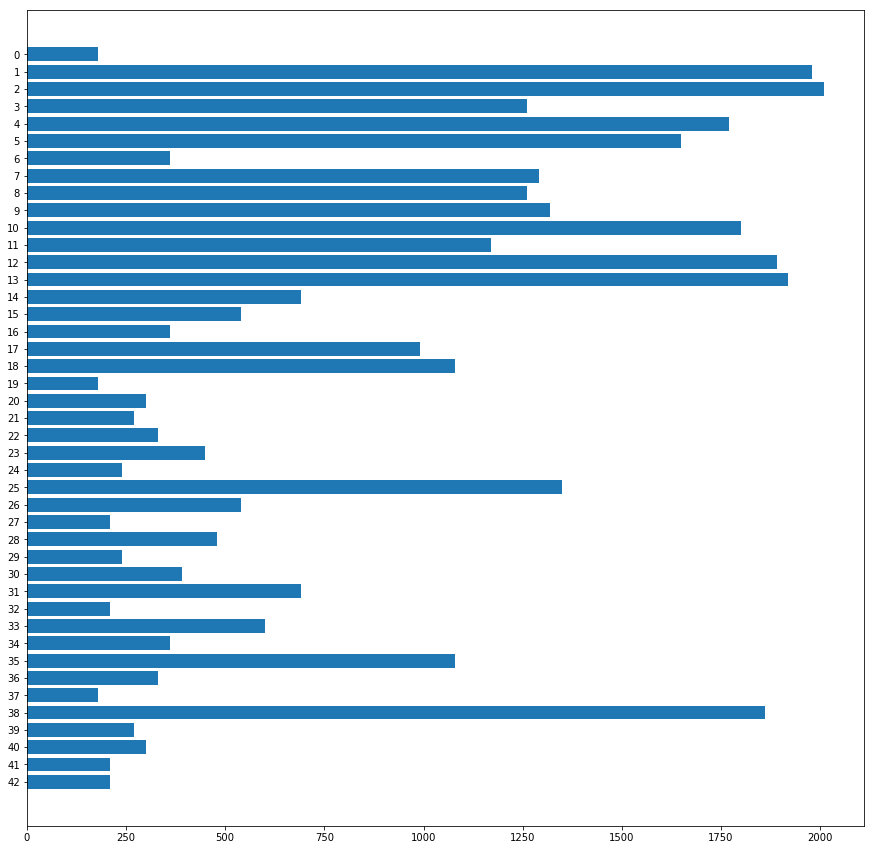

 0 - Speed limit (20km/h)
    Count = 180


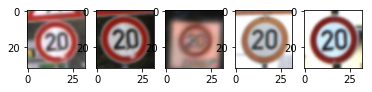

 1 - Speed limit (30km/h)
    Count = 1980


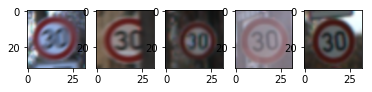

 2 - Speed limit (50km/h)
    Count = 2010


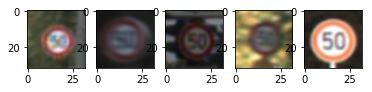

 3 - Speed limit (60km/h)
    Count = 1260


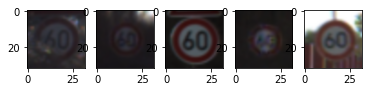

 4 - Speed limit (70km/h)
    Count = 1770


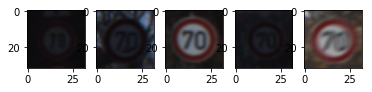

 5 - Speed limit (80km/h)
    Count = 1650


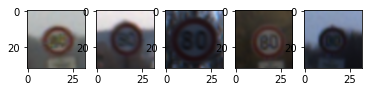

 6 - End of speed limit (80km/h)
    Count = 360


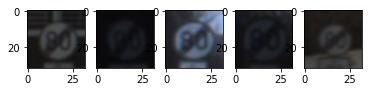

 7 - Speed limit (100km/h)
    Count = 1290


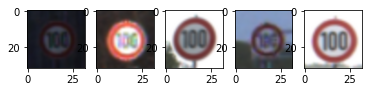

 8 - Speed limit (120km/h)
    Count = 1260


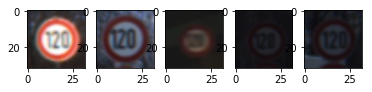

 9 - No passing
    Count = 1320


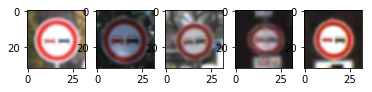

10 - No passing for vehicles over 3.5 metric tons
    Count = 1800


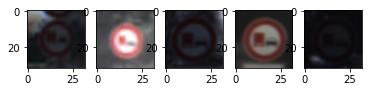

11 - Right-of-way at the next intersection
    Count = 1170


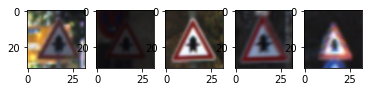

12 - Priority road
    Count = 1890


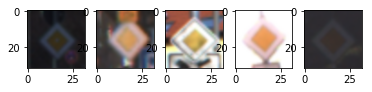

13 - Yield
    Count = 1920


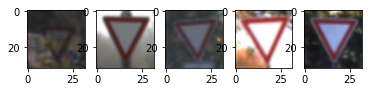

14 - Stop
    Count = 690


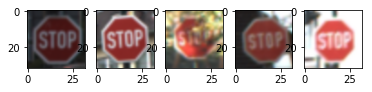

15 - No vehicles
    Count = 540


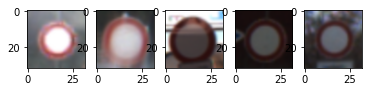

16 - Vehicles over 3.5 metric tons prohibited
    Count = 360


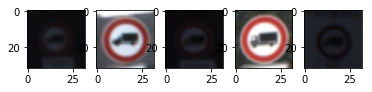

17 - No entry
    Count = 990


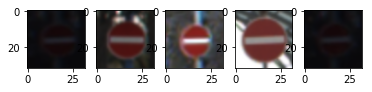

18 - General caution
    Count = 1080


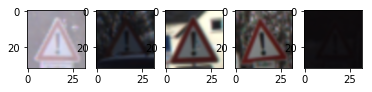

19 - Dangerous curve to the left
    Count = 180


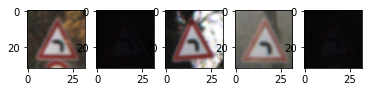

20 - Dangerous curve to the right
    Count = 300


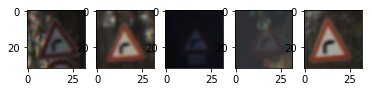

21 - Double curve
    Count = 270


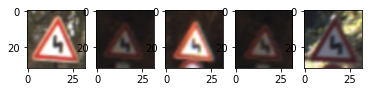

22 - Bumpy road
    Count = 330


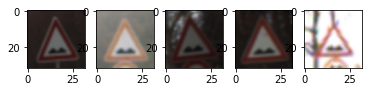

23 - Slippery road
    Count = 450


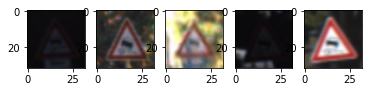

24 - Road narrows on the right
    Count = 240


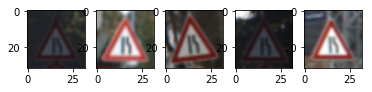

25 - Road work
    Count = 1350


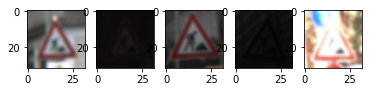

26 - Traffic signals
    Count = 540


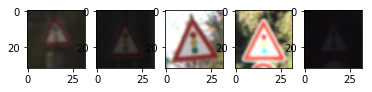

27 - Pedestrians
    Count = 210


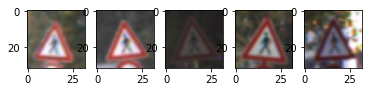

28 - Children crossing
    Count = 480


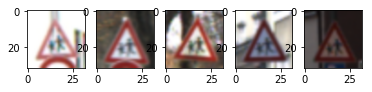

29 - Bicycles crossing
    Count = 240


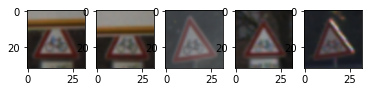

30 - Beware of ice/snow
    Count = 390


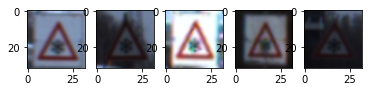

31 - Wild animals crossing
    Count = 690


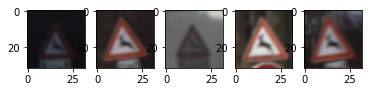

32 - End of all speed and passing limits
    Count = 210


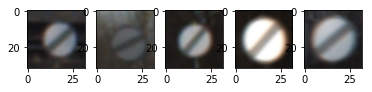

33 - Turn right ahead
    Count = 599


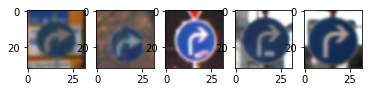

34 - Turn left ahead
    Count = 360


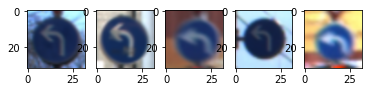

35 - Ahead only
    Count = 1080


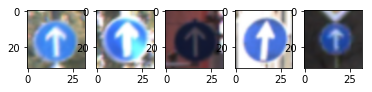

36 - Go straight or right
    Count = 330


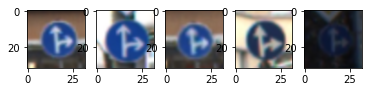

37 - Go straight or left
    Count = 180


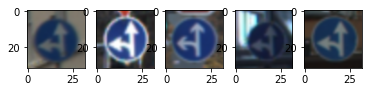

38 - Keep right
    Count = 1860


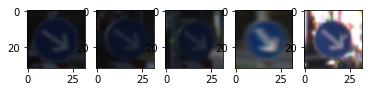

39 - Keep left
    Count = 270


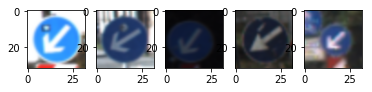

40 - Roundabout mandatory
    Count = 300


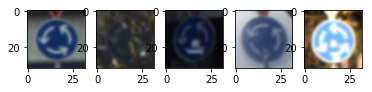

41 - End of no passing
    Count = 210


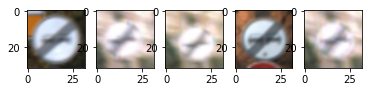

42 - End of no passing by vehicles over 3.5 metric tons
    Count = 210


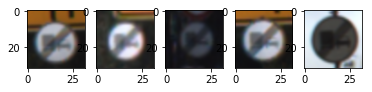

In [5]:
print_dataset_statistic(data_train, desc = 'Trainig data:')

Validation data:


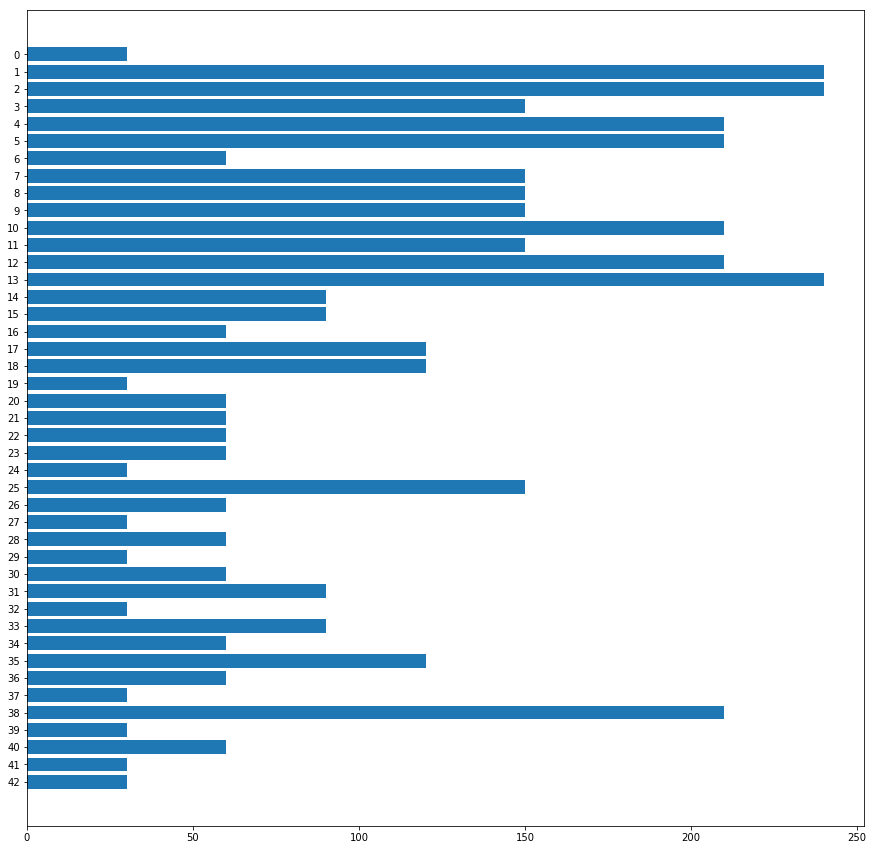

 0 - Speed limit (20km/h)
    Count = 30


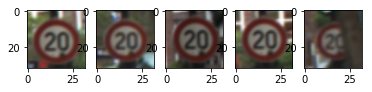

 1 - Speed limit (30km/h)
    Count = 240


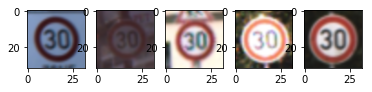

 2 - Speed limit (50km/h)
    Count = 240


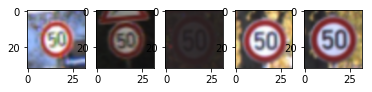

 3 - Speed limit (60km/h)
    Count = 150


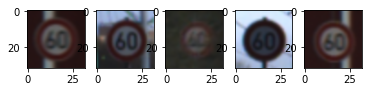

 4 - Speed limit (70km/h)
    Count = 210


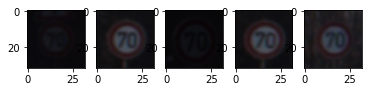

 5 - Speed limit (80km/h)
    Count = 210


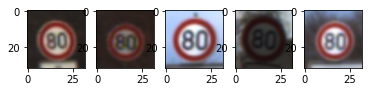

 6 - End of speed limit (80km/h)
    Count = 60


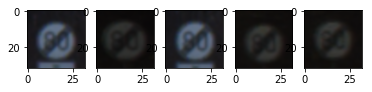

 7 - Speed limit (100km/h)
    Count = 150


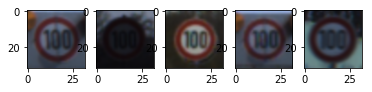

 8 - Speed limit (120km/h)
    Count = 150


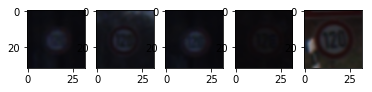

 9 - No passing
    Count = 150


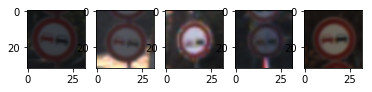

10 - No passing for vehicles over 3.5 metric tons
    Count = 210


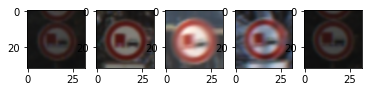

11 - Right-of-way at the next intersection
    Count = 150


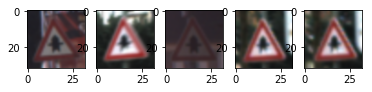

12 - Priority road
    Count = 210


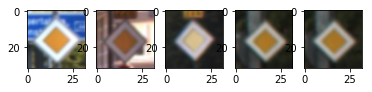

13 - Yield
    Count = 240


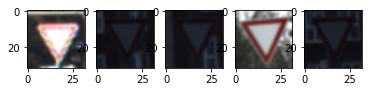

14 - Stop
    Count = 90


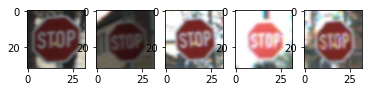

15 - No vehicles
    Count = 90


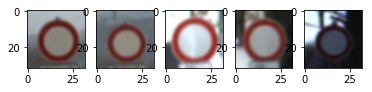

16 - Vehicles over 3.5 metric tons prohibited
    Count = 60


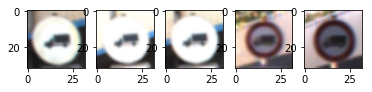

17 - No entry
    Count = 120


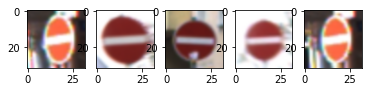

18 - General caution
    Count = 120


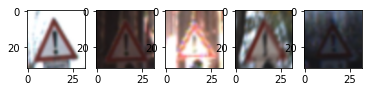

19 - Dangerous curve to the left
    Count = 30


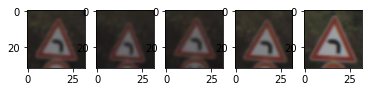

20 - Dangerous curve to the right
    Count = 60


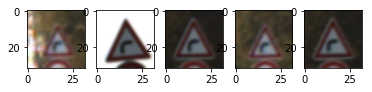

21 - Double curve
    Count = 60


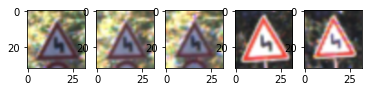

22 - Bumpy road
    Count = 60


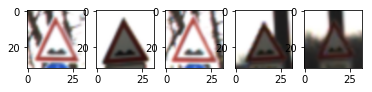

23 - Slippery road
    Count = 60


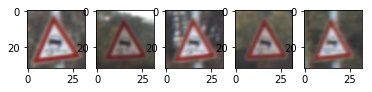

24 - Road narrows on the right
    Count = 30


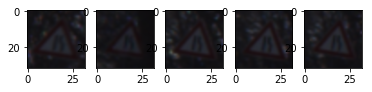

25 - Road work
    Count = 150


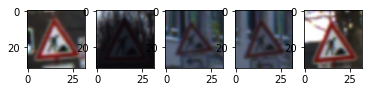

26 - Traffic signals
    Count = 60


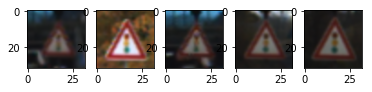

27 - Pedestrians
    Count = 30


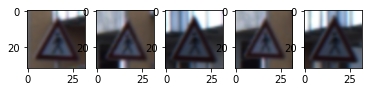

28 - Children crossing
    Count = 60


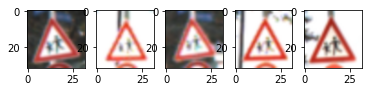

29 - Bicycles crossing
    Count = 30


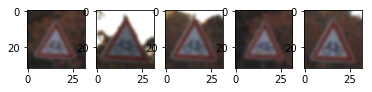

30 - Beware of ice/snow
    Count = 60


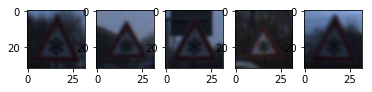

31 - Wild animals crossing
    Count = 90


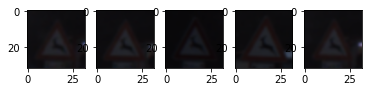

32 - End of all speed and passing limits
    Count = 30


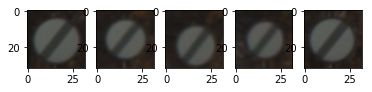

33 - Turn right ahead
    Count = 90


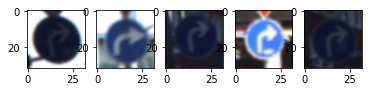

34 - Turn left ahead
    Count = 60


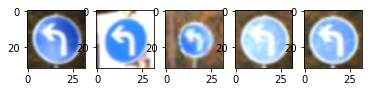

35 - Ahead only
    Count = 120


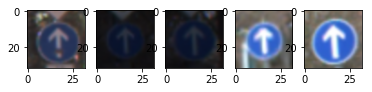

36 - Go straight or right
    Count = 60


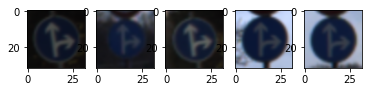

37 - Go straight or left
    Count = 30


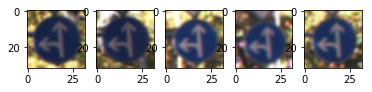

38 - Keep right
    Count = 210


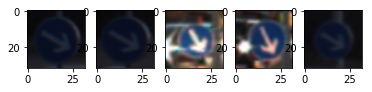

39 - Keep left
    Count = 30


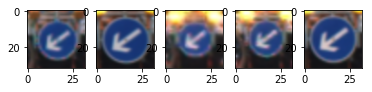

40 - Roundabout mandatory
    Count = 60


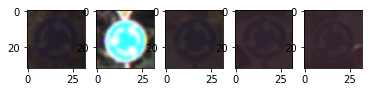

41 - End of no passing
    Count = 30


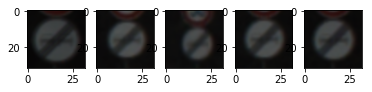

42 - End of no passing by vehicles over 3.5 metric tons
    Count = 30


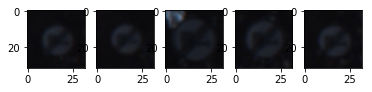

In [6]:
print_dataset_statistic(data_valid, desc = 'Validation data:')

Test data:


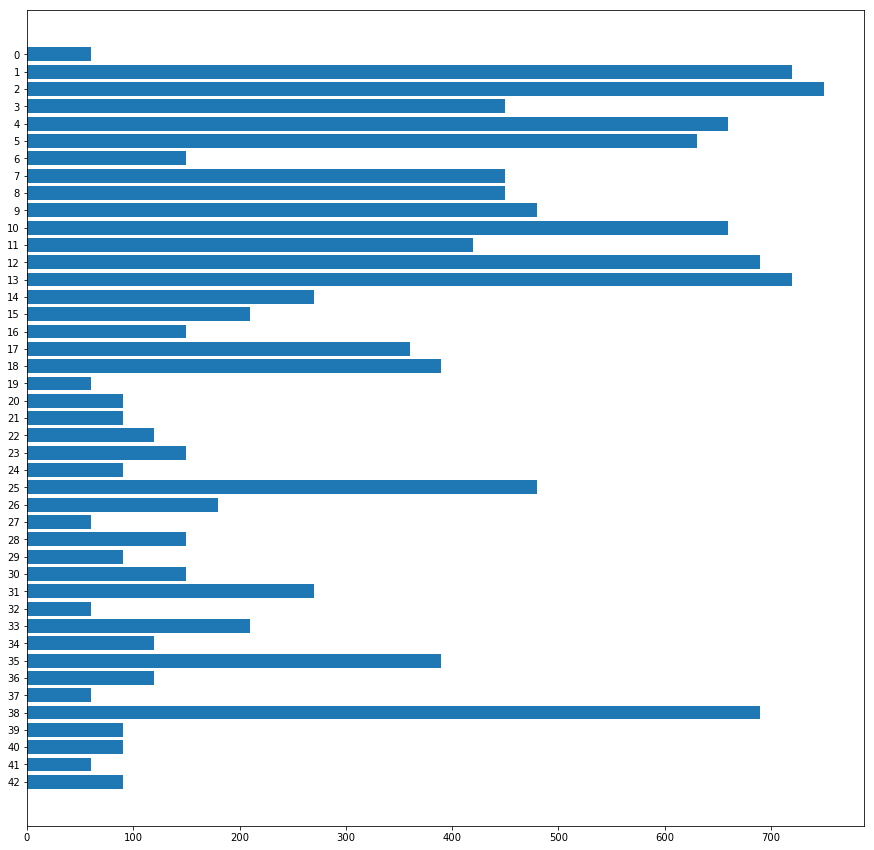

 0 - Speed limit (20km/h)
    Count = 60


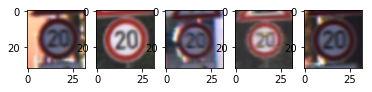

 1 - Speed limit (30km/h)
    Count = 720


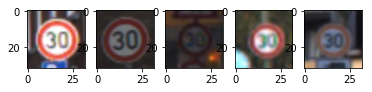

 2 - Speed limit (50km/h)
    Count = 750


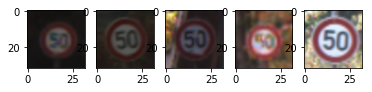

 3 - Speed limit (60km/h)
    Count = 450


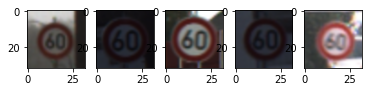

 4 - Speed limit (70km/h)
    Count = 660


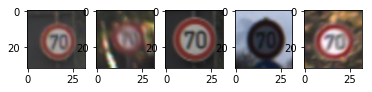

 5 - Speed limit (80km/h)
    Count = 630


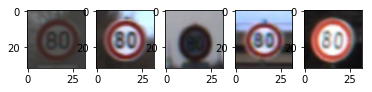

 6 - End of speed limit (80km/h)
    Count = 150


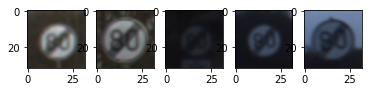

 7 - Speed limit (100km/h)
    Count = 450


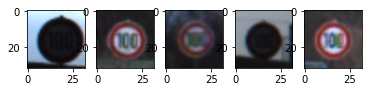

 8 - Speed limit (120km/h)
    Count = 450


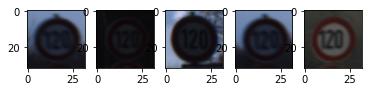

 9 - No passing
    Count = 480


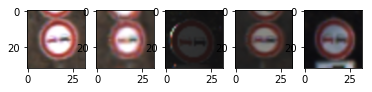

10 - No passing for vehicles over 3.5 metric tons
    Count = 660


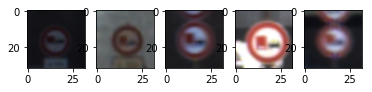

11 - Right-of-way at the next intersection
    Count = 420


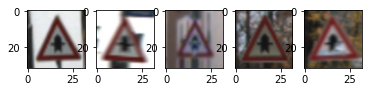

12 - Priority road
    Count = 690


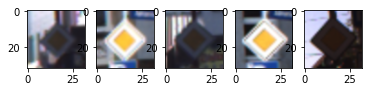

13 - Yield
    Count = 720


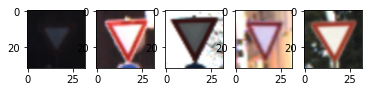

14 - Stop
    Count = 270


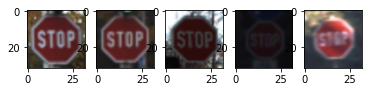

15 - No vehicles
    Count = 210


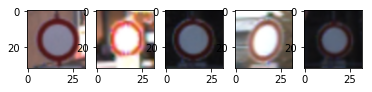

16 - Vehicles over 3.5 metric tons prohibited
    Count = 150


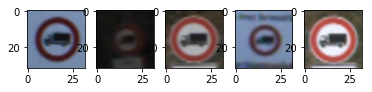

17 - No entry
    Count = 360


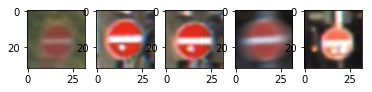

18 - General caution
    Count = 390


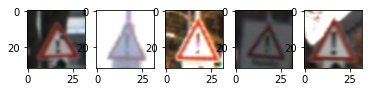

19 - Dangerous curve to the left
    Count = 60


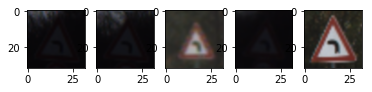

20 - Dangerous curve to the right
    Count = 90


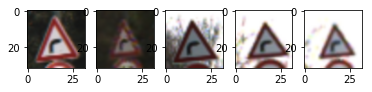

21 - Double curve
    Count = 90


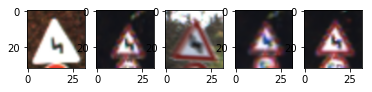

22 - Bumpy road
    Count = 120


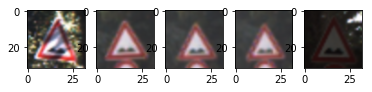

23 - Slippery road
    Count = 150


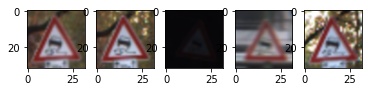

24 - Road narrows on the right
    Count = 90


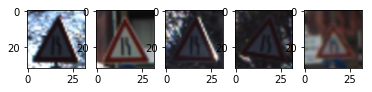

25 - Road work
    Count = 480


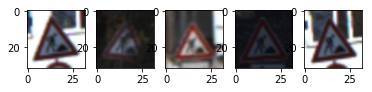

26 - Traffic signals
    Count = 180


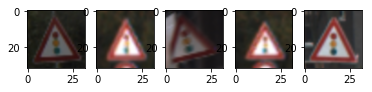

27 - Pedestrians
    Count = 60


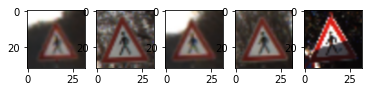

28 - Children crossing
    Count = 150


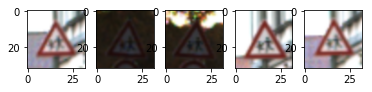

29 - Bicycles crossing
    Count = 90


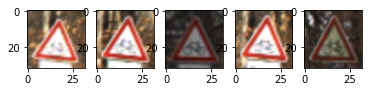

30 - Beware of ice/snow
    Count = 150


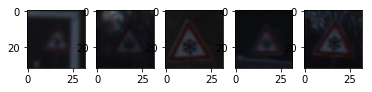

31 - Wild animals crossing
    Count = 270


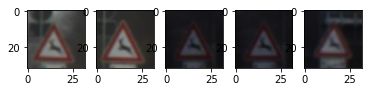

32 - End of all speed and passing limits
    Count = 60


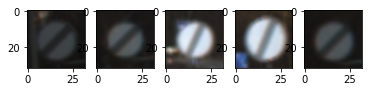

33 - Turn right ahead
    Count = 210


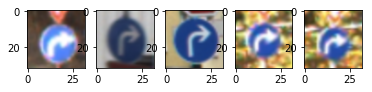

34 - Turn left ahead
    Count = 120


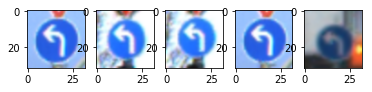

35 - Ahead only
    Count = 390


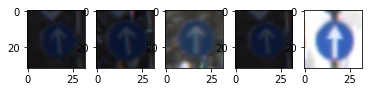

36 - Go straight or right
    Count = 120


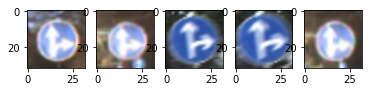

37 - Go straight or left
    Count = 60


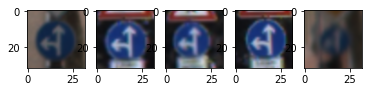

38 - Keep right
    Count = 690


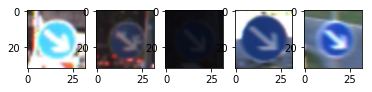

39 - Keep left
    Count = 90


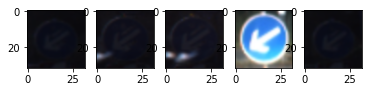

40 - Roundabout mandatory
    Count = 90


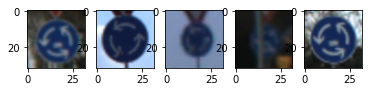

41 - End of no passing
    Count = 60


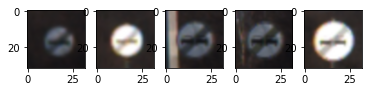

42 - End of no passing by vehicles over 3.5 metric tons
    Count = 90


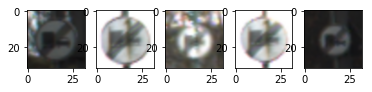

In [7]:
print_dataset_statistic(data_test, desc = 'Test data:')

----

## Step 2: Design and Test a Model Architecture

Design and implement a deep learning model that learns to recognize traffic signs. Train and test your model on the [German Traffic Sign Dataset](http://benchmark.ini.rub.de/?section=gtsrb&subsection=dataset).

The LeNet-5 implementation shown in the [classroom](https://classroom.udacity.com/nanodegrees/nd013/parts/fbf77062-5703-404e-b60c-95b78b2f3f9e/modules/6df7ae49-c61c-4bb2-a23e-6527e69209ec/lessons/601ae704-1035-4287-8b11-e2c2716217ad/concepts/d4aca031-508f-4e0b-b493-e7b706120f81) at the end of the CNN lesson is a solid starting point. You'll have to change the number of classes and possibly the preprocessing, but aside from that it's plug and play! 

With the LeNet-5 solution from the lecture, you should expect a validation set accuracy of about 0.89. To meet specifications, the validation set accuracy will need to be at least 0.93. It is possible to get an even higher accuracy, but 0.93 is the minimum for a successful project submission. 

There are various aspects to consider when thinking about this problem:

- Neural network architecture (is the network over or underfitting?)
- Play around preprocessing techniques (normalization, rgb to grayscale, etc)
- Number of examples per label (some have more than others).
- Generate fake data.

Here is an example of a [published baseline model on this problem](http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf). It's not required to be familiar with the approach used in the paper but, it's good practice to try to read papers like these.

### Pre-process the Data Set (normalization, grayscale, etc.)

Minimally, the image data should be normalized so that the data has mean zero and equal variance. For image data, `(pixel - 128)/ 128` is a quick way to approximately normalize the data and can be used in this project. 

Other pre-processing steps are optional. You can try different techniques to see if it improves performance. 

Use the code cell (or multiple code cells, if necessary) to implement the first step of your project.

In [8]:
data_train.initStorage(override = False, class_samples = 2500)
data_valid.initStorage(override = False)
data_test.initStorage(override = False)

print('Base data set was pre-processed and augmented storage was created.')

Base data set was pre-processed and augmented storage was created.


### Model Architecture

In [9]:
import numpy as np
import tensorflow as tf

class DeepModelEngine:
    def __init__(
        self,
        data_shape,
        class_num,
        model_depth = 1,
        storage_dir = './deep_model',
        storage_file_name = 'deep_model',
        normal_mean = 0.0,
        normal_sigma = 0.1):
        
        self.data_shape = data_shape
        self.class_num = class_num
        self.model_depth = model_depth
        self.storage_dir = storage_dir
        self.storage_file_name = storage_file_name
        self.normal_mean = normal_mean
        self.normal_sigma = normal_sigma

        self._init_model_process_graph()

    def _get_model_structure(self):
        raise NotImplementedError

    def _init_model_process_graph(self):
        self.graph = tf.Graph()
        with self.graph.as_default():
            self.data_x = tf.placeholder(tf.float32, (None, self.data_shape[0], self.data_shape[1], self.data_shape[2]), name = 'data_x')
            self.data_y = tf.placeholder(tf.int32, (None), name = 'data_y')
            self.tf_keep_prob = tf.placeholder(dtype=tf.float32, shape=(), name = 'tf_keep_prob')
            self.tf_decay_learn_rate = tf.placeholder(dtype=tf.float32, shape=(), name = 'tf_decay_learn_rate')
            self.tf_reg_factor = tf.placeholder(dtype=tf.float32, shape=(), name = 'tf_reg_factor')
            self.one_hot_y = tf.one_hot(self.data_y, self.class_num, name = 'one_hot_y')

            self.logits, self.model_weights_reg, self.model_weights_noreg, self.model_conv_layers = self._get_model_structure()
            self.soft_max = tf.nn.softmax(logits = self.logits, name = 'soft_max')
            self.cross_entropy = tf.nn.softmax_cross_entropy_with_logits(labels = self.one_hot_y, logits = self.logits, name = 'cross_entropy')
            self.loss_operation = tf.reduce_mean(self.cross_entropy, name = 'loss_operation')

            reg_idx = 0
            for l_weight in self.model_weights_reg:
                self.loss_operation = tf.add(self.loss_operation, tf.scalar_mul(self.tf_reg_factor, tf.nn.l2_loss(l_weight)), name = 'loss_operation_reg_{}'.format(reg_idx))

                reg_idx += 1
            
            self.optimizer = tf.train.AdamOptimizer(learning_rate = self.tf_decay_learn_rate, name = 'adam_optimizer')
            self.training_operation = self.optimizer.minimize(self.loss_operation, name = 'training_operation')

            self.logits_prediction = tf.argmax(self.logits, 1, name = 'logits_prediction')
            self.correct_value = tf.argmax(self.one_hot_y, 1, name = 'correct_value')
            self.correct_prediction = tf.equal(self.logits_prediction, self.correct_value, name = 'correct_prediction')
            self.accuracy_operation = tf.reduce_mean(tf.cast(self.correct_prediction, tf.float32), name = 'accuracy_operation')

    def _model_evaluate(self, data_valid, session):
        num_examples = 0
        total_accuracy = 0

        data_valid.initRead()
        while data_valid.canReadMore():
            x_data, y_data = data_valid.readNext()
            accuracy = session.run(self.accuracy_operation, feed_dict={self.data_x: x_data, self.data_y: y_data, self.tf_keep_prob : 1.0})
                    
            num_examples += len(x_data)
            total_accuracy += accuracy * len(x_data)
                    
        if num_examples <= 0:
            total_accuracy = 0
            num_examples = 1

        return float(total_accuracy) / float(num_examples)

    def _save_model(self, session):
        saver = tf.train.Saver()
        saver.save(session, self.storage_dir + '/' + self.storage_file_name)

    def _load_model(self, session):
        saver = tf.train.Saver()
        saver.restore(session, tf.train.latest_checkpoint(self.storage_dir))

    def train_model(
        self,
        data_train, data_valid,
        learn_rate_from = 0.003, learn_rate_to = 0.0005,
        keep_prob_from = 0.5, keep_prob_to = 0.5,
        reg_factor = 0.0001,
        epochs = 75,
        train_rounds = 3,
        continue_training = False,
        verbose = True):

        reg_factor_val = reg_factor * (1.0 / (self.model_depth ** 2))

        load_saved_model = continue_training

        for train_rnd_num in range(train_rounds):
            with self.graph.as_default():
                with tf.Session() as session:
                    if load_saved_model:
                        self._load_model(session)
                        best_accuracy = self._model_evaluate(data_valid, session)
                    else:
                        session.run(tf.global_variables_initializer())
                        best_accuracy = 0

                    if verbose:
                        print("Training ...")
                        print()

                    for i in range(epochs):
                        decay_learn_rate = learn_rate_from * ((learn_rate_to / learn_rate_from) ** (i / epochs))
                        decay_keep_prob = keep_prob_from * ((keep_prob_to / keep_prob_from) ** (i / epochs))

                        if verbose:
                            print("ROUND {}:".format(train_rnd_num + 1))
                            print("EPOCH {}:".format(i + 1))
                            print("Learn rate = {}:".format(decay_learn_rate))
                            print("Keep prob = {}:".format(decay_keep_prob))

                        data_train.initRead()
                        while data_train.canReadMore():
                            x_data, y_data = data_train.readNext()

                            session.run(
                                self.training_operation,
                                feed_dict = {
                                    self.data_x: x_data,
                                    self.data_y: y_data,
                                    self.tf_keep_prob: decay_keep_prob,
                                    self.tf_decay_learn_rate: decay_learn_rate,
                                    self.tf_reg_factor: reg_factor_val})
            
                        validation_accuracy = self._model_evaluate(data_valid, session)
                    
                        if verbose:
                            print("    Validation Accuracy = {:.2f}%".format(validation_accuracy * 100))

                        if validation_accuracy > best_accuracy:
                            best_accuracy = validation_accuracy
                            self._save_model(session)

                            if verbose:
                                print("    Accuracy is improved. Model is saved.")

                        if verbose:
                            print()
            
            load_saved_model = True

        if verbose:
            print("Best accuracy = {:.2f}%".format(best_accuracy * 100))
            print()

        return best_accuracy

    def validate_model(self, data_valid, verbose = False):
        with self.graph.as_default():
            with tf.Session() as session:
                self._load_model(session)

                validation_accuracy = self._model_evaluate(data_valid, session)

                if verbose:
                    print("Accuracy = {:.2f}%".format(validation_accuracy * 100))
                    print()

        return validation_accuracy

    def model_precision_recall(self, data_valid):
        precision_recall_dict = {idx : (0, 0, 0) for idx in range(self.class_num)}
        
        with self.graph.as_default():
            with tf.Session() as session:
                self._load_model(session)

                data_valid.initRead()
                while data_valid.canReadMore():
                    x_data, y_data = data_valid.readNext()

                    logits_prediction_val = session.run(self.logits_prediction, feed_dict={self.data_x: x_data, self.tf_keep_prob : 1.0})

                    data_cnt = len(x_data)
                    for i in range(data_cnt):
                        pos, neg, rel = precision_recall_dict[y_data[i]]
                        rel += 1

                        if y_data[i] == logits_prediction_val[i]:
                            pos += 1
                        else:
                            pos_n, neg_n, rel_n = precision_recall_dict[logits_prediction_val[i]]
                            neg_n += 1

                            precision_recall_dict[logits_prediction_val[i]] = (pos_n, neg_n, rel_n)

                        precision_recall_dict[y_data[i]] = (pos, neg, rel)

        precision_recall_dict_ext = {}
        for idx in range(self.class_num):
            pos, neg, rel = precision_recall_dict[idx]
            if (pos + neg) > 0:
                prec = float(pos) / float(pos + neg)
            else:
                prec = 0.0

            if rel > 0:
                rec = float(pos) / float(rel)
            else:
                rec = 0.0

            precision_recall_dict_ext[idx] = (pos, neg, rel, prec, rec)

        return precision_recall_dict_ext

    def get_batch_prediction(self, data_valid, init_read = True):
        prediction_data = []
        
        with self.graph.as_default():
            with tf.Session() as session:
                self._load_model(session)

                if init_read:
                    data_valid.initRead()

                if data_valid.canReadMore():
                    x_data, y_data = data_valid.readNext()

                    logits_prediction_val = session.run(self.logits_prediction, feed_dict={self.data_x: x_data, self.tf_keep_prob : 1.0})

                    data_cnt = len(x_data)
                    for i in range(data_cnt):
                        prediction_data += [(x_data[i], y_data[i], logits_prediction_val[i])]

        return prediction_data

    def get_batch_softmax(self, data_valid, top_values = 5, init_read = True):
        softmax_top_data = []
        
        with self.graph.as_default():
            with tf.Session() as session:
                self._load_model(session)

                if init_read:
                    data_valid.initRead()

                if data_valid.canReadMore():
                    x_data, y_data = data_valid.readNext()

                    soft_max_top = tf.nn.top_k(self.soft_max, top_values)
                    softmax_top_val = session.run(soft_max_top, feed_dict={self.data_x: x_data, self.tf_keep_prob : 1.0})

                    val, ind = (softmax_top_val.values, softmax_top_val.indices)
                    data_cnt = len(x_data)
                    for i in range(data_cnt):
                        softmax_top_data += [(x_data[i], y_data[i], val[i], ind[i])]

        return softmax_top_data

    def get_batch_conv_activations(self, data_valid, init_read = True):
        activations_data = []
        
        with self.graph.as_default():
            with tf.Session() as session:
                self._load_model(session)

                if init_read:
                    data_valid.initRead()

                if data_valid.canReadMore():
                    x_data, y_data = data_valid.readNext()

                    logits_prediction_val = session.run(self.logits_prediction, feed_dict={self.data_x: x_data, self.tf_keep_prob : 1.0})

                    layer_act = []
                    for l_conv_layer in self.model_conv_layers:
                        layer_act += [session.run(l_conv_layer, feed_dict={self.data_x: x_data, self.tf_keep_prob : 1.0})]

                    data_cnt = len(x_data)
                    for i in range(data_cnt):
                        curLayerAct = []
                        for layer_act_w in layer_act:
                            curLayerAct += [layer_act_w[i]]

                        activations_data += [(x_data[i], y_data[i], logits_prediction_val[i], curLayerAct)]

        return activations_data

print('Base deep model engine is loaded.')

Base deep model engine is loaded.


In [10]:
from tensorflow.contrib.layers import flatten

class DeepModelEngineV3(DeepModelEngine):
    def __init__(
        self,
        data_shape,
        class_num,
        model_depth = 1,
        storage_dir = './deep_model',
        storage_file_name = 'deep_model',
        normal_mean = 0.0,
        normal_sigma = 0.1):

        DeepModelEngine.__init__(
            self,
            data_shape,
            class_num,
            model_depth = model_depth,
            storage_dir = storage_dir + '_v3_d{}'.format(model_depth),
            storage_file_name = storage_file_name,
            normal_mean = normal_mean,
            normal_sigma = normal_sigma)

    def _get_model_structure(self):
        # Layer 1: Convolutional. Input = 32x32ximg_depth. Output = 30x30x16*model_depth.
        self.mdl_conv1_weights = tf.Variable(tf.truncated_normal([3, 3, self.data_shape[2], 16 * self.model_depth], mean = self.normal_mean, stddev = self.normal_sigma, dtype = tf.float32, name = 'conv1_weights_norm'), name = 'conv1_weights')
        self.mdl_conv1_biases = tf.Variable(tf.zeros(16 * self.model_depth, dtype = tf.float32, name = 'conv1_biases_zoros'), name = 'conv1_biases')
        self.mdl_conv1 = tf.nn.bias_add(tf.nn.conv2d(self.data_x, self.mdl_conv1_weights, [1, 1, 1, 1], padding = "VALID", name = 'conv1_conv2d'), self.mdl_conv1_biases, name = 'conv1_conv2d_bias')
    
        # Activation.
        self.mdl_l1_act = tf.nn.relu(self.mdl_conv1, name = 'l1_act_relu')
    
        # Pooling. Input = 30x30x16 * model_depth. Output = 15x15x16 * model_depth.
        self.mdl_l1_pool = tf.nn.avg_pool(self.mdl_l1_act, [1, 2, 2, 1], [1, 2, 2, 1], padding = "VALID", name = 'l1_pool')

        # Layer 2: Convolutional. Output = 12x12x24 * model_depth.
        self.mdl_conv2_weights = tf.Variable(tf.truncated_normal([4, 4, 16 * self.model_depth, 24 * self.model_depth], mean = self.normal_mean, stddev = self.normal_sigma, dtype = tf.float32, name = 'conv2_weights_norm'), name = 'conv2_weights')
        self.mdl_conv2_biases = tf.Variable(tf.zeros(24 * self.model_depth, dtype = tf.float32, name = 'conv2_biases_zero'), name = 'conv2_biases')
        self.mdl_conv2 = tf.nn.bias_add(tf.nn.conv2d(self.mdl_l1_pool, self.mdl_conv2_weights, [1, 1, 1, 1], padding = "VALID", name = 'conv2_conv2d'), self.mdl_conv2_biases, name = 'conv2_conv2d_bias')
    
        # Activation.
        self.mdl_l2_act = tf.nn.relu(self.mdl_conv2, name = 'l2_act_relu')

        # Pooling. Input = 12x12x24 * model_depth. Output = 6x6x24 * model_depth.
        self.mdl_l2_pool = tf.nn.avg_pool(self.mdl_l2_act, [1, 2, 2, 1], [1, 2, 2, 1], padding = "VALID", name = 'l2_pool')

        # Layer 3: Convolutional. Output = 4x4x32 * model_depth.
        self.mdl_conv3_weights = tf.Variable(tf.truncated_normal([3, 3, 24 * self.model_depth, 32 * self.model_depth], mean = self.normal_mean, stddev = self.normal_sigma, dtype = tf.float32, name = 'conv3_weights_norm'), name = 'conv3_weights')
        self.mdl_conv3_biases = tf.Variable(tf.zeros(32 * self.model_depth, dtype = tf.float32, name = 'conv3_biases_zero'), name = 'conv3_biases')
        self.mdl_conv3 = tf.nn.bias_add(tf.nn.conv2d(self.mdl_l2_pool, self.mdl_conv3_weights, [1, 1, 1, 1], padding = "VALID", name = 'conv3_conv2d'), self.mdl_conv3_biases, name = 'conv3_conv2d_bias')
    
        # Activation.
        self.mdl_l3_act = tf.nn.dropout(tf.nn.relu(self.mdl_conv3, name = 'l3_act_relu'), self.tf_keep_prob, name = 'l3_act_relu_dt')

        # Flatten. Input = 4x4x32 * model_depth. Output = 512 * model_depth.
        self.mdl_l3_flat = flatten(self.mdl_l3_act)
    
        # Layer 4: Fully Connected. Input = 512 * model_depth. Output = 150 * model_depth.
        self.mdl_l4_weights = tf.Variable(tf.truncated_normal([512 * self.model_depth, 150 * self.model_depth], mean = self.normal_mean, stddev = self.normal_sigma, dtype = tf.float32, name = 'l4_weights_norm'), name = 'l4_weights')
        self.mdl_l4_biases = tf.Variable(tf.zeros(150 * self.model_depth, dtype = tf.float32, name = 'l4_biases_zero'), name = 'l4_biases')
        self.mdl_l4 = tf.nn.bias_add(tf.matmul(self.mdl_l3_flat, self.mdl_l4_weights, name = 'l4_matmul'), self.mdl_l4_biases, name = 'l4_matmul_bias')
    
        # Activation.
        self.mdl_l4_act = tf.nn.dropout(tf.nn.relu(self.mdl_l4, name = 'l4_act_relu'), self.tf_keep_prob, name = 'l4_act_relu_dt')

        # Layer 5: Fully Connected. Input = 150 * model_depth. Output = 100 * model_depth.
        self.mdl_l5_weights = tf.Variable(tf.truncated_normal([150 * self.model_depth, 100 * self.model_depth], mean = self.normal_mean, stddev = self.normal_sigma, dtype = tf.float32, name = 'l5_weights_norm'), name = 'l5_weights')
        self.mdl_l5_biases = tf.Variable(tf.zeros(100 * self.model_depth, dtype = tf.float32, name = 'l5_biases_zero'), name = 'l5_biases')
        self.mdl_l5 = tf.nn.bias_add(tf.matmul(self.mdl_l4_act, self.mdl_l5_weights, name = 'l5_matmul'), self.mdl_l5_biases, name = 'l5_matmul_bias')
    
        # Activation.
        self.mdl_l5_act = tf.nn.dropout(tf.nn.relu(self.mdl_l5, name = 'l5_act_relu'), self.tf_keep_prob, name = 'l5_act_relu_dt')

        # Layer 6: Fully Connected. Input = 100 * model_depth. Output = class_num.
        self.mdl_l6_weights = tf.Variable(tf.truncated_normal([100 * self.model_depth, self.class_num], mean = self.normal_mean, stddev = self.normal_sigma, dtype = tf.float32, name = 'l6_weights_norm'), name = 'l6_weights')
        self.mdl_l6_biases = tf.Variable(tf.zeros(self.class_num, dtype = tf.float32, name = 'l6_biases_zero'), name = 'l6_biases')
        logits = tf.nn.bias_add(tf.matmul(self.mdl_l5_act, self.mdl_l6_weights, name = 'l6_matmul'), self.mdl_l6_biases, name = 'l6_matmul_bias')

        model_weights_reg = [self.mdl_l4_weights, self.mdl_l5_weights, self.mdl_l6_weights]
        model_weights_noreg = [self.mdl_conv1_weights, self.mdl_conv2_weights, self.mdl_conv3_weights]
        model_conv_layers = [self.mdl_conv1, self.mdl_conv2, self.mdl_conv3]
    
        return logits, model_weights_reg, model_weights_noreg, model_conv_layers


print('Model engine implementation V3 is loaded.')

Model engine implementation V3 is loaded.


### Train, Validate and Test the Model

A validation set can be used to assess how well the model is performing. A low accuracy on the training and validation
sets imply underfitting. A high accuracy on the training set but low accuracy on the validation set implies overfitting.

In [11]:
# Prepare base constants
data_shape = data_train.getDataShape()
class_num = data_train.getClassesNum()

#These lines can be uncommented to remove raw data not used in model processing.
#data_train.clearData()
#data_valid.clearData()
#data_test.clearData()

model = DeepModelEngineV3(
    data_shape = data_shape,
    class_num = class_num,
    model_depth = 2)

print("Model is prepared.")

Model is prepared.


In [12]:
model.train_model(
    data_train, data_valid,
    learn_rate_from = 0.003, learn_rate_to = 0.0005,
    keep_prob_from = 0.5, keep_prob_to = 0.5,
    reg_factor = 0.0001,
    epochs = 75,
    train_rounds = 3,
    continue_training = False,
    verbose = True)

print("Model is trained.")

Training ...

ROUND 1:
EPOCH 1:
Learn rate = 0.003:
Keep prob = 0.5:
    Validation Accuracy = 93.17%
    Accuracy is improved. Model is saved.

ROUND 1:
EPOCH 2:
Learn rate = 0.0029291789514506467:
Keep prob = 0.5:
    Validation Accuracy = 97.32%
    Accuracy is improved. Model is saved.

ROUND 1:
EPOCH 3:
Learn rate = 0.0028600297765405034:
Keep prob = 0.5:
    Validation Accuracy = 96.92%

ROUND 1:
EPOCH 4:
Learn rate = 0.0027925130073215127:
Keep prob = 0.5:
    Validation Accuracy = 97.39%
    Accuracy is improved. Model is saved.

ROUND 1:
EPOCH 5:
Learn rate = 0.002726590107566107:
Keep prob = 0.5:
    Validation Accuracy = 97.41%
    Accuracy is improved. Model is saved.

ROUND 1:
EPOCH 6:
Learn rate = 0.002662223450772065:
Keep prob = 0.5:
    Validation Accuracy = 97.64%
    Accuracy is improved. Model is saved.

ROUND 1:
EPOCH 7:
Learn rate = 0.0025993762986866132:
Keep prob = 0.5:
    Validation Accuracy = 97.96%
    Accuracy is improved. Model is saved.

ROUND 1:
EPOCH 8:

    Validation Accuracy = 98.82%

ROUND 1:
EPOCH 73:
Learn rate = 0.0005371505866104276:
Keep prob = 0.5:
    Validation Accuracy = 98.98%

ROUND 1:
EPOCH 74:
Learn rate = 0.000524470064019544:
Keep prob = 0.5:
    Validation Accuracy = 98.82%

ROUND 1:
EPOCH 75:
Learn rate = 0.0005120888907306737:
Keep prob = 0.5:
    Validation Accuracy = 98.96%

INFO:tensorflow:Restoring parameters from ./deep_model_v3_d2\deep_model
Training ...

ROUND 2:
EPOCH 1:
Learn rate = 0.003:
Keep prob = 0.5:
    Validation Accuracy = 98.03%

ROUND 2:
EPOCH 2:
Learn rate = 0.0029291789514506467:
Keep prob = 0.5:
    Validation Accuracy = 98.55%

ROUND 2:
EPOCH 3:
Learn rate = 0.0028600297765405034:
Keep prob = 0.5:
    Validation Accuracy = 99.00%

ROUND 2:
EPOCH 4:
Learn rate = 0.0027925130073215127:
Keep prob = 0.5:
    Validation Accuracy = 98.19%

ROUND 2:
EPOCH 5:
Learn rate = 0.002726590107566107:
Keep prob = 0.5:
    Validation Accuracy = 98.68%

ROUND 2:
EPOCH 6:
Learn rate = 0.002662223450772065:
Ke

    Validation Accuracy = 98.87%

ROUND 2:
EPOCH 75:
Learn rate = 0.0005120888907306737:
Keep prob = 0.5:
    Validation Accuracy = 99.09%

INFO:tensorflow:Restoring parameters from ./deep_model_v3_d2\deep_model
Training ...

ROUND 3:
EPOCH 1:
Learn rate = 0.003:
Keep prob = 0.5:
    Validation Accuracy = 99.02%

ROUND 3:
EPOCH 2:
Learn rate = 0.0029291789514506467:
Keep prob = 0.5:
    Validation Accuracy = 98.46%

ROUND 3:
EPOCH 3:
Learn rate = 0.0028600297765405034:
Keep prob = 0.5:
    Validation Accuracy = 98.57%

ROUND 3:
EPOCH 4:
Learn rate = 0.0027925130073215127:
Keep prob = 0.5:
    Validation Accuracy = 98.28%

ROUND 3:
EPOCH 5:
Learn rate = 0.002726590107566107:
Keep prob = 0.5:
    Validation Accuracy = 98.32%

ROUND 3:
EPOCH 6:
Learn rate = 0.002662223450772065:
Keep prob = 0.5:
    Validation Accuracy = 98.59%

ROUND 3:
EPOCH 7:
Learn rate = 0.0025993762986866132:
Keep prob = 0.5:
    Validation Accuracy = 98.46%

ROUND 3:
EPOCH 8:
Learn rate = 0.0025380127803375056:
Kee

In [13]:
def print_precision_recall(data_set, precision_recall_dict, desc = 'Precision and recall:'):
    print(desc)

    prec_arr = np.zeros(shape = (data_set.getClassesNum()), dtype = float)
    rec_arr = np.zeros(shape = (data_set.getClassesNum()), dtype = float)
    for idx in range(data_set.getClassesNum()):
        pos, neg, rel, prec, rec = precision_recall_dict[idx]
        prec_arr[idx] = prec * 100.0
        rec_arr[idx] = rec * 100.0
    
    plt_classes = range(data_set.getClassesNum())

    print("Precision summary:")
    plt.figure(figsize = (15, 15))
    plt.barh(plt_classes, prec_arr[::-1])
    plt.yticks(plt_classes, plt_classes[::-1])
    plt.show()

    print("Recall summary:")
    plt.figure(figsize = (15, 15))
    plt.barh(plt_classes, rec_arr[::-1])
    plt.yticks(plt_classes, plt_classes[::-1])
    plt.show()

    for idx in range(data_set.getClassesNum()):
        pos, neg, rel, prec, rec = precision_recall_dict[idx]
        print("{:>2} - {}".format(idx, data_set.getDescriptions()[idx]))
        print("    Precision = {:.2f}%, Recall = {:.2f}%".format(prec * 100, rec * 100))
        
print("Precision and recall calculation module is loaded.")

Precision and recall calculation module is loaded.


In [14]:
print("Training data accuracy: {:.2f}%".format(model.validate_model(data_train) * 100))

INFO:tensorflow:Restoring parameters from ./deep_model_v3_d2\deep_model
Training data accuracy: 99.99%


INFO:tensorflow:Restoring parameters from ./deep_model_v3_d2\deep_model
Precision and recall:
Precision summary:


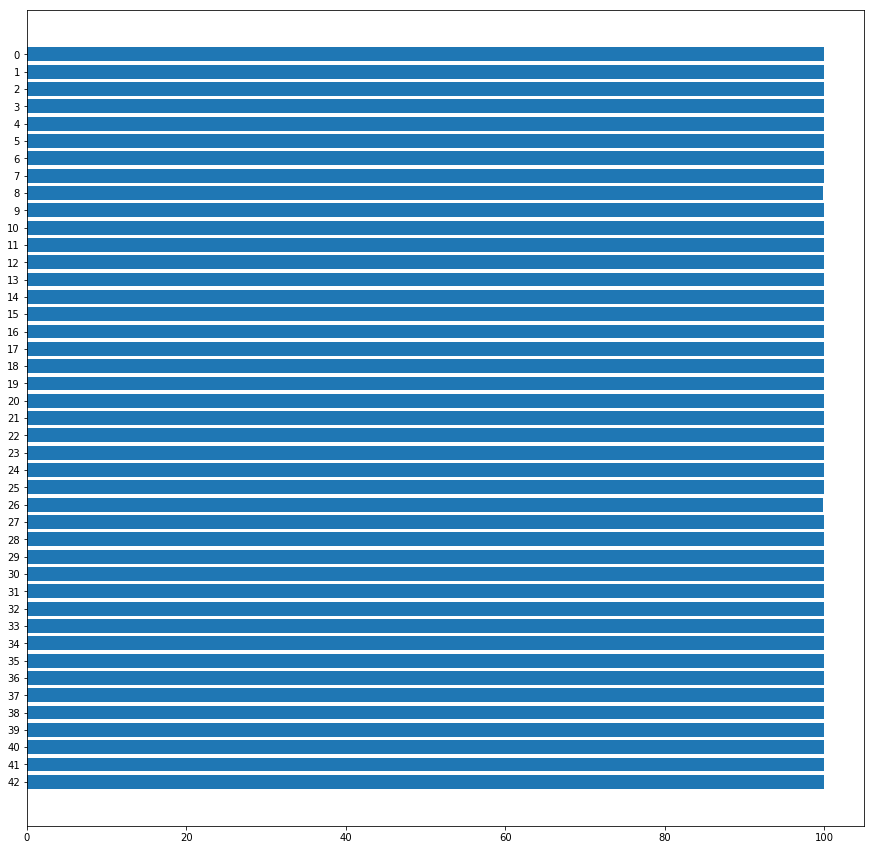

Recall summary:


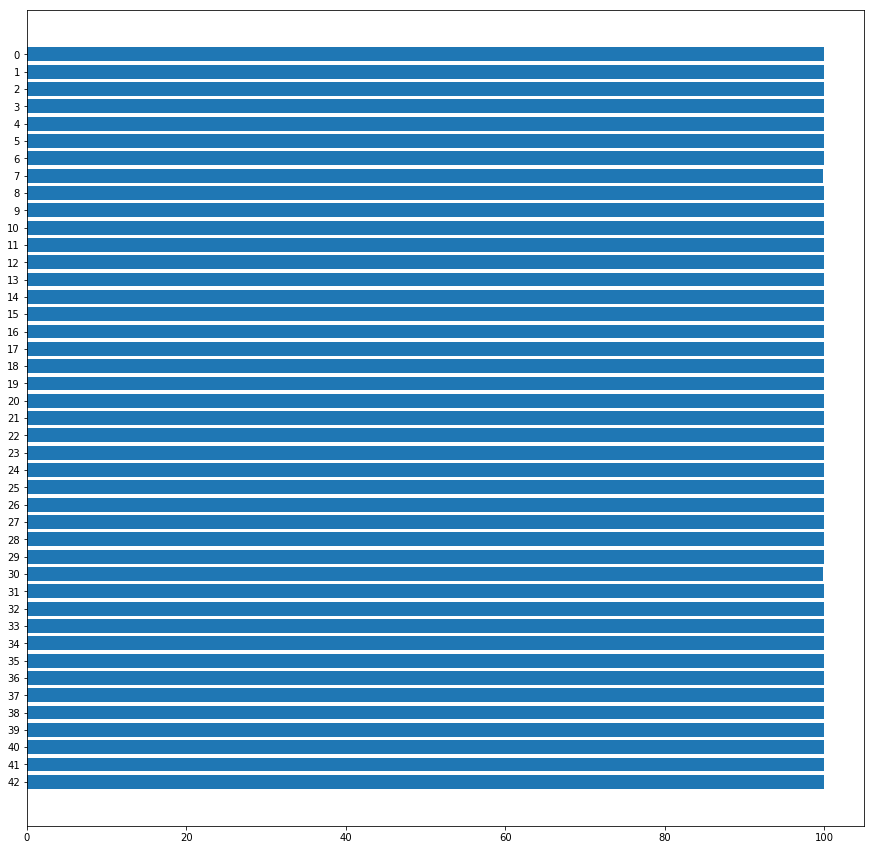

 0 - Speed limit (20km/h)
    Precision = 100.00%, Recall = 100.00%
 1 - Speed limit (30km/h)
    Precision = 99.96%, Recall = 99.96%
 2 - Speed limit (50km/h)
    Precision = 99.96%, Recall = 99.96%
 3 - Speed limit (60km/h)
    Precision = 99.96%, Recall = 99.96%
 4 - Speed limit (70km/h)
    Precision = 99.96%, Recall = 100.00%
 5 - Speed limit (80km/h)
    Precision = 99.96%, Recall = 99.96%
 6 - End of speed limit (80km/h)
    Precision = 100.00%, Recall = 100.00%
 7 - Speed limit (100km/h)
    Precision = 100.00%, Recall = 99.88%
 8 - Speed limit (120km/h)
    Precision = 99.92%, Recall = 99.96%
 9 - No passing
    Precision = 100.00%, Recall = 100.00%
10 - No passing for vehicles over 3.5 metric tons
    Precision = 100.00%, Recall = 100.00%
11 - Right-of-way at the next intersection
    Precision = 99.96%, Recall = 100.00%
12 - Priority road
    Precision = 100.00%, Recall = 100.00%
13 - Yield
    Precision = 100.00%, Recall = 100.00%
14 - Stop
    Precision = 100.00%, Recall =

In [15]:
print_precision_recall(data_train, model.model_precision_recall(data_train))

In [16]:
print("Validation data accuracy: {:.2f}%".format(model.validate_model(data_valid) * 100))

INFO:tensorflow:Restoring parameters from ./deep_model_v3_d2\deep_model
Validation data accuracy: 99.23%


INFO:tensorflow:Restoring parameters from ./deep_model_v3_d2\deep_model
Precision and recall:
Precision summary:


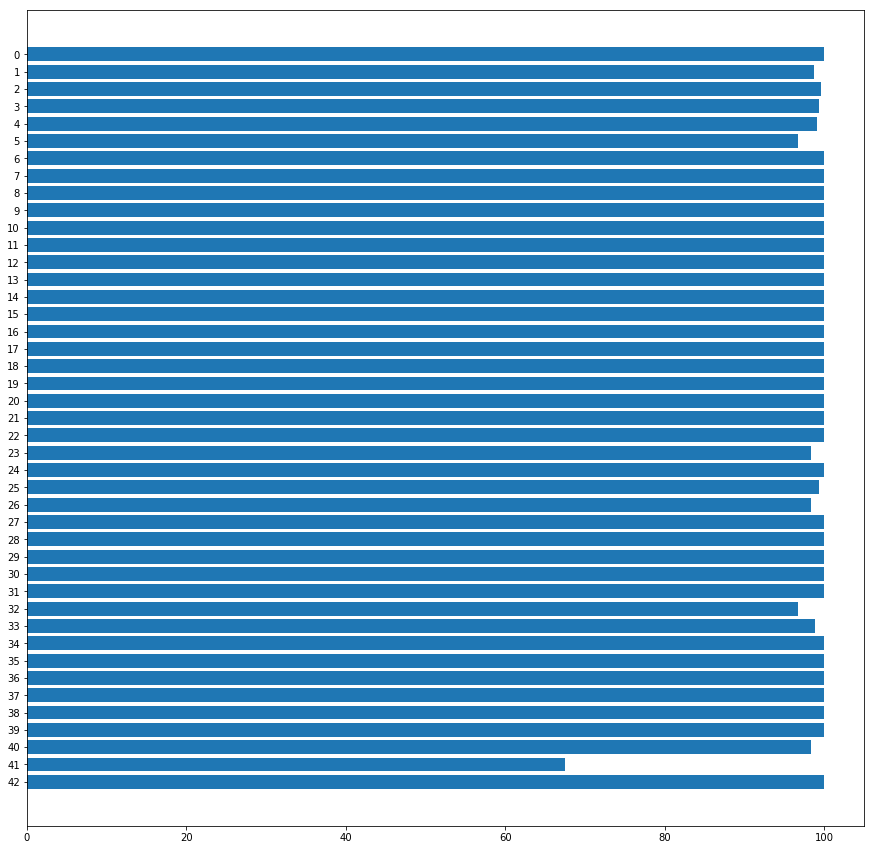

Recall summary:


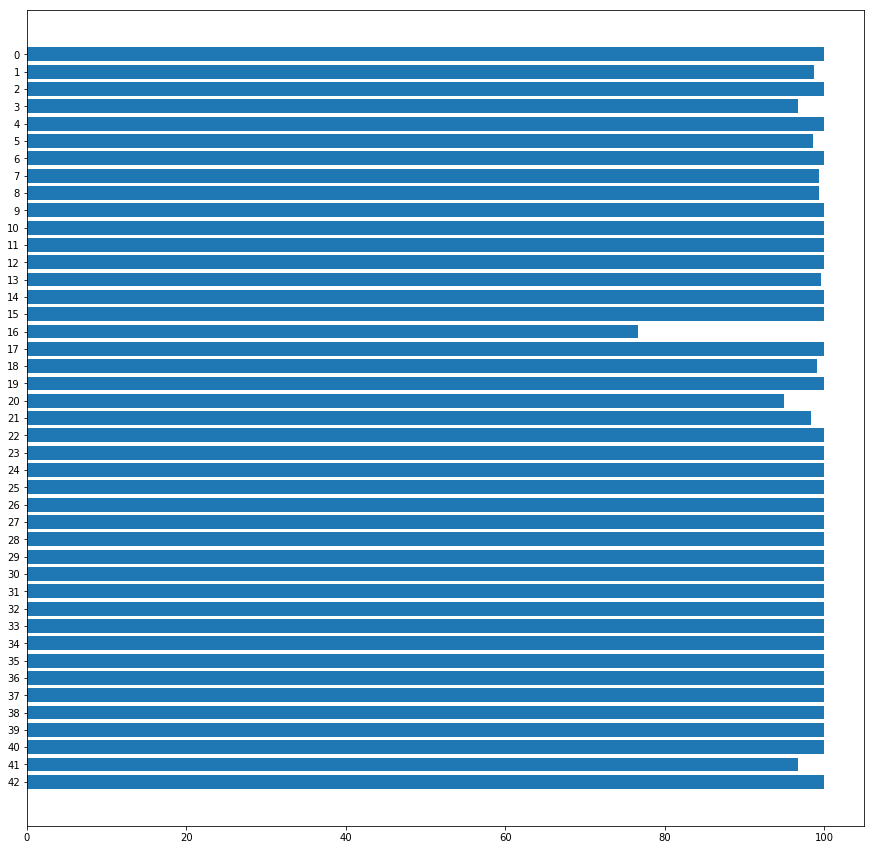

 0 - Speed limit (20km/h)
    Precision = 100.00%, Recall = 100.00%
 1 - Speed limit (30km/h)
    Precision = 98.75%, Recall = 98.75%
 2 - Speed limit (50km/h)
    Precision = 99.59%, Recall = 100.00%
 3 - Speed limit (60km/h)
    Precision = 99.32%, Recall = 96.67%
 4 - Speed limit (70km/h)
    Precision = 99.06%, Recall = 100.00%
 5 - Speed limit (80km/h)
    Precision = 96.73%, Recall = 98.57%
 6 - End of speed limit (80km/h)
    Precision = 100.00%, Recall = 100.00%
 7 - Speed limit (100km/h)
    Precision = 100.00%, Recall = 99.33%
 8 - Speed limit (120km/h)
    Precision = 100.00%, Recall = 99.33%
 9 - No passing
    Precision = 100.00%, Recall = 100.00%
10 - No passing for vehicles over 3.5 metric tons
    Precision = 100.00%, Recall = 100.00%
11 - Right-of-way at the next intersection
    Precision = 100.00%, Recall = 100.00%
12 - Priority road
    Precision = 100.00%, Recall = 100.00%
13 - Yield
    Precision = 100.00%, Recall = 99.58%
14 - Stop
    Precision = 100.00%, Recall

In [17]:
print_precision_recall(data_valid, model.model_precision_recall(data_valid))

In [18]:
print("Test data accuracy: {:.2f}%".format(model.validate_model(data_test) * 100))

INFO:tensorflow:Restoring parameters from ./deep_model_v3_d2\deep_model
Test data accuracy: 97.99%


INFO:tensorflow:Restoring parameters from ./deep_model_v3_d2\deep_model
Precision and recall:
Precision summary:


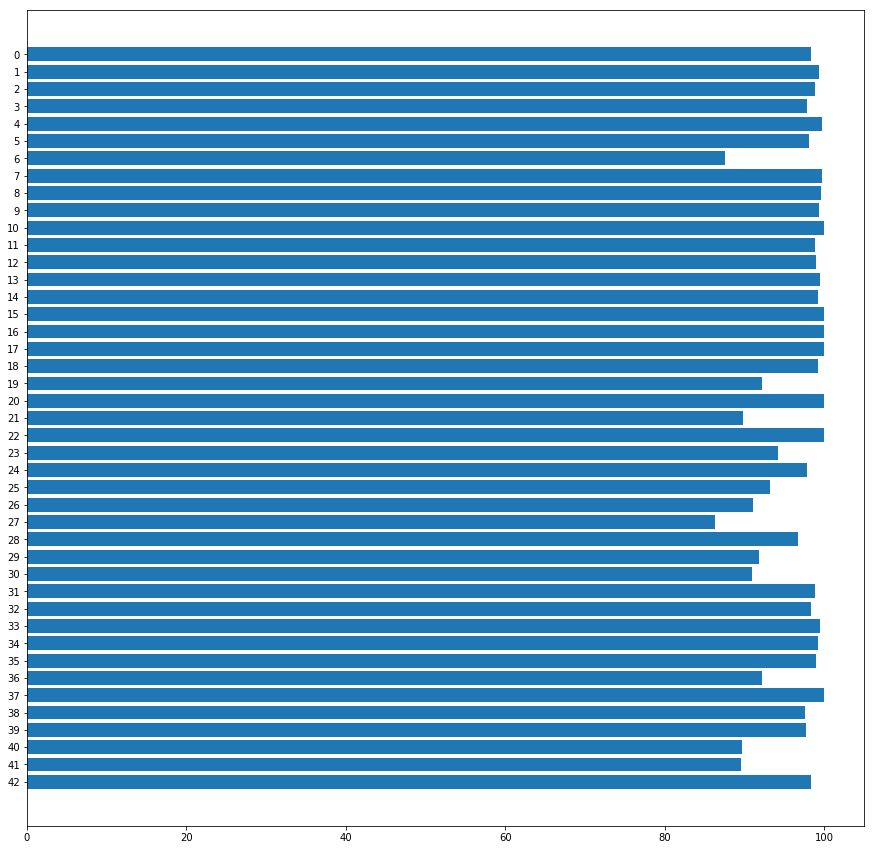

Recall summary:


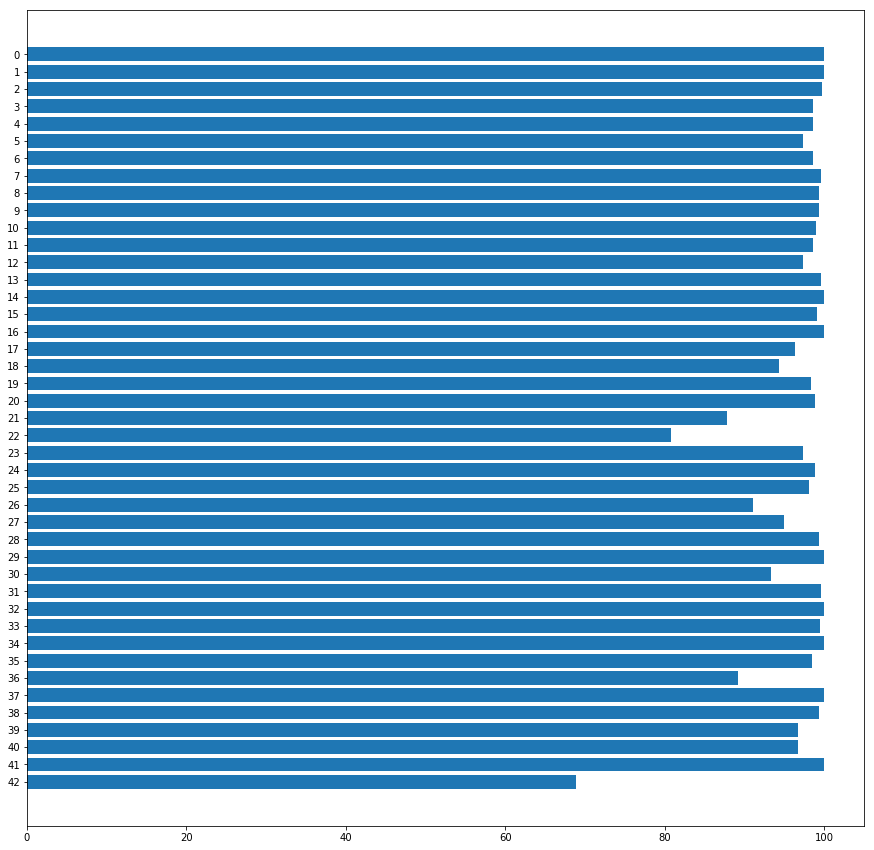

 0 - Speed limit (20km/h)
    Precision = 98.36%, Recall = 100.00%
 1 - Speed limit (30km/h)
    Precision = 99.31%, Recall = 100.00%
 2 - Speed limit (50km/h)
    Precision = 98.81%, Recall = 99.73%
 3 - Speed limit (60km/h)
    Precision = 97.80%, Recall = 98.67%
 4 - Speed limit (70km/h)
    Precision = 99.69%, Recall = 98.64%
 5 - Speed limit (80km/h)
    Precision = 98.08%, Recall = 97.30%
 6 - End of speed limit (80km/h)
    Precision = 87.57%, Recall = 98.67%
 7 - Speed limit (100km/h)
    Precision = 99.78%, Recall = 99.56%
 8 - Speed limit (120km/h)
    Precision = 99.55%, Recall = 99.33%
 9 - No passing
    Precision = 99.38%, Recall = 99.38%
10 - No passing for vehicles over 3.5 metric tons
    Precision = 100.00%, Recall = 98.94%
11 - Right-of-way at the next intersection
    Precision = 98.81%, Recall = 98.57%
12 - Priority road
    Precision = 98.97%, Recall = 97.39%
13 - Yield
    Precision = 99.45%, Recall = 99.58%
14 - Stop
    Precision = 99.26%, Recall = 100.00%
15 -

In [19]:
print_precision_recall(data_test, model.model_precision_recall(data_test))

---

## Step 3: Test a Model on New Images

To give yourself more insight into how your model is working, download at least five pictures of German traffic signs from the web and use your model to predict the traffic sign type.

You may find `signnames.csv` useful as it contains mappings from the class id (integer) to the actual sign name.

### Load and Output the Images

In [20]:
import numpy as np

class DeepDataEngineVirt(DeepDataEngine):
    """
    Virtual data engine.
    This is successor of main DeepDataEngine class.
    Must be used for validation only. Don't store data in external storage, don't shuffle and iterate it in the same sequence as original data loaded.
    """

    def __init__(
        self,
        set_name,
        batch_size = 128):

        DeepDataEngine.__init__(self, set_name, batch_size = batch_size)

    def isVirtual(self):
        return True

    def initStorage(self, override = False, base_file_path = '', class_samples = -1):
        assert(len(self.features) > 0)
        assert(len(self.labels) > 0)

        data_shape = self.features.shape
        data_size = data_shape[0]
        data_height = data_shape[1]
        data_width = data_shape[2]

        x_buf = np.zeros((data_size, data_height, data_width, self.data_depth))
        y_buf = np.zeros(data_size, dtype = self.labels.dtype)

        for idx in range(data_size):
            img_proc = self._pre_process_image(self.features[idx])
            for img_depth_idx in range(min(self.data_depth, len(img_proc))):
                x_buf[idx, :, :, img_depth_idx] = img_proc[img_depth_idx]

            y_buf[idx] = self.labels[idx]

        self.storage_buf_x = x_buf
        self.storage_buf_y = y_buf
        self.storage_buf_pos = 0

    def initRead(self):
        self.storage_buf_pos = 0

    def readNext(self):
        x_data = self.storage_buf_x[self.storage_buf_pos:self.storage_buf_pos + self.batch_size]
        y_data = self.storage_buf_y[self.storage_buf_pos:self.storage_buf_pos + self.batch_size]

        self.storage_buf_pos += len(x_data)

        return x_data, y_data

print('Virtual deep data engine is loaded.')

Virtual deep data engine is loaded.


In [21]:
def load_ext_data():
    """
    Load extra data from prepared images
    """

    ext_images_dir = './signs_new/'
    descriptions_file = './signnames.csv'
    
    data_ext = DeepDataEngineVirt('ext')
    data_ext.loadDataFromImageSet(ext_images_dir)
    data_ext.loadDescriptionsFromFile(descriptions_file)

    return data_ext

data_ext = load_ext_data()

print('Extra data set is loaded.')

Extra data set is loaded.


In [22]:
def print_ext_data_information(data_ext):
    n_ext = data_ext.getDataSize()
    image_shape = data_ext.getImageShape()
    
    print("Number of extra examples =", n_ext)
    print("Image data shape =", image_shape)
    
print_ext_data_information(data_ext)

Number of extra examples = 25
Image data shape = (32, 32, 3)


Extra data:


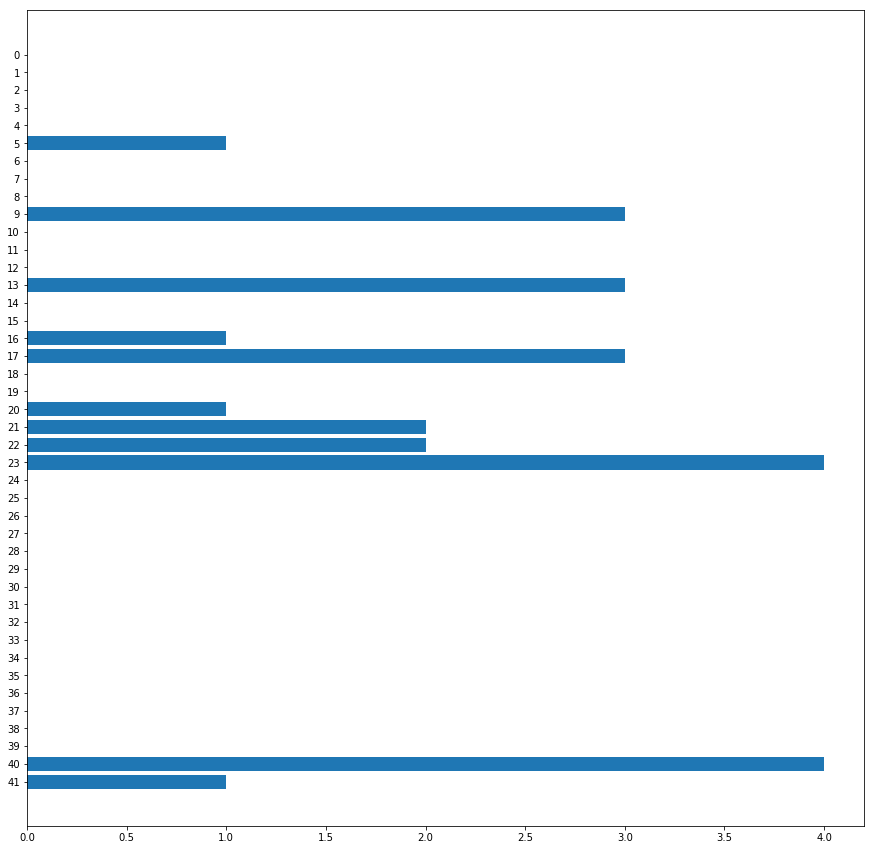

 5 - Speed limit (80km/h)
    Count = 1


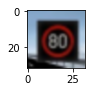

 9 - No passing
    Count = 3


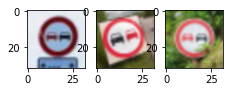

13 - Yield
    Count = 3


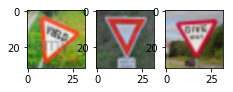

16 - Vehicles over 3.5 metric tons prohibited
    Count = 1


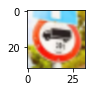

17 - No entry
    Count = 3


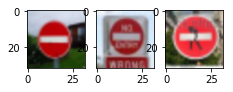

20 - Dangerous curve to the right
    Count = 1


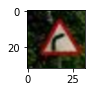

21 - Double curve
    Count = 2


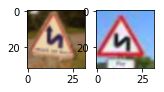

22 - Bumpy road
    Count = 2


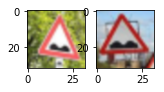

23 - Slippery road
    Count = 4


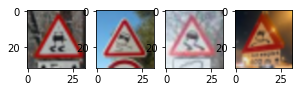

40 - Roundabout mandatory
    Count = 4


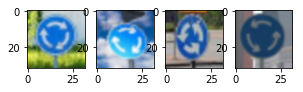

41 - End of no passing
    Count = 1


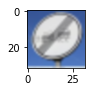

In [23]:
print_dataset_statistic(data_ext, desc = 'Extra data:')

### Predict the Sign Type for Each Image

In [24]:
data_ext.initStorage(override = True)

print("Data storage for extra data is initialized.")

Data storage for extra data is initialized.


INFO:tensorflow:Restoring parameters from ./deep_model_v3_d2\deep_model
Predictions:
5 - Speed limit (80km/h)
    Predicted as: 8 - Speed limit (120km/h)


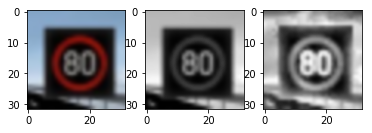

9 - No passing
    Predicted as: 9 - No passing


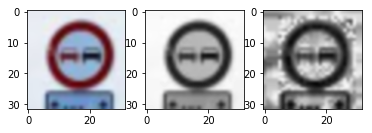

9 - No passing
    Predicted as: 9 - No passing


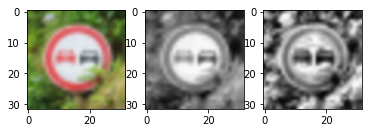

9 - No passing
    Predicted as: 9 - No passing


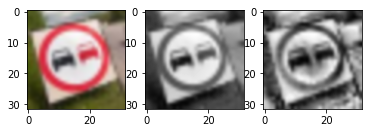

13 - Yield
    Predicted as: 13 - Yield


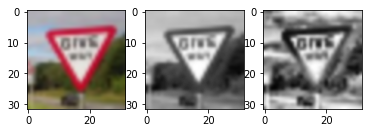

13 - Yield
    Predicted as: 13 - Yield


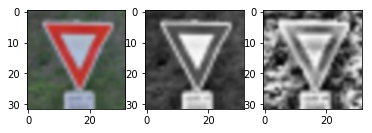

13 - Yield
    Predicted as: 36 - Go straight or right


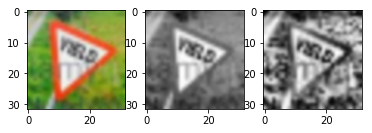

16 - Vehicles over 3.5 metric tons prohibited
    Predicted as: 40 - Roundabout mandatory


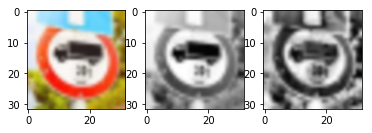

21 - Double curve
    Predicted as: 28 - Children crossing


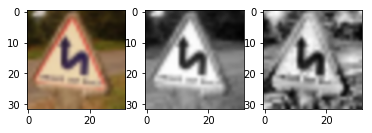

21 - Double curve
    Predicted as: 21 - Double curve


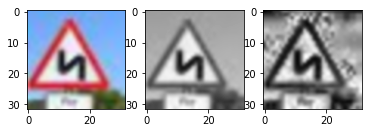

22 - Bumpy road
    Predicted as: 22 - Bumpy road


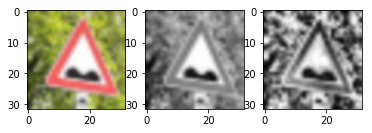

22 - Bumpy road
    Predicted as: 22 - Bumpy road


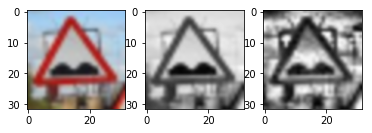

23 - Slippery road
    Predicted as: 23 - Slippery road


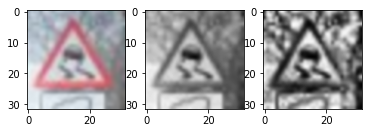

23 - Slippery road
    Predicted as: 29 - Bicycles crossing


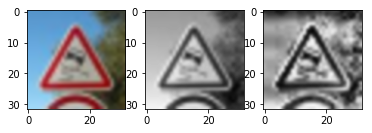

23 - Slippery road
    Predicted as: 23 - Slippery road


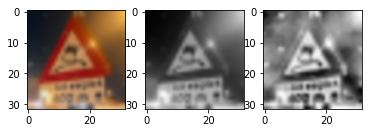

23 - Slippery road
    Predicted as: 23 - Slippery road


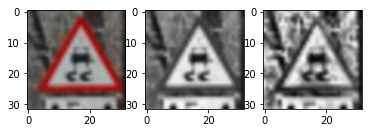

40 - Roundabout mandatory
    Predicted as: 40 - Roundabout mandatory


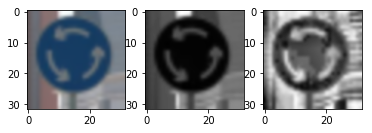

40 - Roundabout mandatory
    Predicted as: 40 - Roundabout mandatory


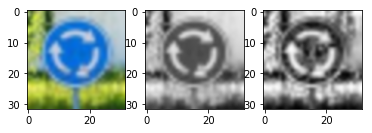

40 - Roundabout mandatory
    Predicted as: 7 - Speed limit (100km/h)


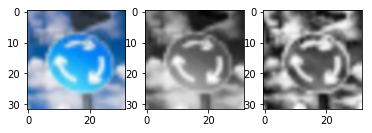

40 - Roundabout mandatory
    Predicted as: 40 - Roundabout mandatory


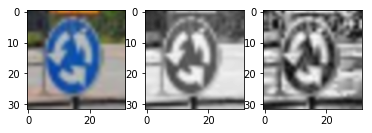

41 - End of no passing
    Predicted as: 41 - End of no passing


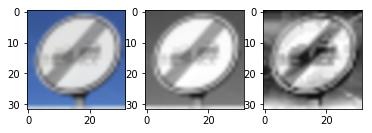

17 - No entry
    Predicted as: 7 - Speed limit (100km/h)


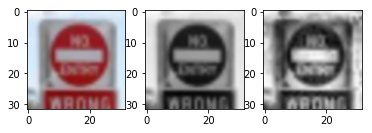

17 - No entry
    Predicted as: 17 - No entry


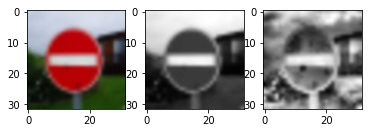

17 - No entry
    Predicted as: 17 - No entry


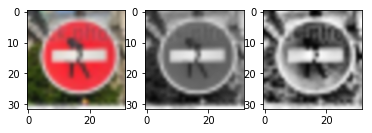

20 - Dangerous curve to the right
    Predicted as: 20 - Dangerous curve to the right


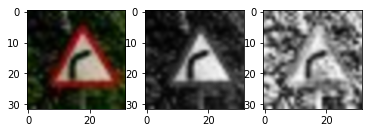

In [25]:
def print_predictions(data_set, prediction_data, desc = 'Predictions:'):
    print(desc)

    isVirtualInt = int(data_set.isVirtual())

    for data_idx in range(len(prediction_data)):
        img, y_correct, y_predict = prediction_data[data_idx]

        print("{} - {}".format(y_correct, data_set.getDescriptions()[y_correct]))
        print("    Predicted as: {} - {}".format(y_predict, data_set.getDescriptions()[y_predict]))

        if isVirtualInt > 0:
            plt.subplot(1, img.shape[2] + isVirtualInt, 1)
            plt.imshow(data_set.getData()[0][data_idx], interpolation="quadric")

        for img_idx in range(img.shape[2]):
            plt.subplot(1, img.shape[2] + isVirtualInt, img_idx + 1 + isVirtualInt)
            plt.imshow(img[:, :, img_idx], interpolation="quadric", cmap="gray")
        
        plt.show()
        
print_predictions(data_ext, model.get_batch_prediction(data_ext))

### Analyze Performance

In [26]:
print("Extra data prediction accuracy: {:.2f}%".format(model.validate_model(data_ext) * 100))

INFO:tensorflow:Restoring parameters from ./deep_model_v3_d2\deep_model
Extra data prediction accuracy: 72.00%


### Output Top 5 Softmax Probabilities For Each Image Found on the Web

For each of the new images, print out the model's softmax probabilities to show the **certainty** of the model's predictions (limit the output to the top 5 probabilities for each image). [`tf.nn.top_k`](https://www.tensorflow.org/versions/r0.12/api_docs/python/nn.html#top_k) could prove helpful here. 

The example below demonstrates how tf.nn.top_k can be used to find the top k predictions for each image.

`tf.nn.top_k` will return the values and indices (class ids) of the top k predictions. So if k=3, for each sign, it'll return the 3 largest probabilities (out of a possible 43) and the correspoding class ids.

Take this numpy array as an example. The values in the array represent predictions. The array contains softmax probabilities for five candidate images with six possible classes. `tf.nn.top_k` is used to choose the three classes with the highest probability:

```
# (5, 6) array
a = np.array([[ 0.24879643,  0.07032244,  0.12641572,  0.34763842,  0.07893497,
         0.12789202],
       [ 0.28086119,  0.27569815,  0.08594638,  0.0178669 ,  0.18063401,
         0.15899337],
       [ 0.26076848,  0.23664738,  0.08020603,  0.07001922,  0.1134371 ,
         0.23892179],
       [ 0.11943333,  0.29198961,  0.02605103,  0.26234032,  0.1351348 ,
         0.16505091],
       [ 0.09561176,  0.34396535,  0.0643941 ,  0.16240774,  0.24206137,
         0.09155967]])
```

Running it through `sess.run(tf.nn.top_k(tf.constant(a), k=3))` produces:

```
TopKV2(values=array([[ 0.34763842,  0.24879643,  0.12789202],
       [ 0.28086119,  0.27569815,  0.18063401],
       [ 0.26076848,  0.23892179,  0.23664738],
       [ 0.29198961,  0.26234032,  0.16505091],
       [ 0.34396535,  0.24206137,  0.16240774]]), indices=array([[3, 0, 5],
       [0, 1, 4],
       [0, 5, 1],
       [1, 3, 5],
       [1, 4, 3]], dtype=int32))
```

Looking just at the first row we get `[ 0.34763842,  0.24879643,  0.12789202]`, you can confirm these are the 3 largest probabilities in `a`. You'll also notice `[3, 0, 5]` are the corresponding indices.

INFO:tensorflow:Restoring parameters from ./deep_model_v3_d2\deep_model
Soft-max statistic:
5 - Speed limit (80km/h)
     8 - 1.00000
     0 - 0.00000
    14 - 0.00000
     7 - 0.00000
     5 - 0.00000


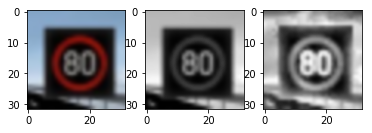

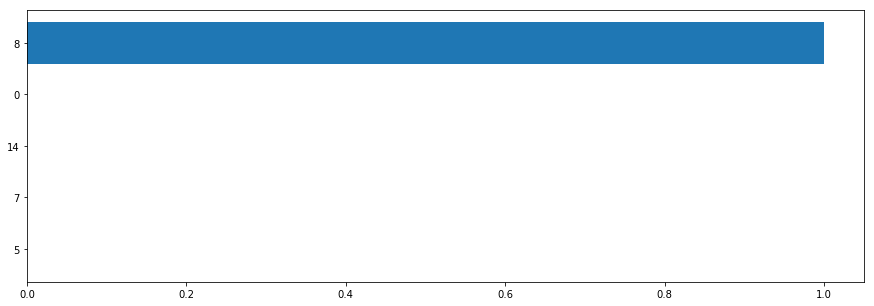

9 - No passing
     9 - 1.00000
    16 - 0.00000
    10 - 0.00000
    15 - 0.00000
     2 - 0.00000


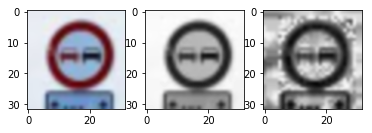

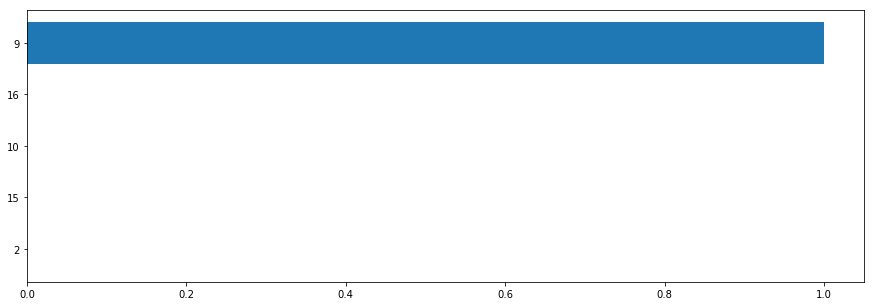

9 - No passing
     9 - 1.00000
    10 - 0.00000
    16 - 0.00000
     2 - 0.00000
     3 - 0.00000


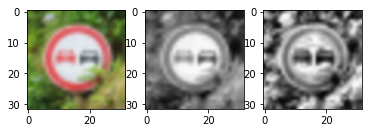

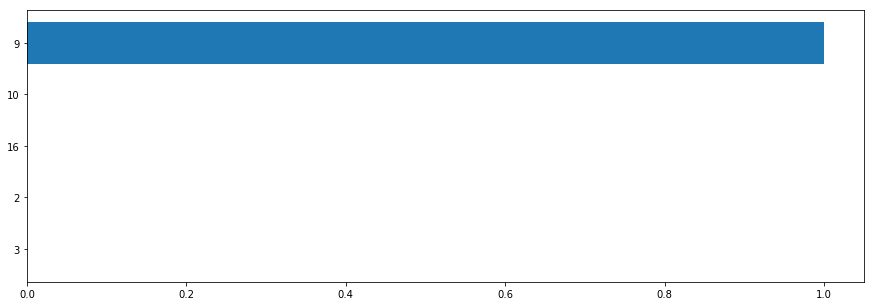

9 - No passing
     9 - 0.99987
    10 - 0.00006
    16 - 0.00002
     2 - 0.00001
     3 - 0.00001


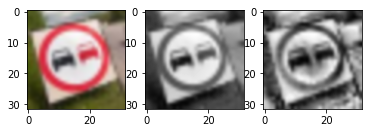

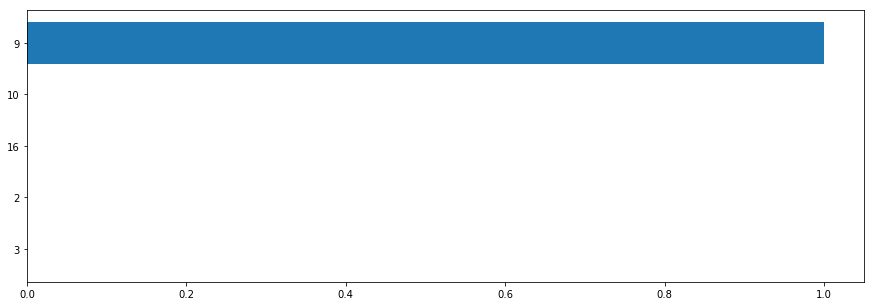

13 - Yield
    13 - 0.99906
    12 - 0.00036
    41 - 0.00019
    26 - 0.00010
    15 - 0.00009


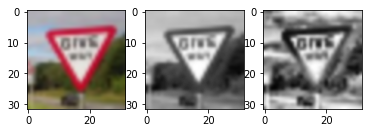

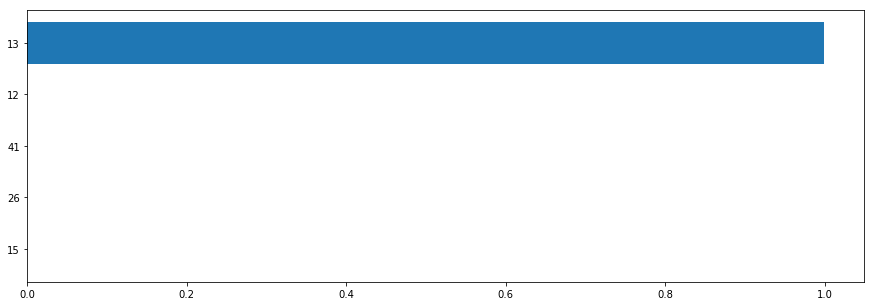

13 - Yield
    13 - 1.00000
    15 - 0.00000
    12 - 0.00000
    41 - 0.00000
    22 - 0.00000


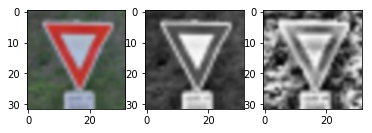

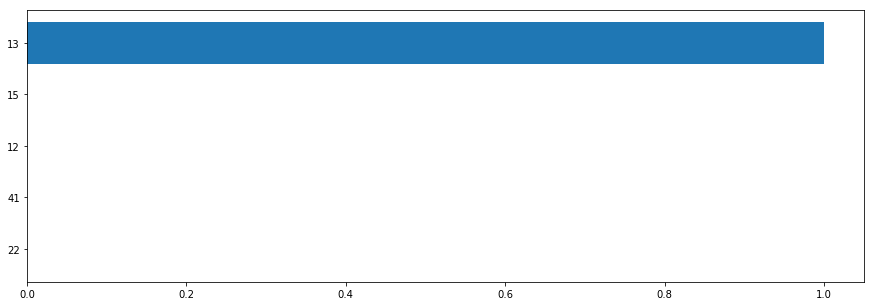

13 - Yield
    36 - 0.12870
    40 - 0.11730
    25 - 0.10215
     1 - 0.09956
     3 - 0.07532


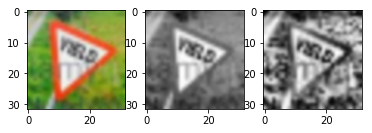

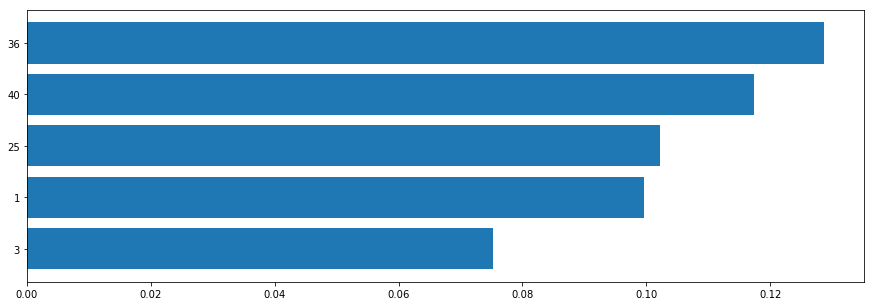

16 - Vehicles over 3.5 metric tons prohibited
    40 - 0.99867
     7 - 0.00047
     1 - 0.00034
     2 - 0.00017
    21 - 0.00006


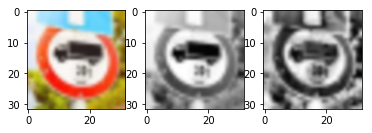

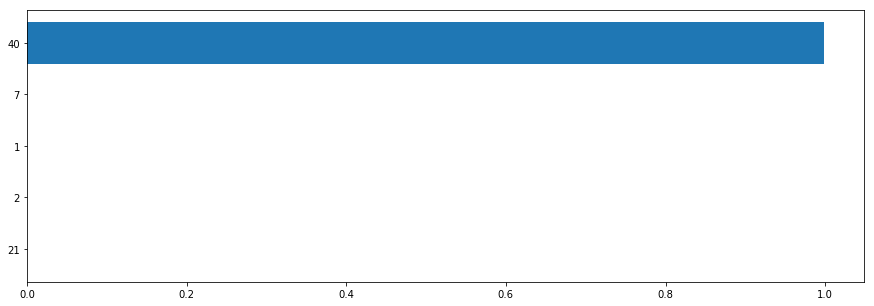

21 - Double curve
    28 - 0.96052
    21 - 0.02718
    23 - 0.00475
     1 - 0.00185
    27 - 0.00117


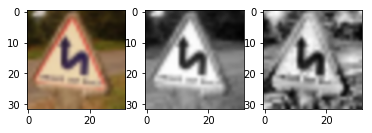

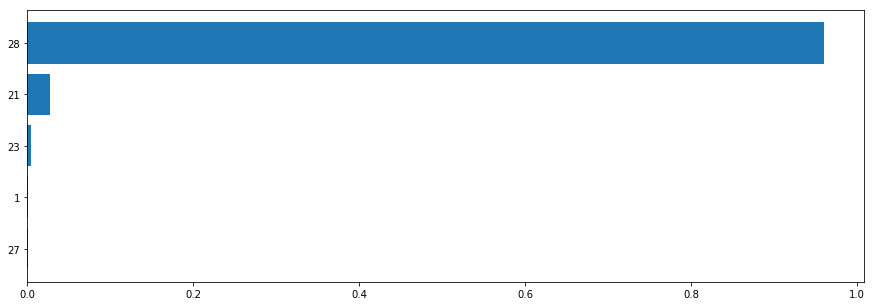

21 - Double curve
    21 - 0.86987
    11 - 0.12621
    30 - 0.00145
    27 - 0.00113
    40 - 0.00045


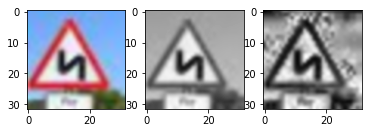

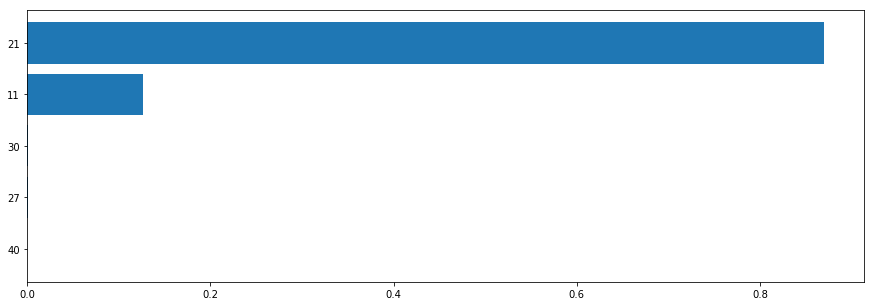

22 - Bumpy road
    22 - 1.00000
    25 - 0.00000
     0 - 0.00000
    23 - 0.00000
    34 - 0.00000


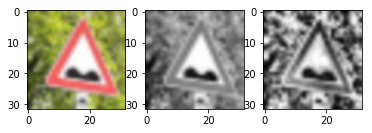

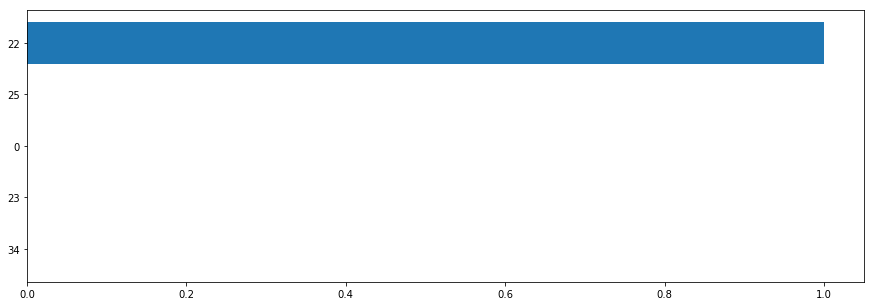

22 - Bumpy road
    22 - 1.00000
    23 - 0.00000
    29 - 0.00000
     9 - 0.00000
    34 - 0.00000


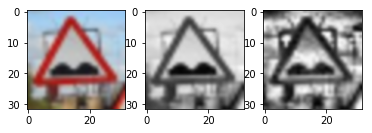

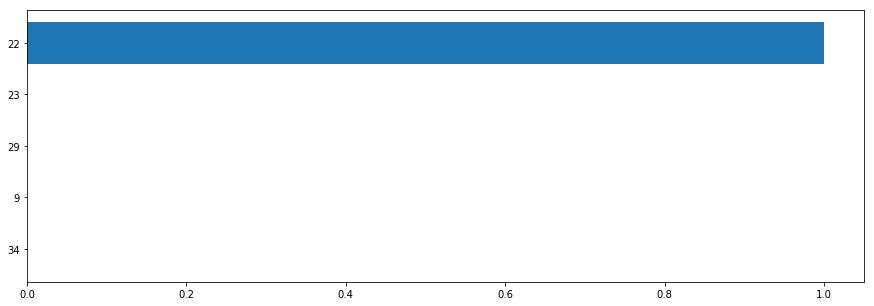

23 - Slippery road
    23 - 1.00000
    19 - 0.00000
    22 - 0.00000
    28 - 0.00000
    31 - 0.00000


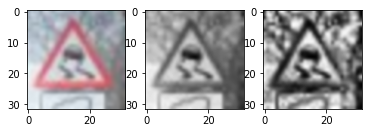

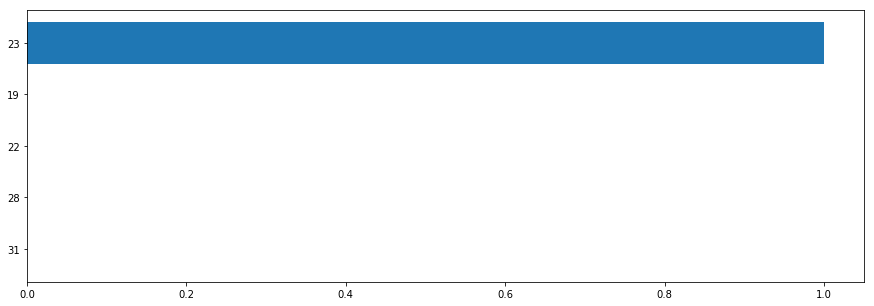

23 - Slippery road
    29 - 0.56221
    23 - 0.37239
    30 - 0.06532
    31 - 0.00003
    22 - 0.00002


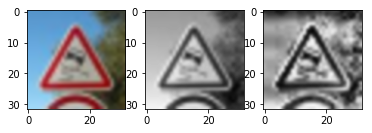

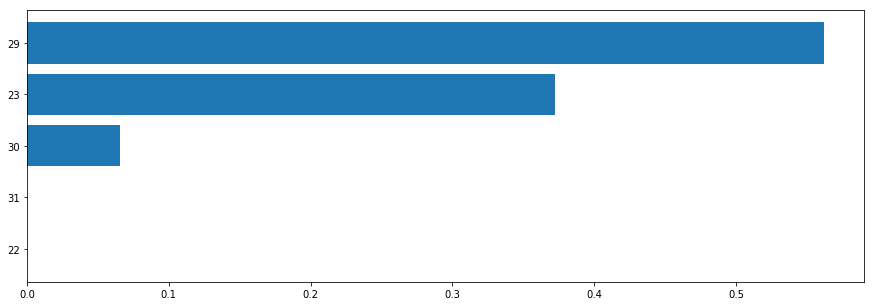

23 - Slippery road
    23 - 0.78916
     0 - 0.09217
    25 - 0.05240
    31 - 0.02229
    29 - 0.00869


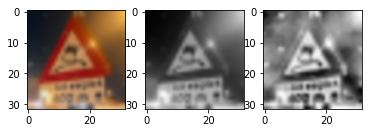

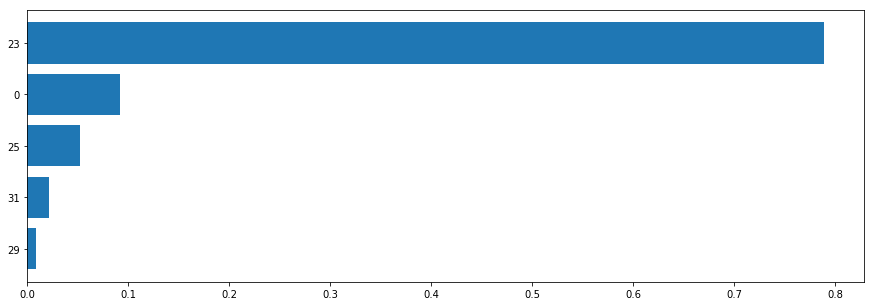

23 - Slippery road
    23 - 0.99945
    25 - 0.00029
    30 - 0.00012
    22 - 0.00006
    37 - 0.00003


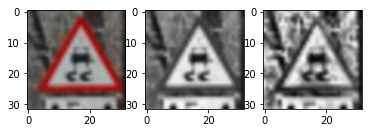

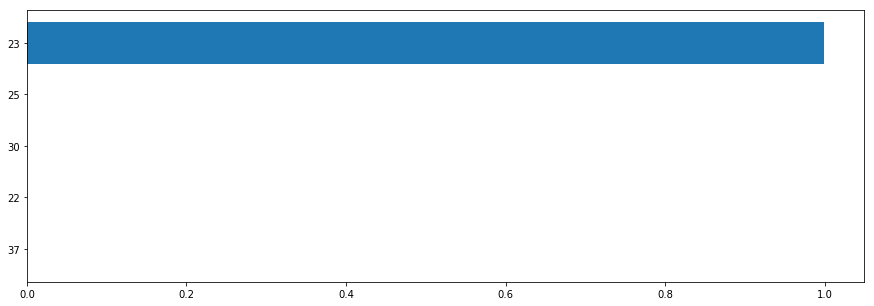

40 - Roundabout mandatory
    40 - 1.00000
    12 - 0.00000
     7 - 0.00000
    38 - 0.00000
    39 - 0.00000


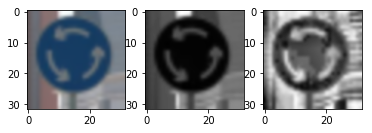

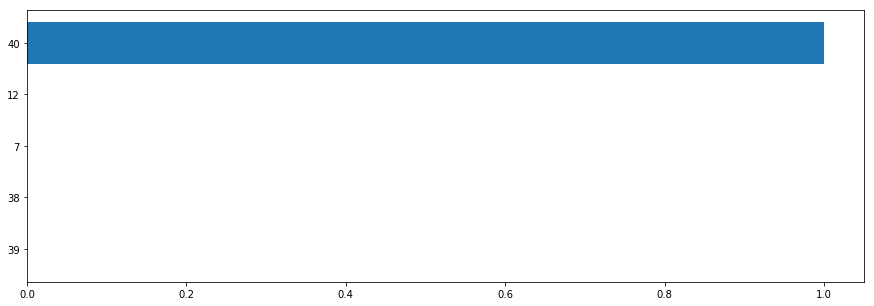

40 - Roundabout mandatory
    40 - 0.98925
     7 - 0.00626
     5 - 0.00152
     1 - 0.00137
     2 - 0.00021


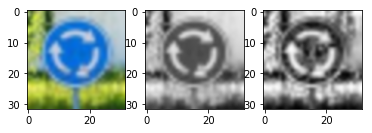

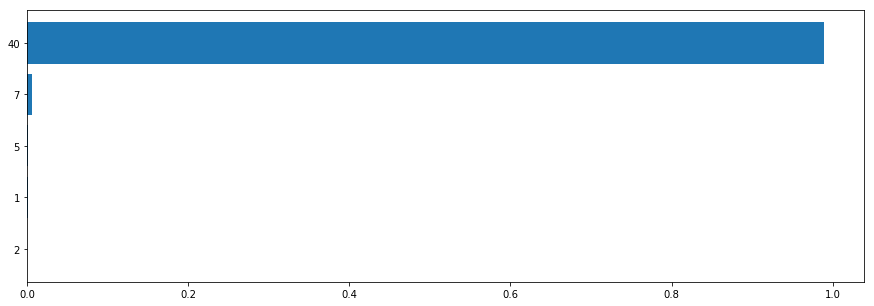

40 - Roundabout mandatory
     7 - 0.78843
    40 - 0.20947
    12 - 0.00188
     5 - 0.00012
     1 - 0.00003


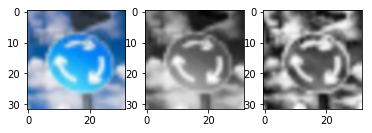

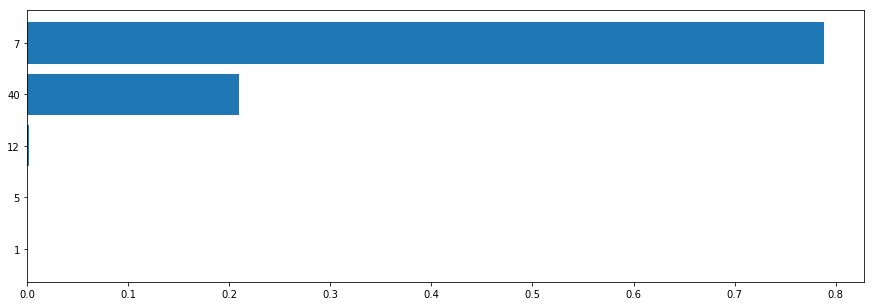

40 - Roundabout mandatory
    40 - 1.00000
    12 - 0.00000
    11 - 0.00000
    39 - 0.00000
     7 - 0.00000


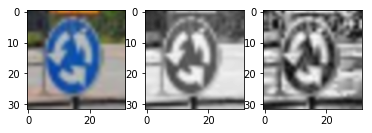

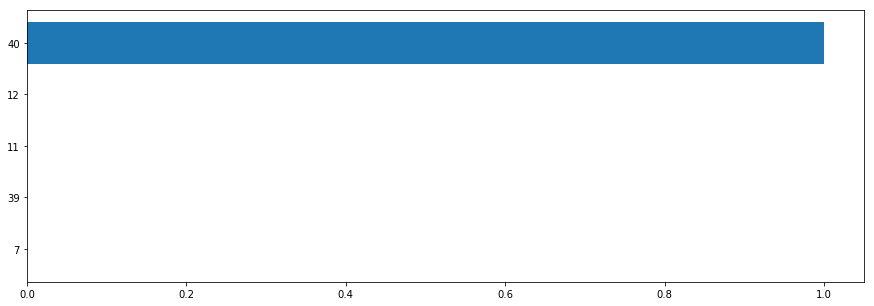

41 - End of no passing
    41 - 0.93147
     9 - 0.06460
    19 - 0.00220
    16 - 0.00068
    32 - 0.00038


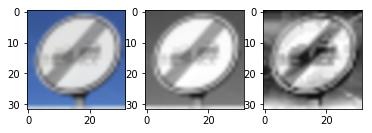

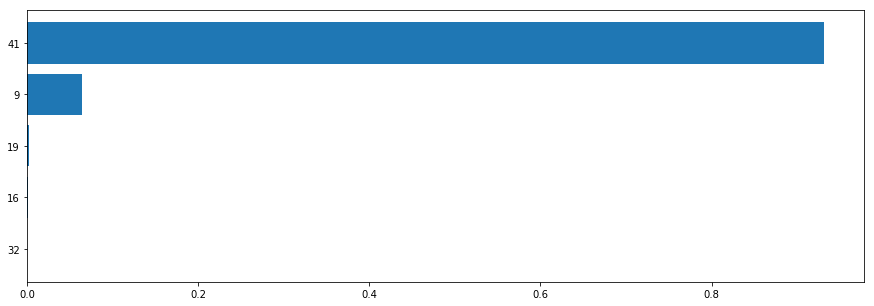

17 - No entry
     7 - 0.48931
     8 - 0.22714
     5 - 0.07116
    40 - 0.06983
     2 - 0.03941


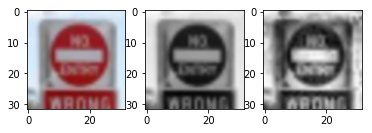

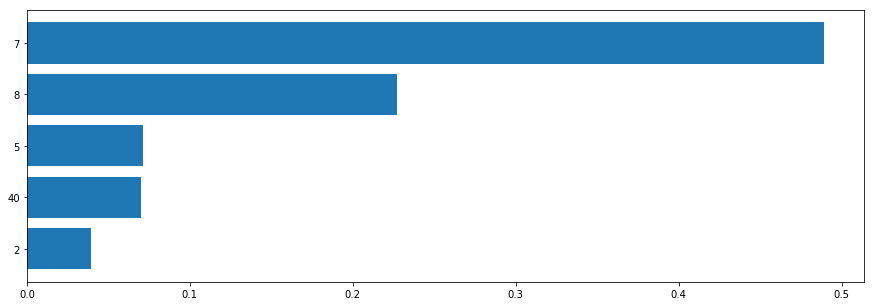

17 - No entry
    17 - 1.00000
    42 - 0.00000
    12 - 0.00000
    38 - 0.00000
    39 - 0.00000


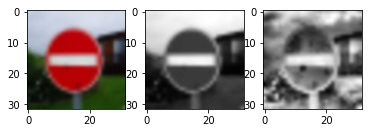

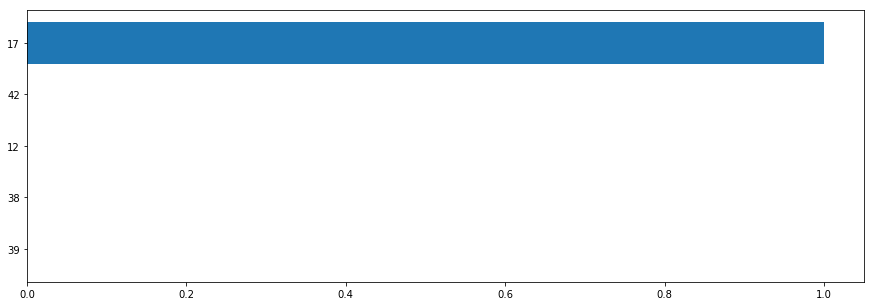

17 - No entry
    17 - 0.50171
    29 - 0.48764
    31 - 0.00300
    12 - 0.00194
    14 - 0.00149


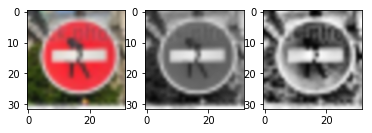

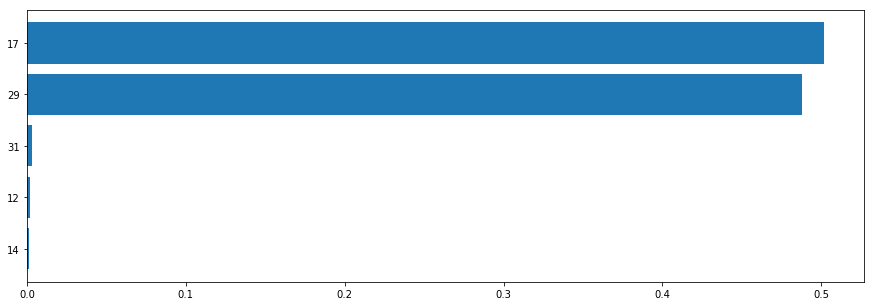

20 - Dangerous curve to the right
    20 - 1.00000
    26 - 0.00000
    18 - 0.00000
    19 - 0.00000
    31 - 0.00000


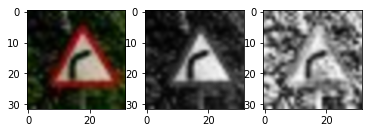

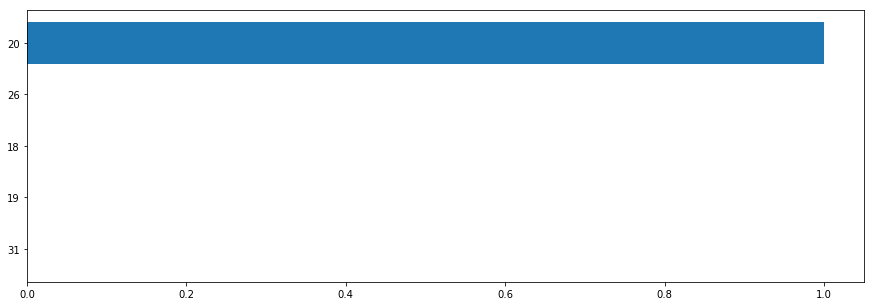

In [27]:
def print_softmax_statistic(data_set, softmax_top_data, desc = 'Soft-max statistic:'):
    print(desc)

    isVirtualInt = int(data_set.isVirtual())

    for data_idx in range(len(softmax_top_data)):
        img, y_correct, soft_max_val, y_predict = softmax_top_data[data_idx]

        print("{} - {}".format(y_correct, data_set.getDescriptions()[y_correct]))
        
        for y_pred_val, sm_val in zip(y_predict, soft_max_val):
            print("    {:>2} - {:.5f}".format(y_pred_val, sm_val))

        if isVirtualInt > 0:
            plt.subplot(1, img.shape[2] + isVirtualInt, 1)
            plt.imshow(data_set.getData()[0][data_idx], interpolation="quadric")

        for img_idx in range(img.shape[2]):
            plt.subplot(1, img.shape[2] + isVirtualInt, img_idx + 1 + isVirtualInt)
            plt.imshow(img[:, :, img_idx], interpolation="quadric", cmap="gray")
        
        plt.show()

        plt_classes = range(len(y_predict))
        plt.figure(figsize = (15, 5))
        plt.barh(plt_classes, soft_max_val[::-1])
        plt.yticks(plt_classes, y_predict[::-1])
        plt.show()
        
print_softmax_statistic(data_ext, model.get_batch_softmax(data_ext))

### Project Writeup

Once you have completed the code implementation, document your results in a project writeup using this [template](https://github.com/udacity/CarND-Traffic-Sign-Classifier-Project/blob/master/writeup_template.md) as a guide. The writeup can be in a markdown or pdf file. 

> **Note**: Once you have completed all of the code implementations and successfully answered each question above, you may finalize your work by exporting the iPython Notebook as an HTML document. You can do this by using the menu above and navigating to  \n",
    "**File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.

---

## Step 4 (Optional): Visualize the Neural Network's State with Test Images

 This Section is not required to complete but acts as an additional excersise for understaning the output of a neural network's weights. While neural networks can be a great learning device they are often referred to as a black box. We can understand what the weights of a neural network look like better by plotting their feature maps. After successfully training your neural network you can see what it's feature maps look like by plotting the output of the network's weight layers in response to a test stimuli image. From these plotted feature maps, it's possible to see what characteristics of an image the network finds interesting. For a sign, maybe the inner network feature maps react with high activation to the sign's boundary outline or to the contrast in the sign's painted symbol.

 Provided for you below is the function code that allows you to get the visualization output of any tensorflow weight layer you want. The inputs to the function should be a stimuli image, one used during training or a new one you provided, and then the tensorflow variable name that represents the layer's state during the training process, for instance if you wanted to see what the [LeNet lab's](https://classroom.udacity.com/nanodegrees/nd013/parts/fbf77062-5703-404e-b60c-95b78b2f3f9e/modules/6df7ae49-c61c-4bb2-a23e-6527e69209ec/lessons/601ae704-1035-4287-8b11-e2c2716217ad/concepts/d4aca031-508f-4e0b-b493-e7b706120f81) feature maps looked like for it's second convolutional layer you could enter conv2 as the tf_activation variable.

For an example of what feature map outputs look like, check out NVIDIA's results in their paper [End-to-End Deep Learning for Self-Driving Cars](https://devblogs.nvidia.com/parallelforall/deep-learning-self-driving-cars/) in the section Visualization of internal CNN State. NVIDIA was able to show that their network's inner weights had high activations to road boundary lines by comparing feature maps from an image with a clear path to one without. Try experimenting with a similar test to show that your trained network's weights are looking for interesting features, whether it's looking at differences in feature maps from images with or without a sign, or even what feature maps look like in a trained network vs a completely untrained one on the same sign image.

<figure>
 <img src="visualize_cnn.png" width="380" alt="Combined Image" />
 <figcaption>
 <p></p> 
 <p style="text-align: center;"> Your output should look something like this (above)</p> 
 </figcaption>
</figure>
 <p></p> 


INFO:tensorflow:Restoring parameters from ./deep_model_v3_d2\deep_model
Activations per layer:
5 - Speed limit (80km/h)
    Predicted as: 8 - Speed limit (120km/h)


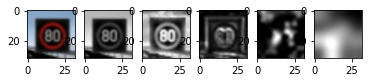

Layer 1


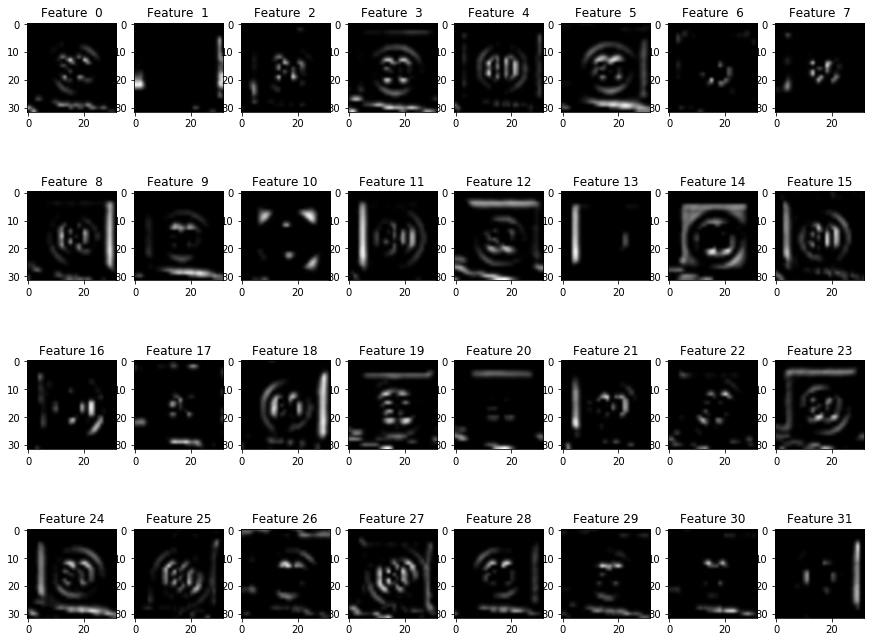

Layer 2


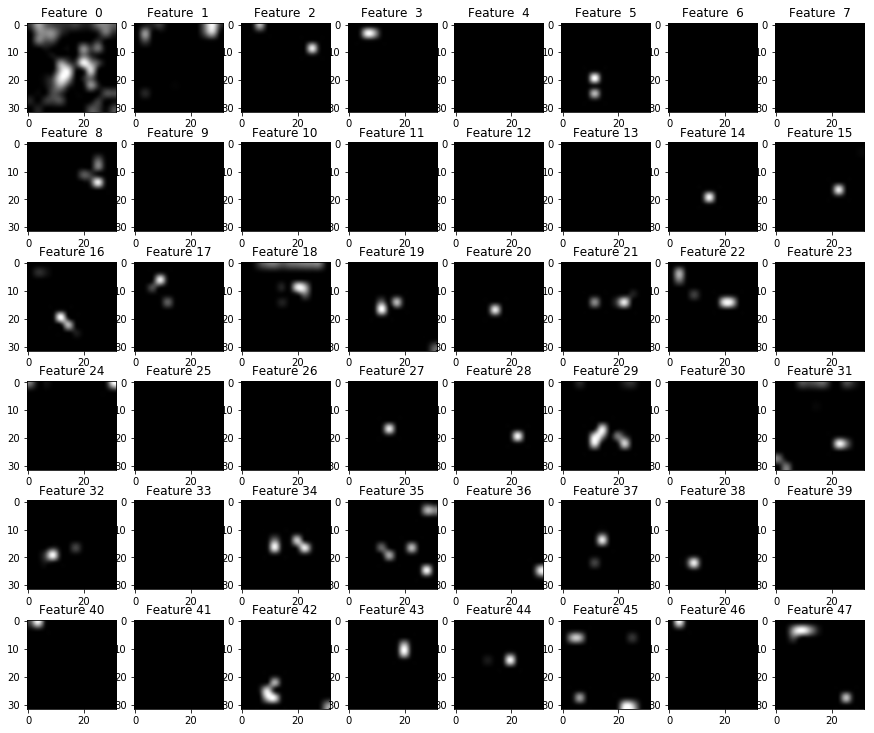

Layer 3


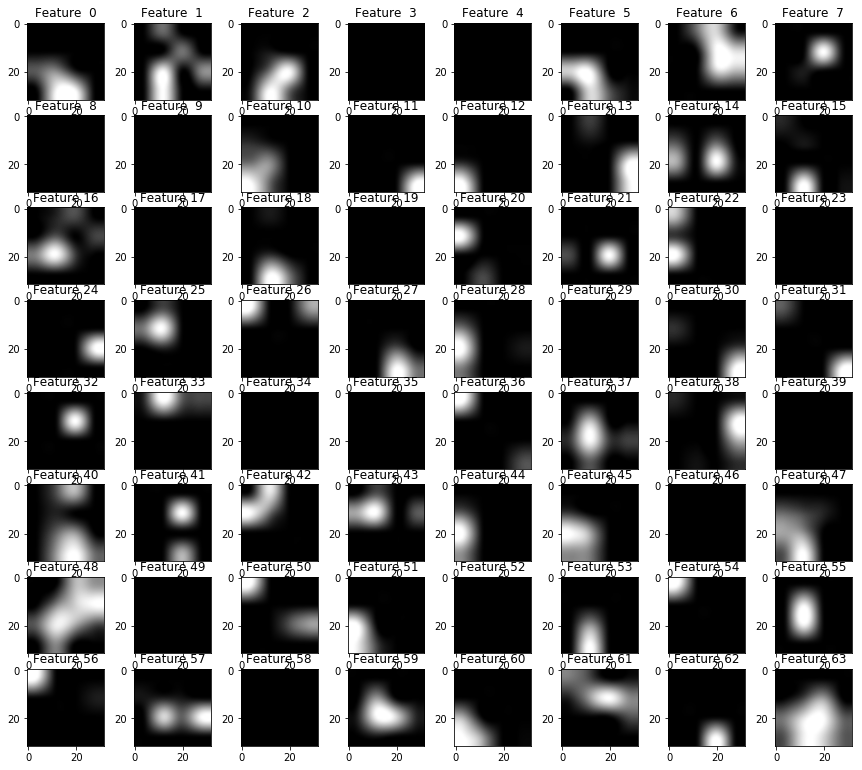

9 - No passing
    Predicted as: 9 - No passing


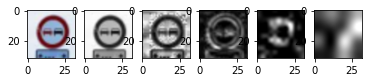

Layer 1


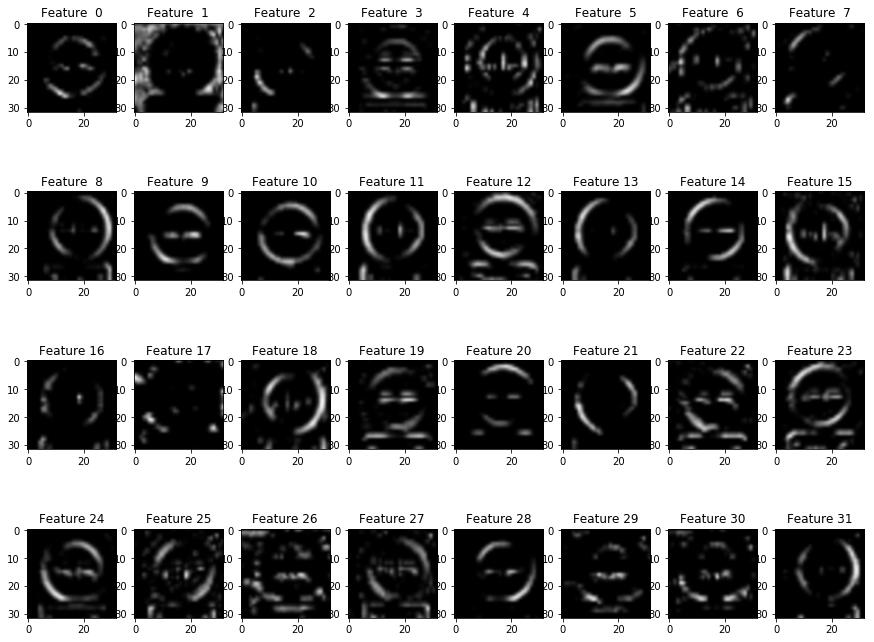

Layer 2


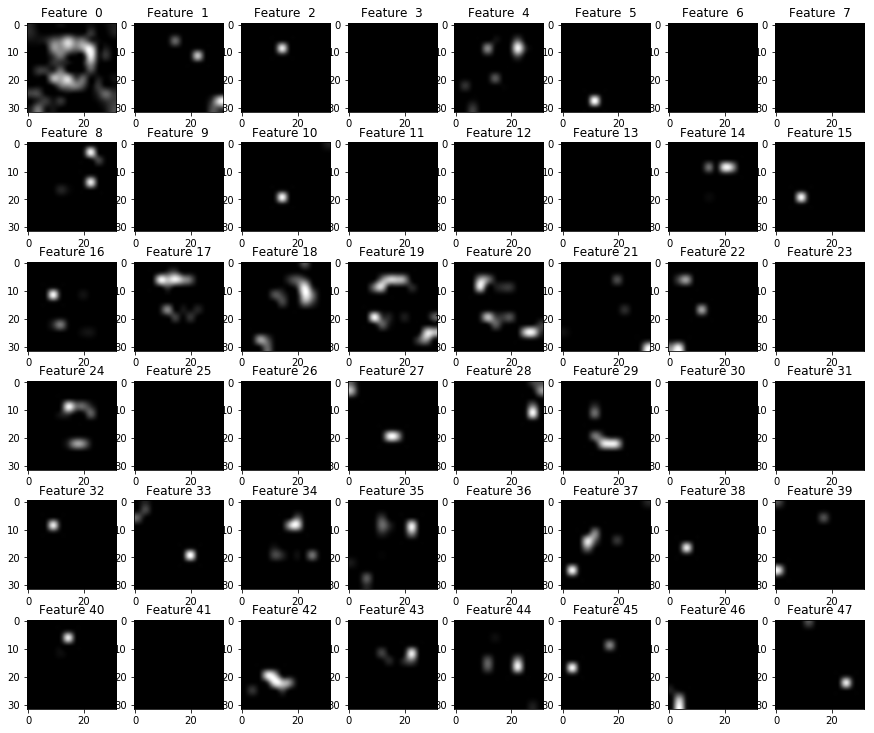

Layer 3


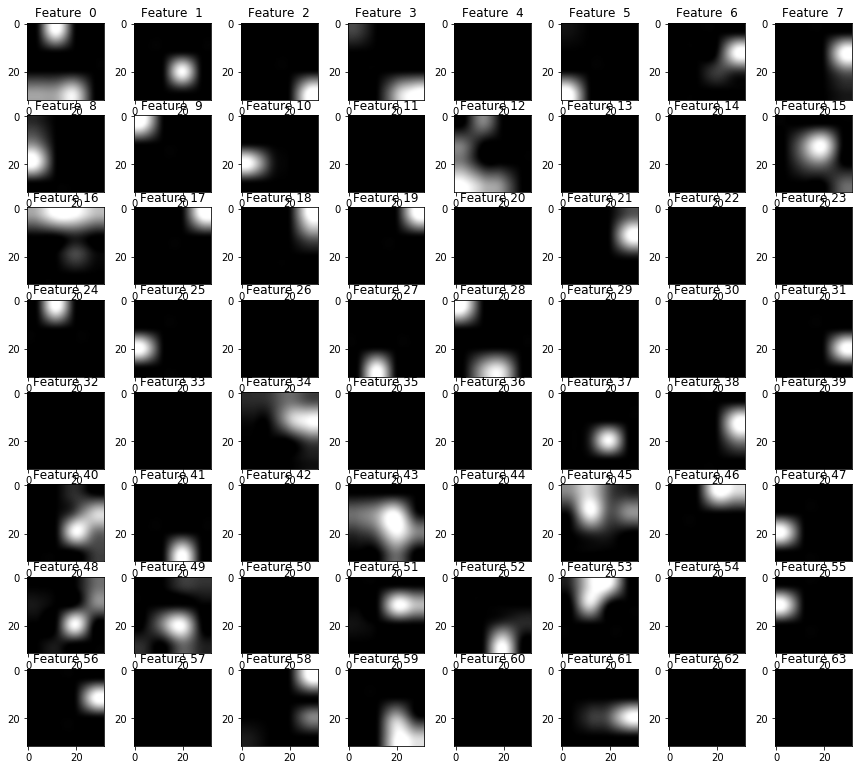

9 - No passing
    Predicted as: 9 - No passing


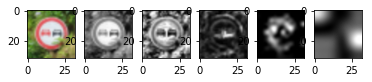

Layer 1


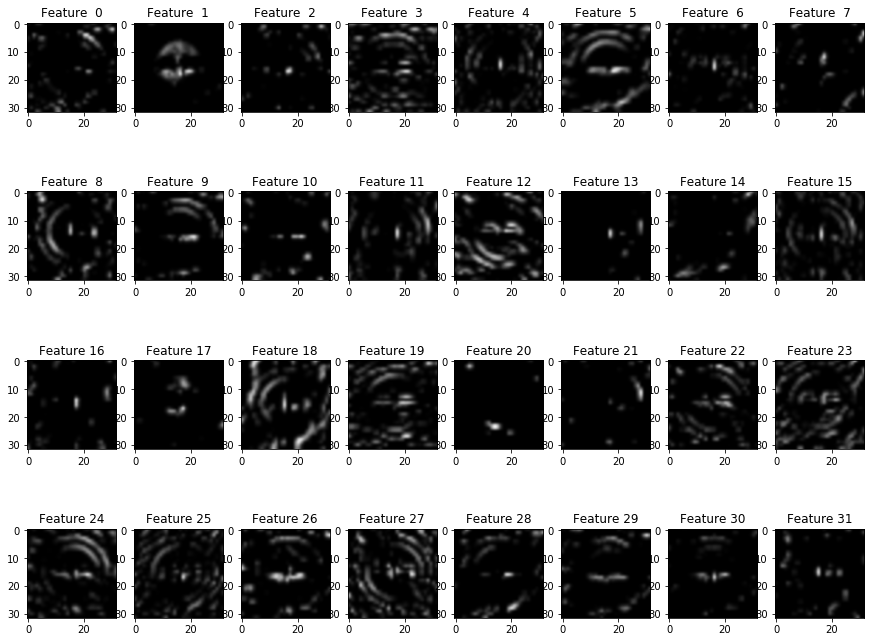

Layer 2


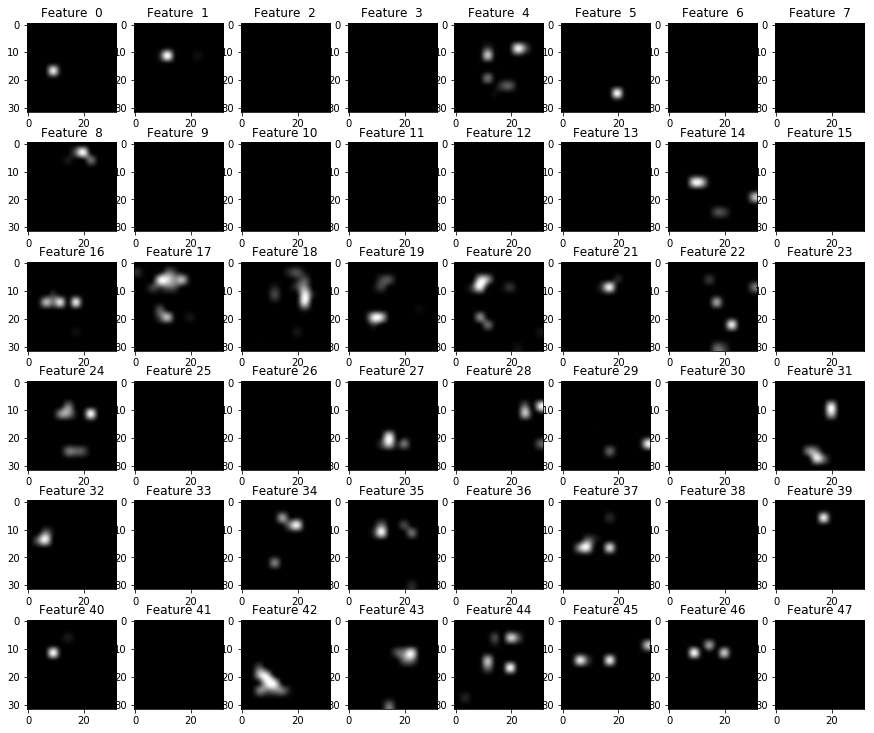

Layer 3


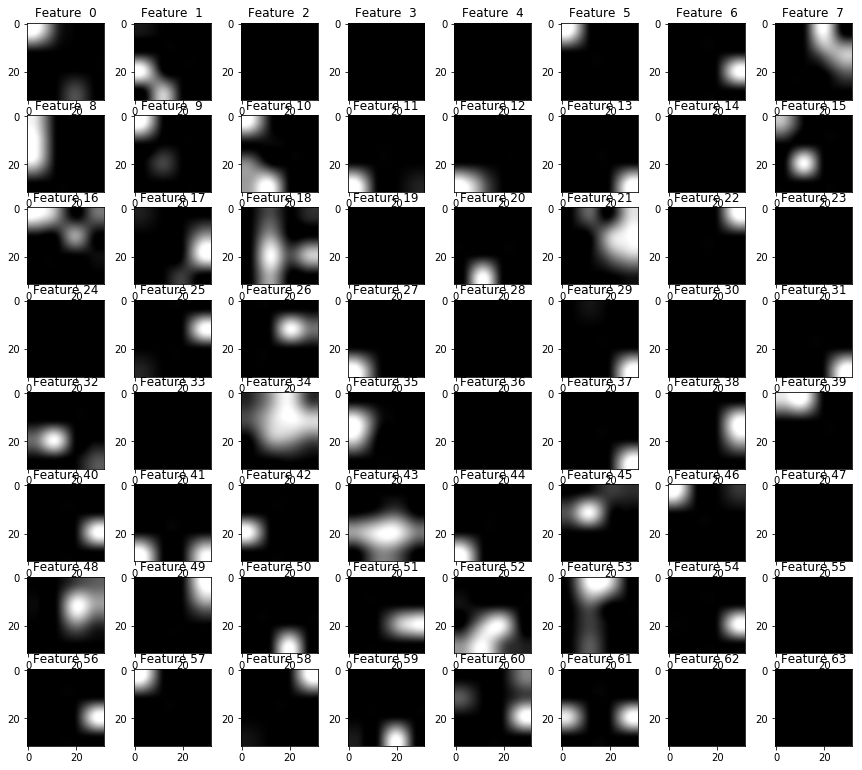

9 - No passing
    Predicted as: 9 - No passing


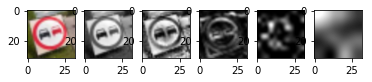

Layer 1


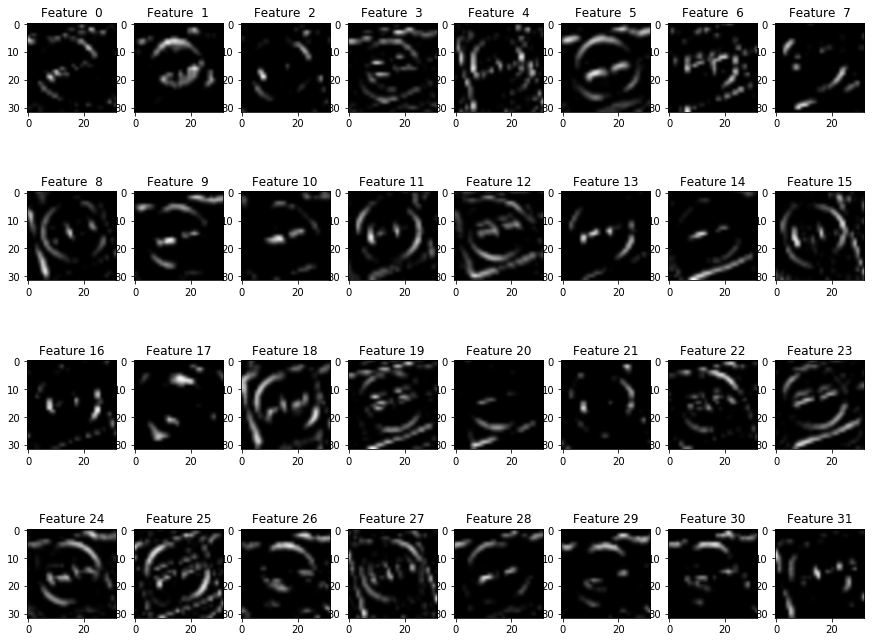

Layer 2


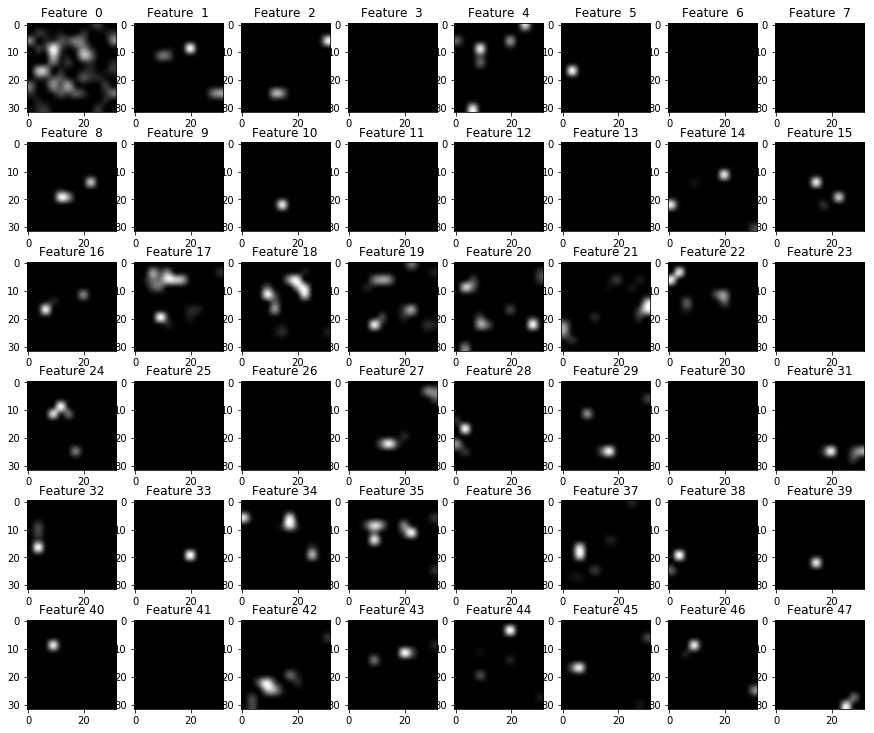

Layer 3


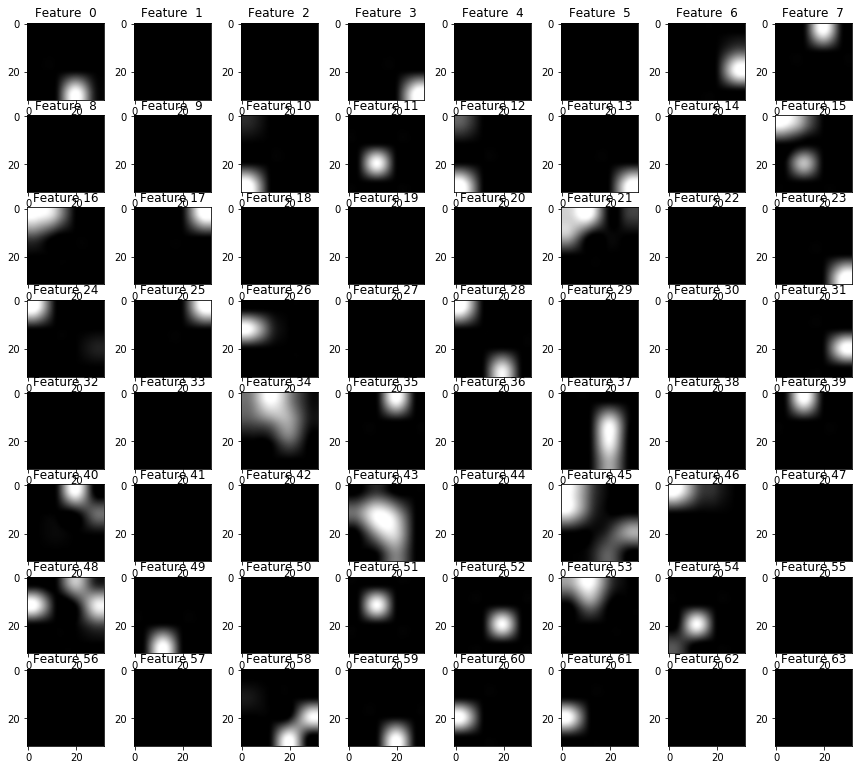

13 - Yield
    Predicted as: 13 - Yield


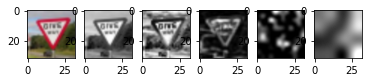

Layer 1


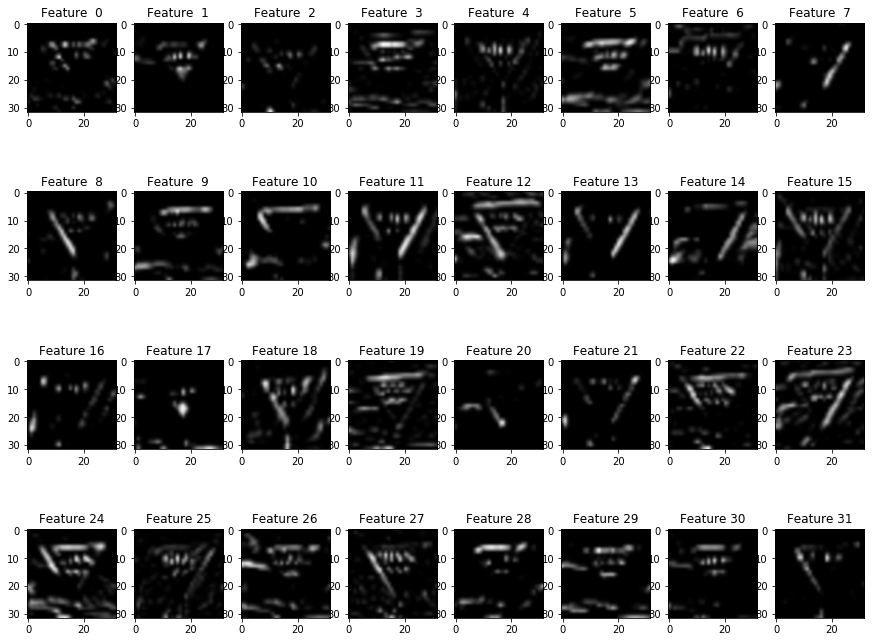

Layer 2


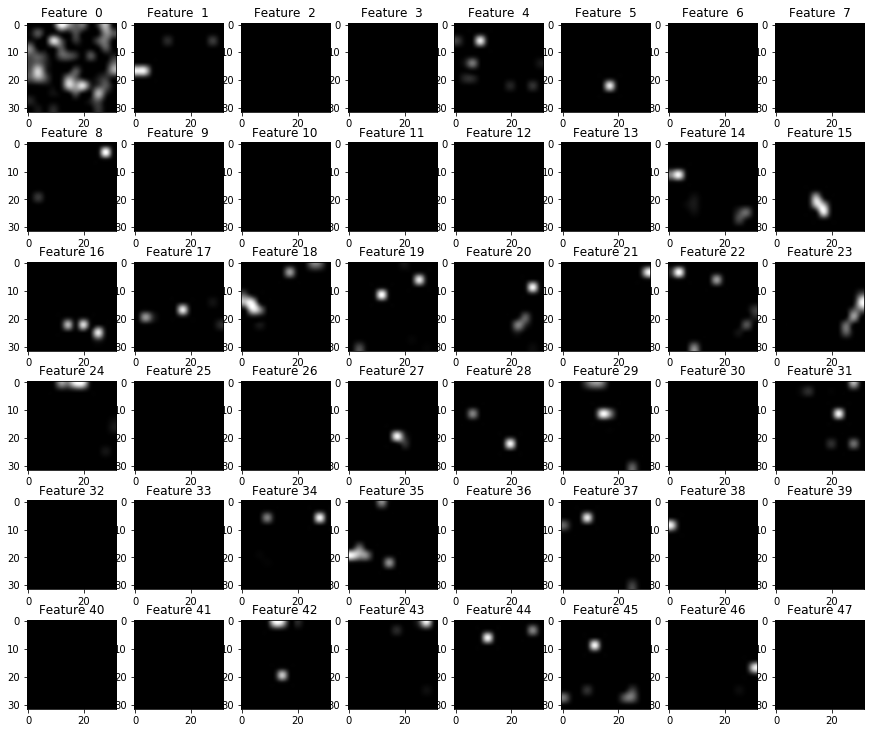

Layer 3


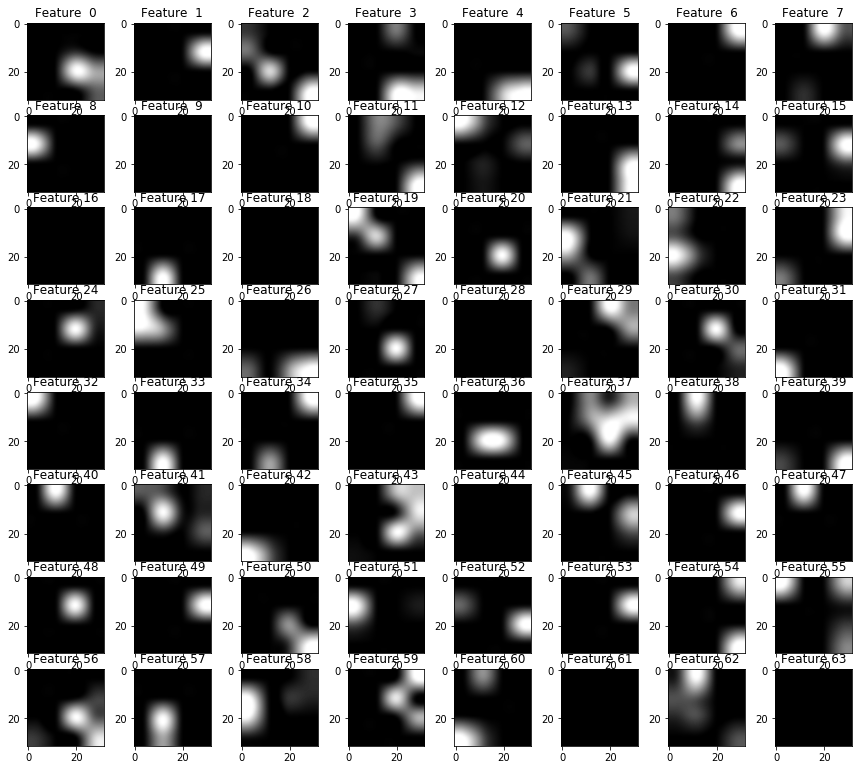

13 - Yield
    Predicted as: 13 - Yield


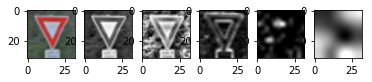

Layer 1


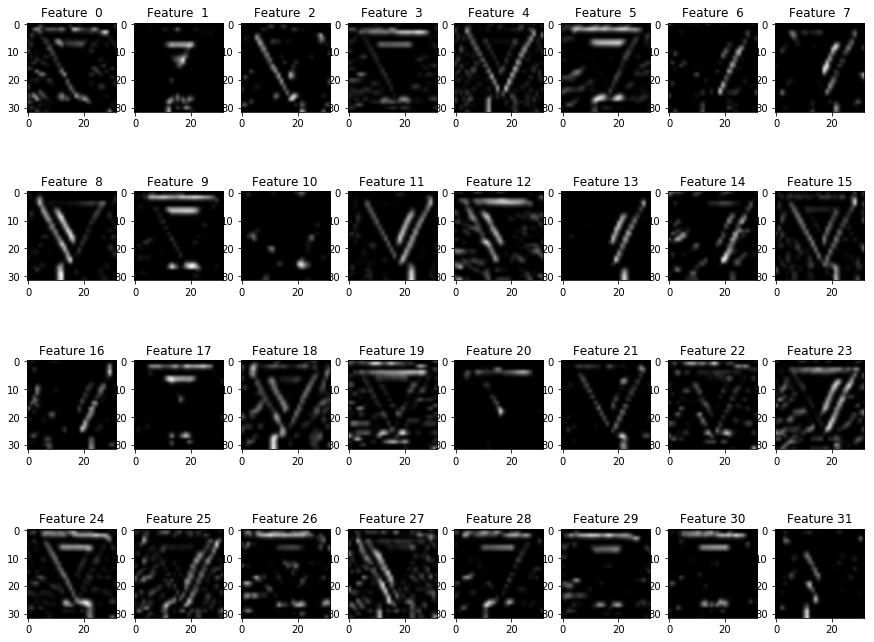

Layer 2


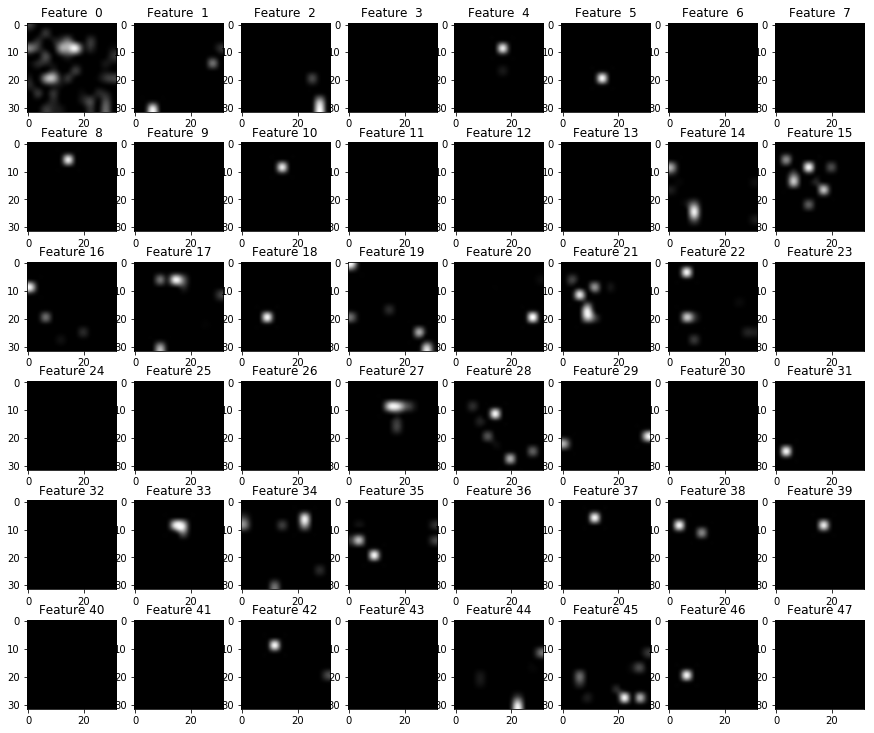

Layer 3


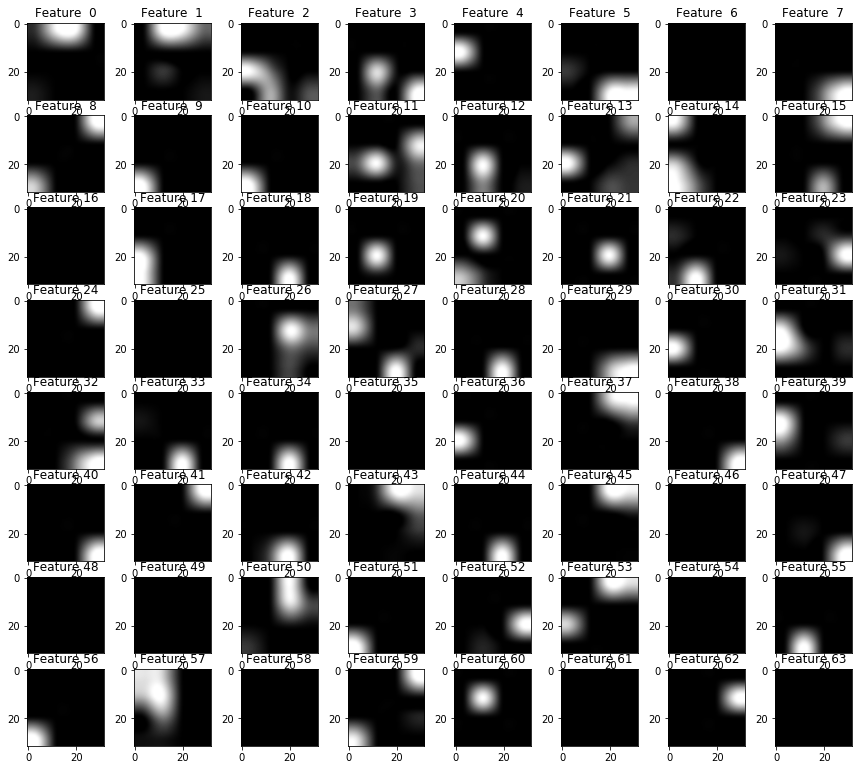

13 - Yield
    Predicted as: 36 - Go straight or right


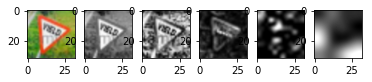

Layer 1


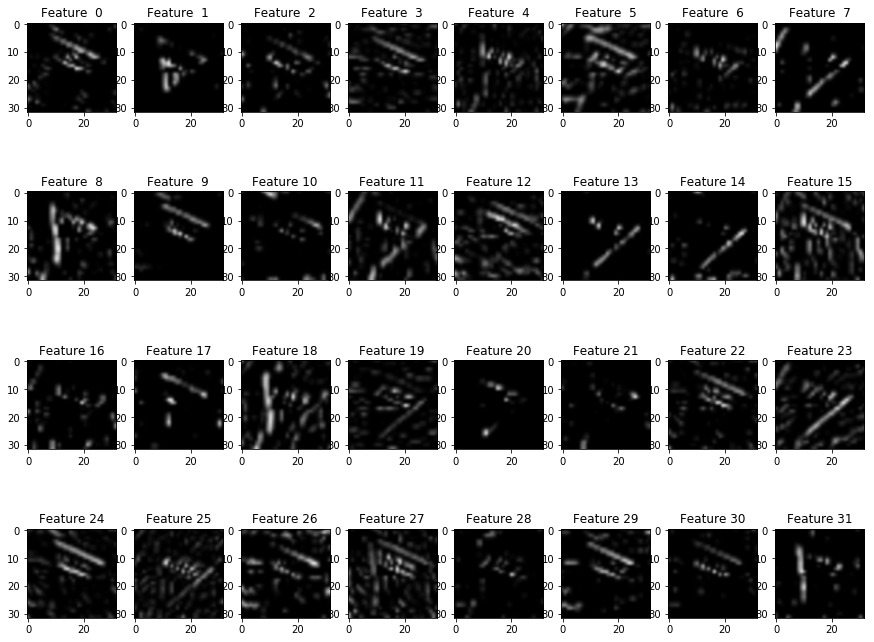

Layer 2


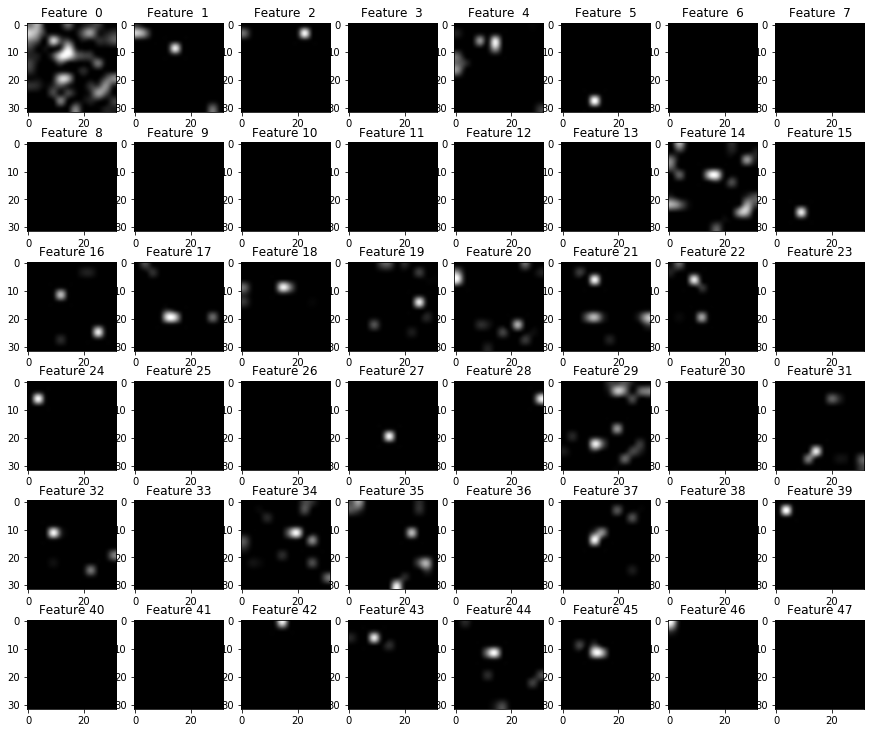

Layer 3


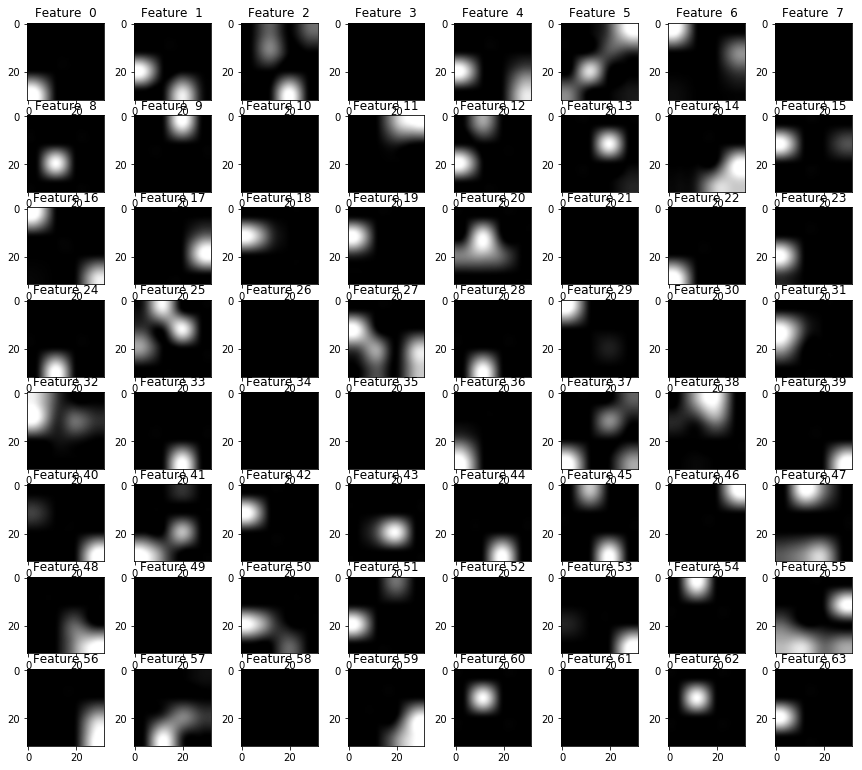

16 - Vehicles over 3.5 metric tons prohibited
    Predicted as: 40 - Roundabout mandatory


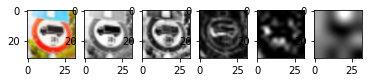

Layer 1


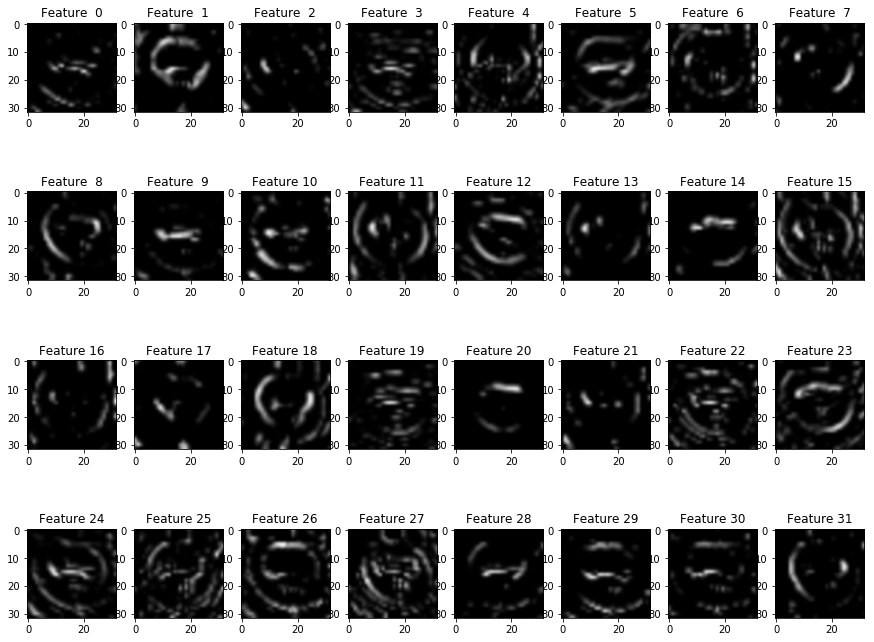

Layer 2


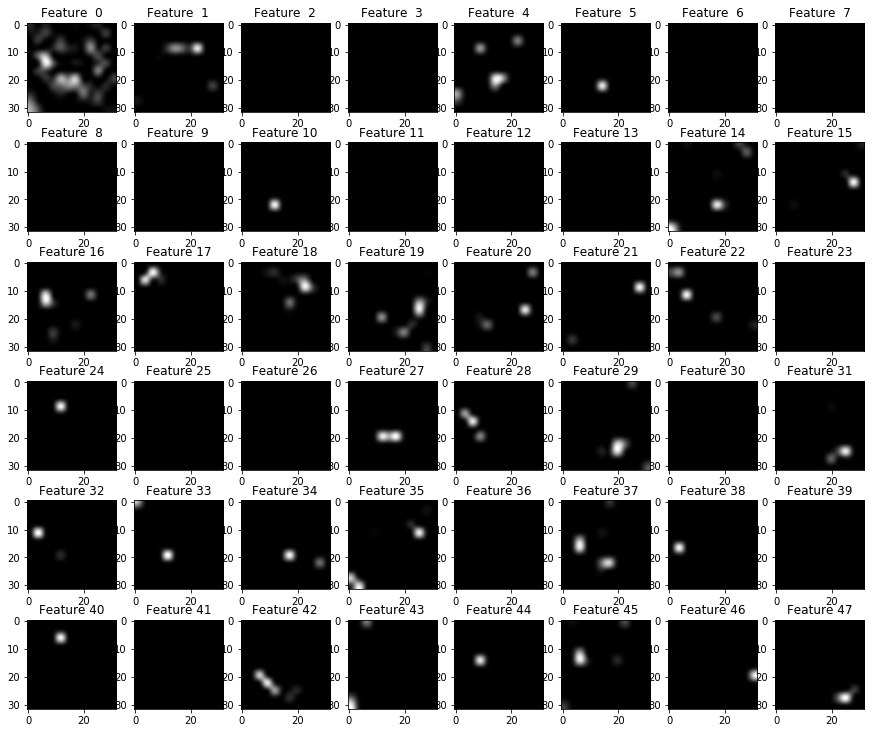

Layer 3


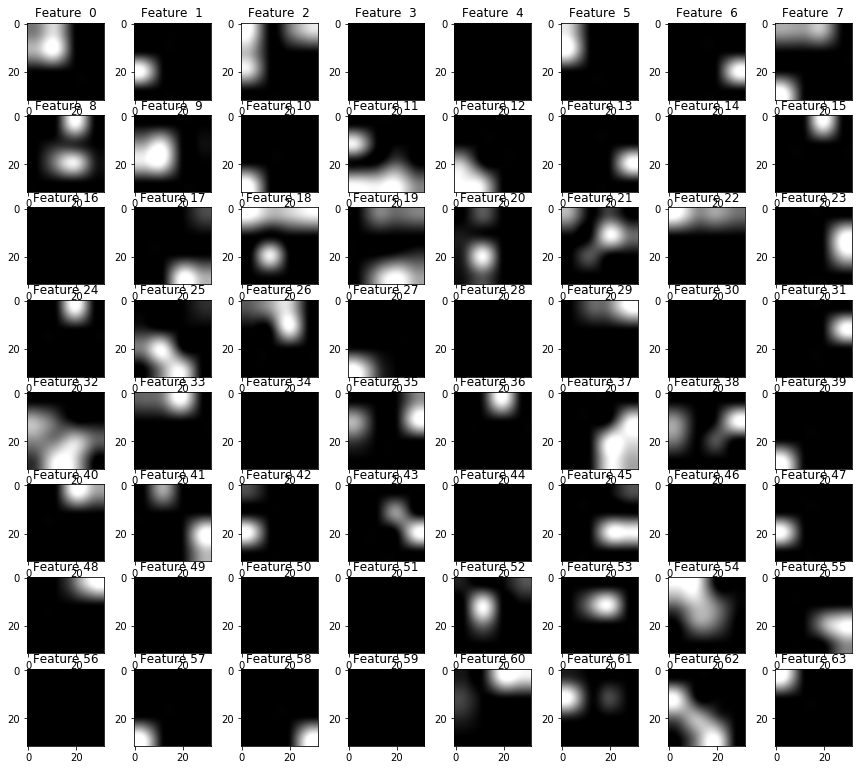

21 - Double curve
    Predicted as: 28 - Children crossing


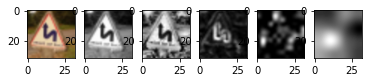

Layer 1


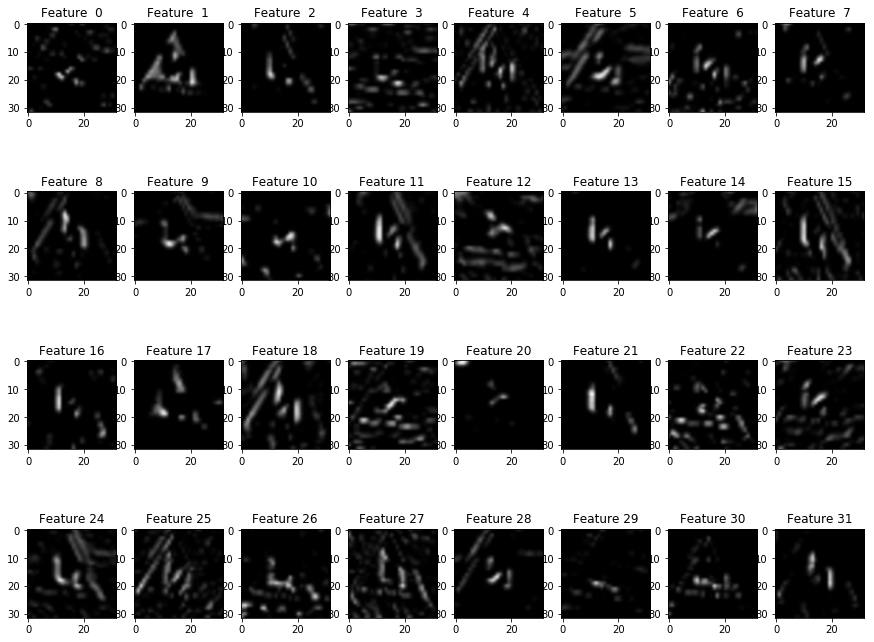

Layer 2


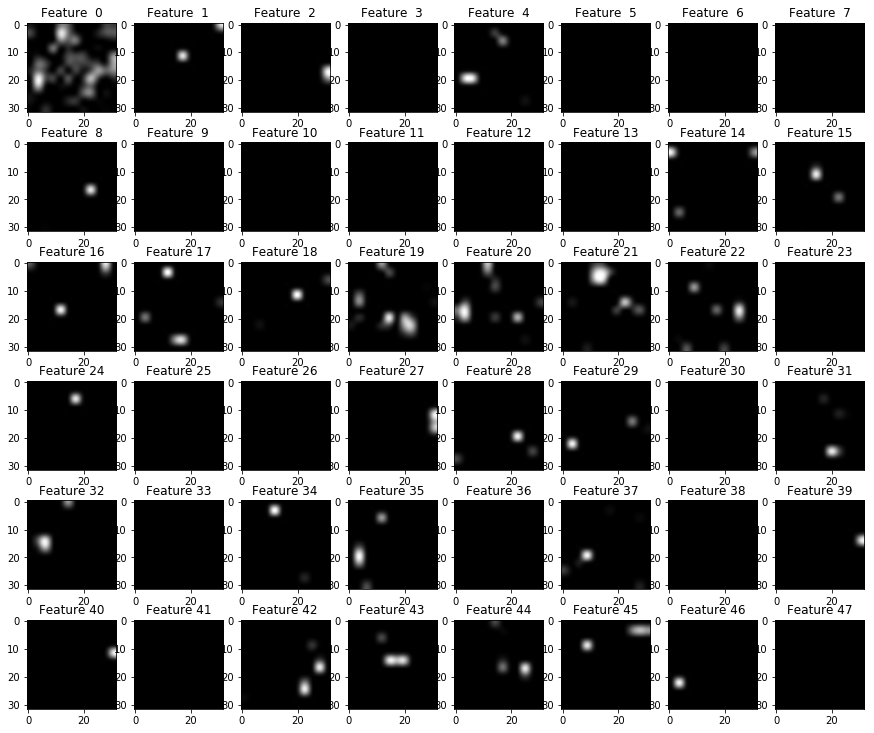

Layer 3


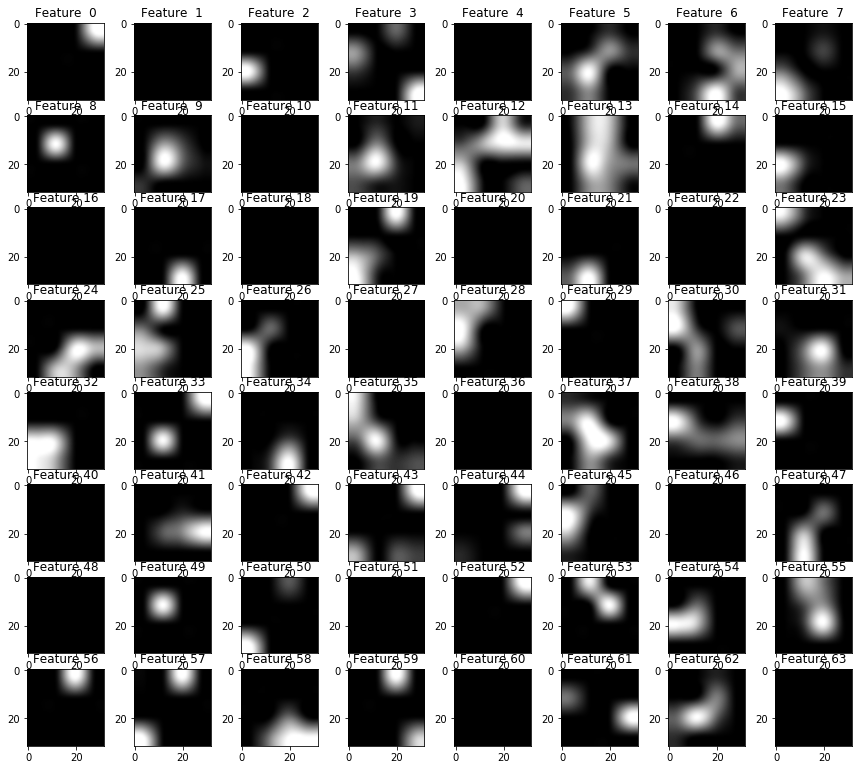

21 - Double curve
    Predicted as: 21 - Double curve


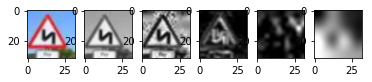

Layer 1


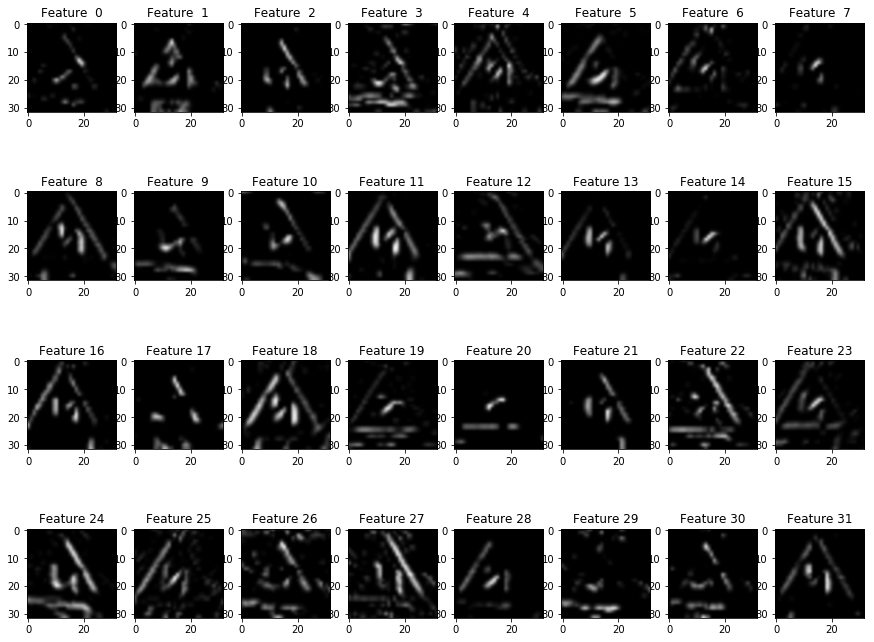

Layer 2


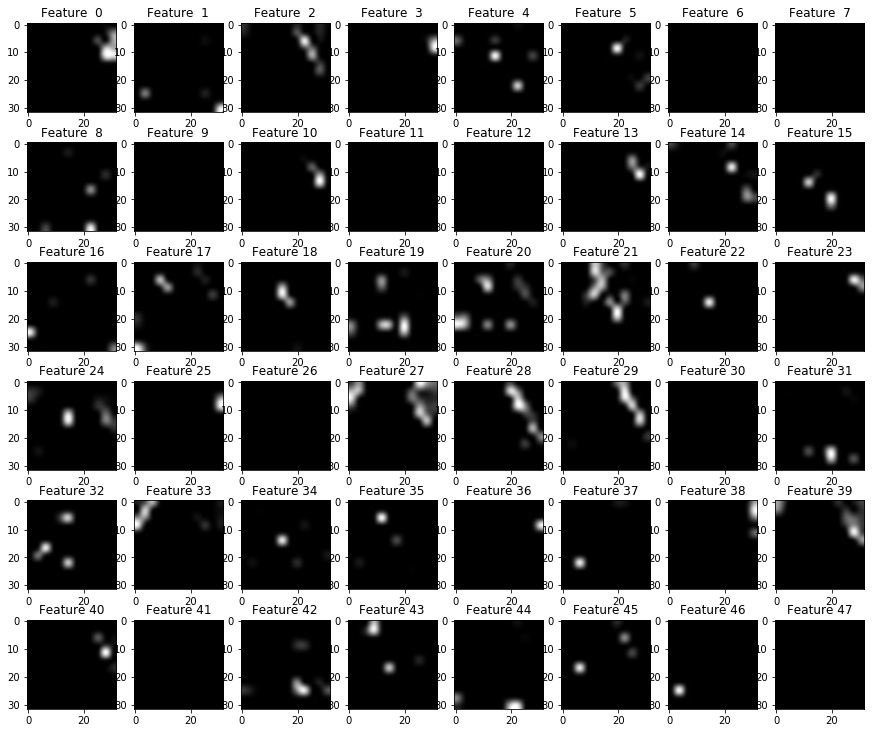

Layer 3


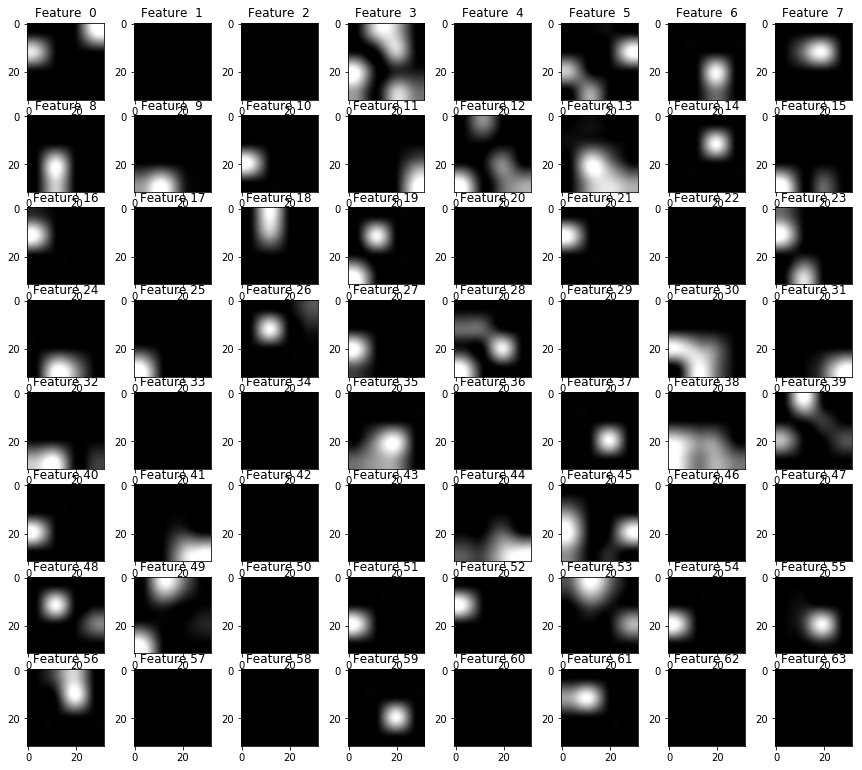

22 - Bumpy road
    Predicted as: 22 - Bumpy road


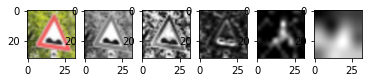

Layer 1


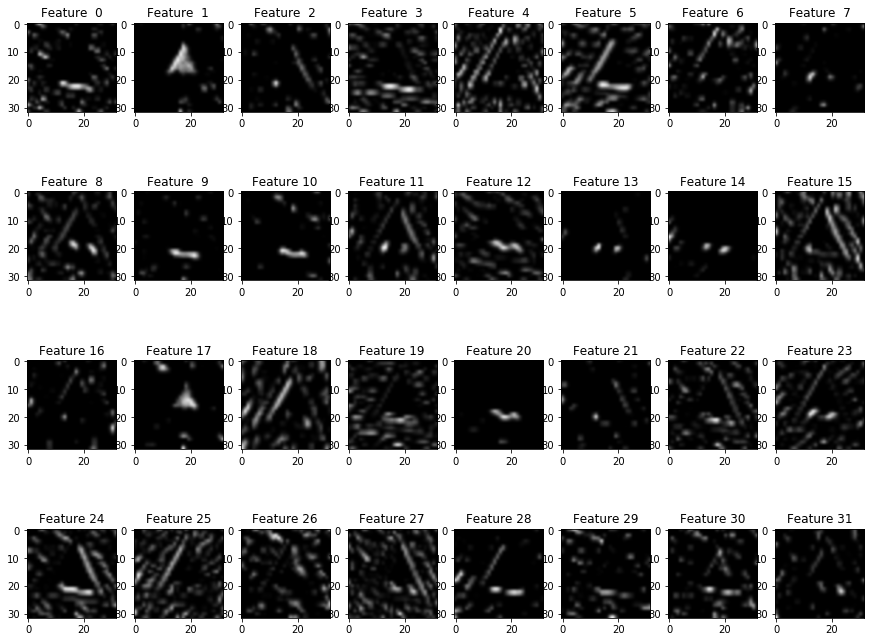

Layer 2


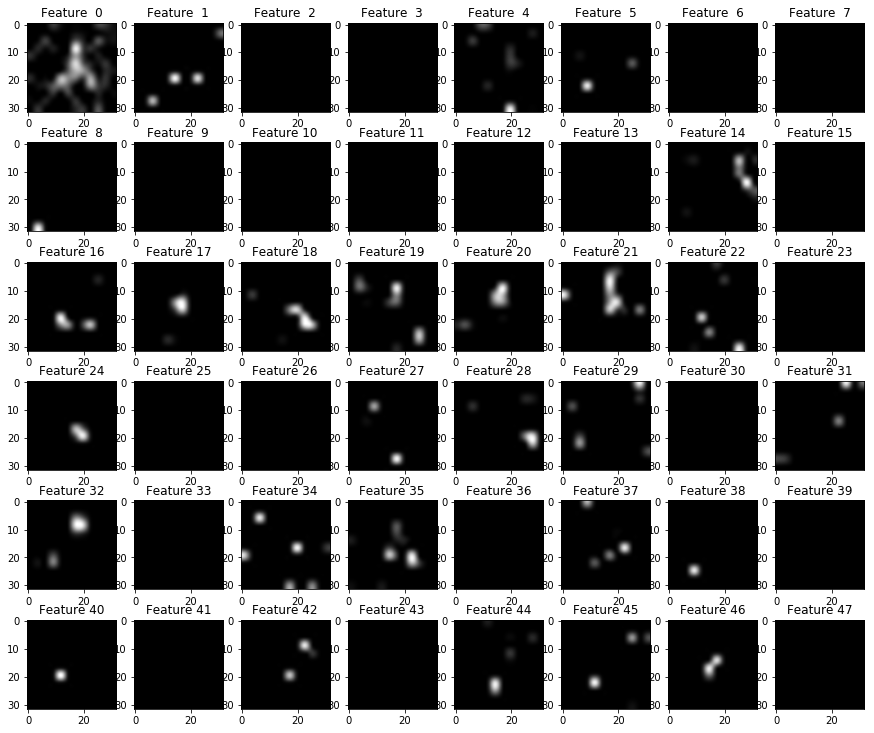

Layer 3


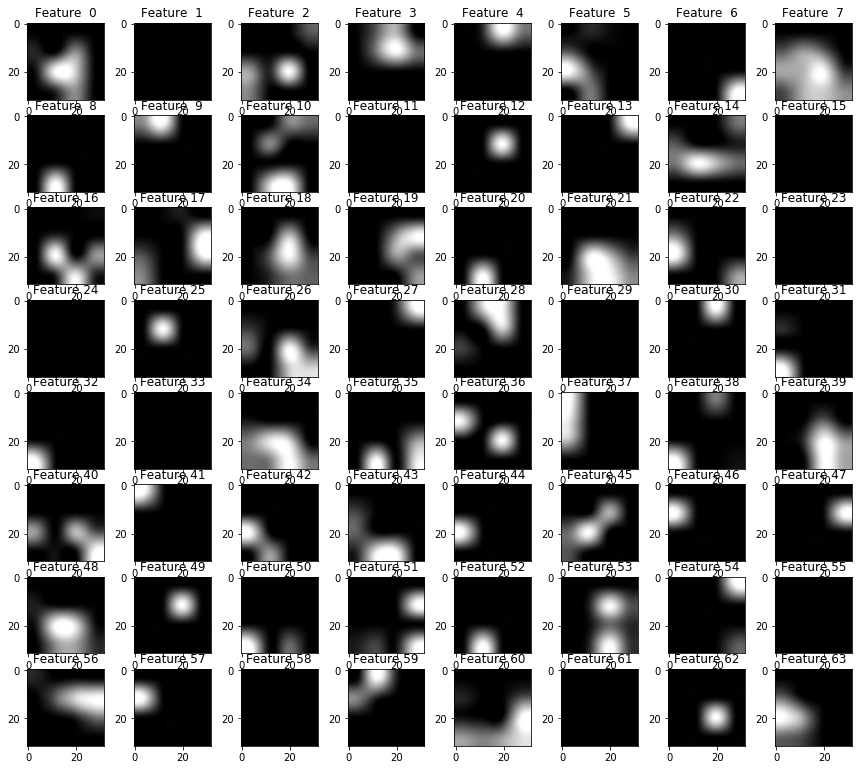

22 - Bumpy road
    Predicted as: 22 - Bumpy road


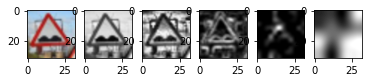

Layer 1


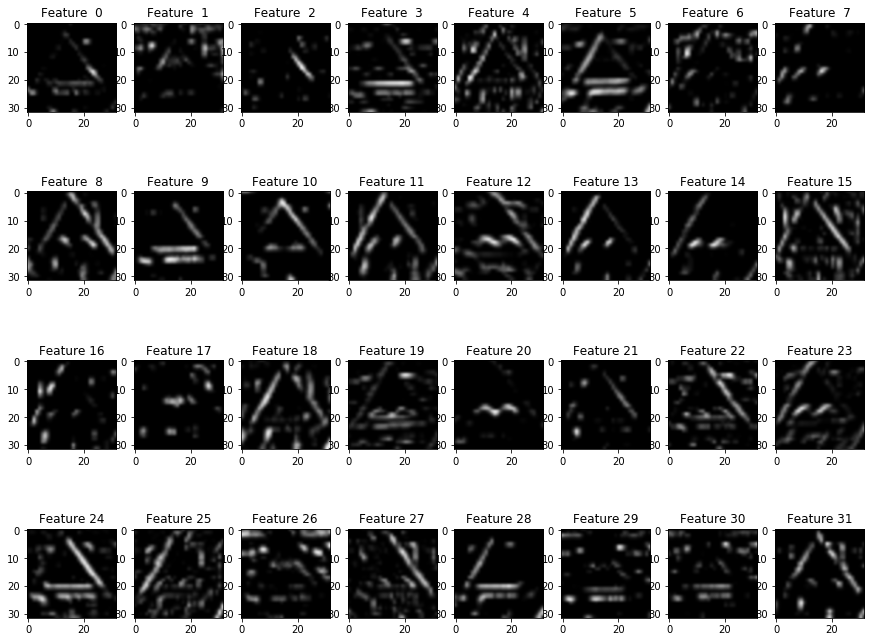

Layer 2


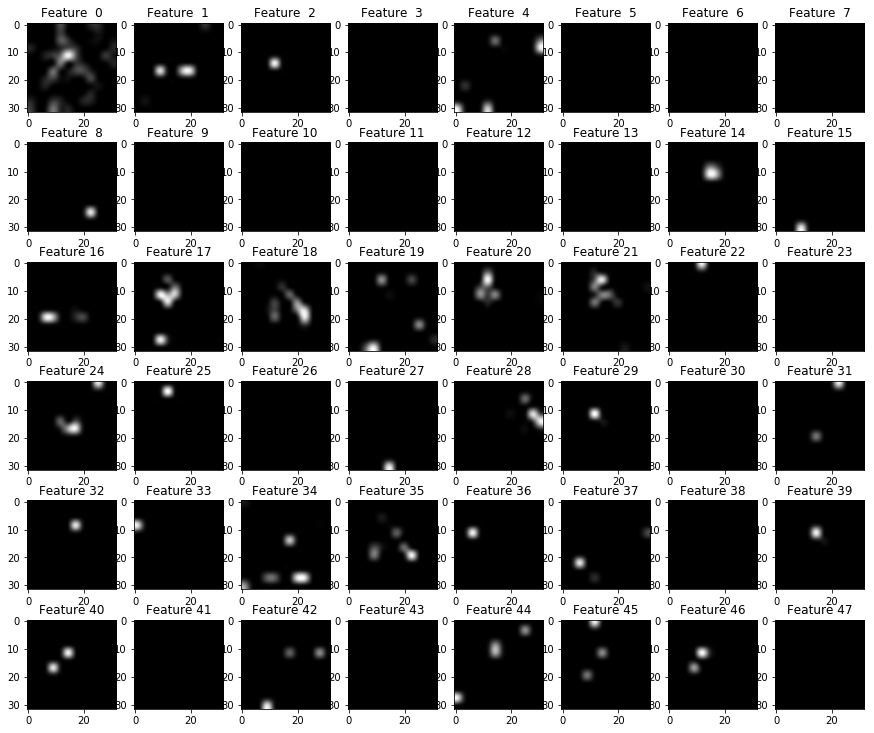

Layer 3


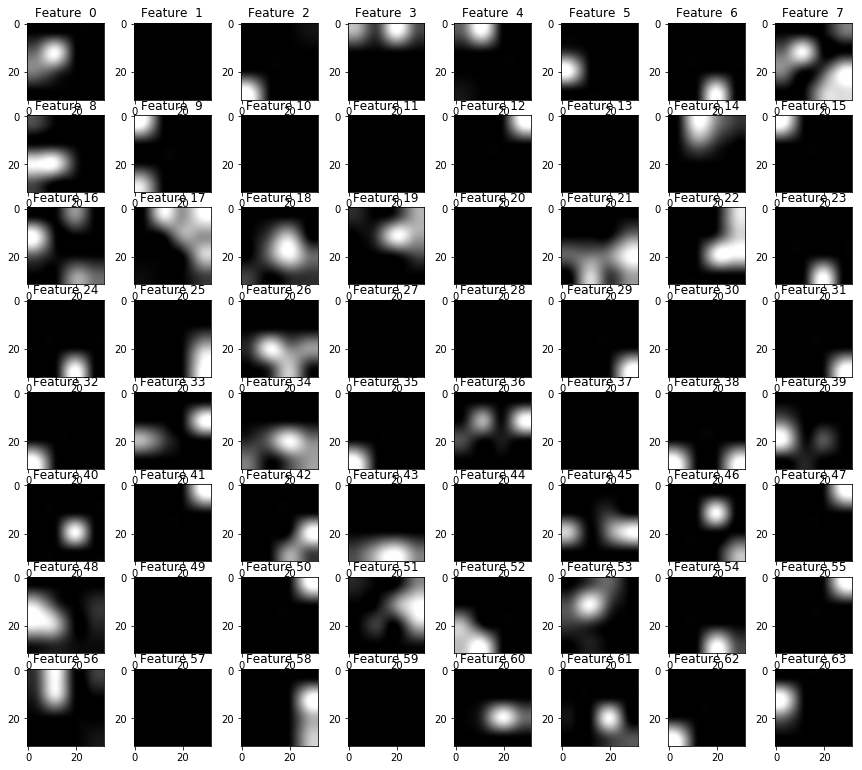

23 - Slippery road
    Predicted as: 23 - Slippery road


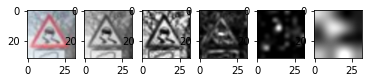

Layer 1


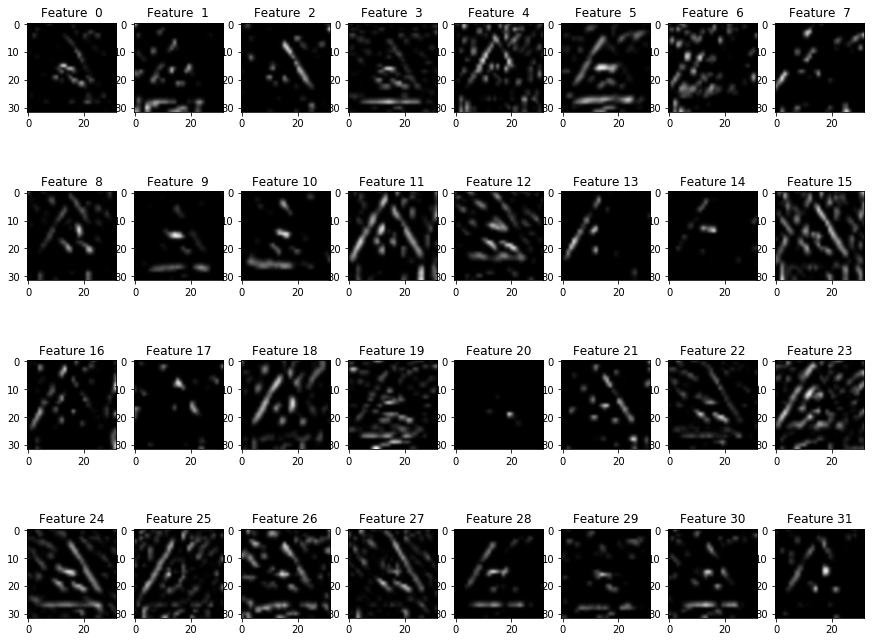

Layer 2


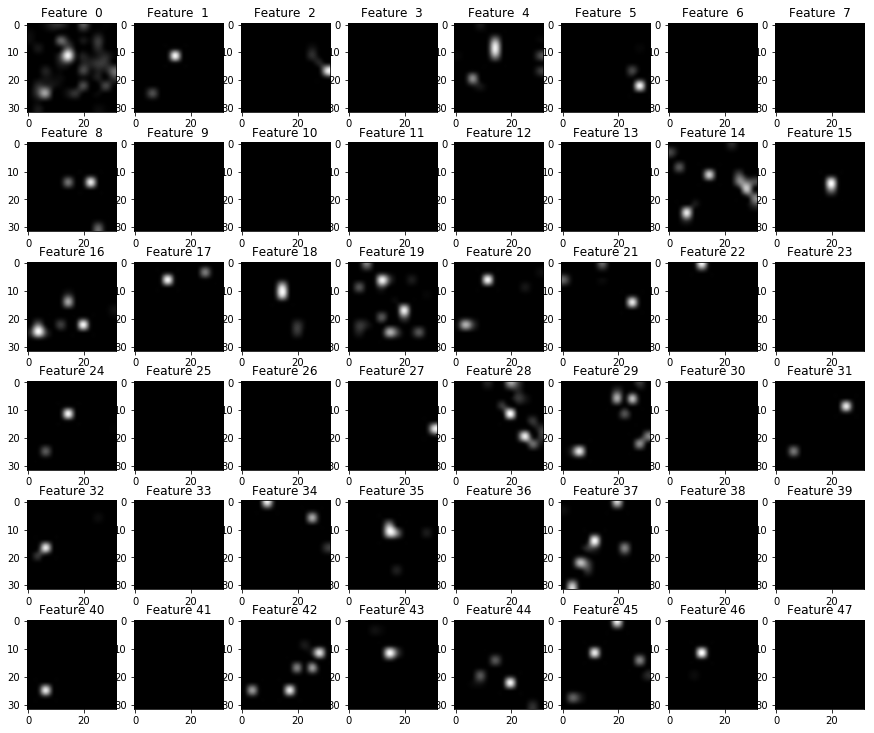

Layer 3


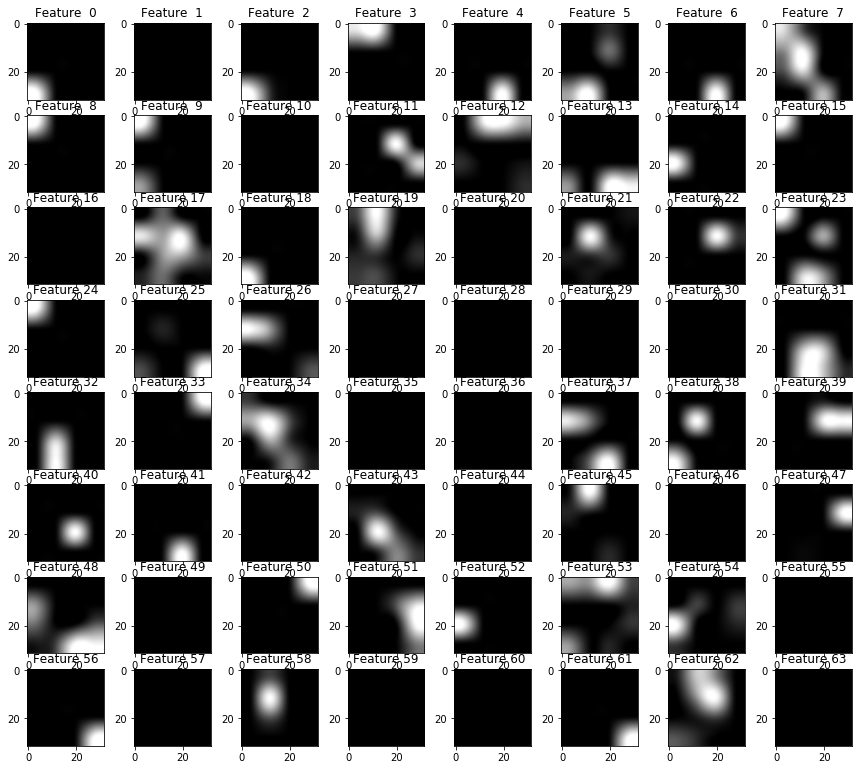

23 - Slippery road
    Predicted as: 29 - Bicycles crossing


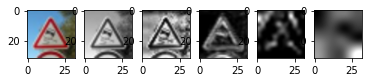

Layer 1


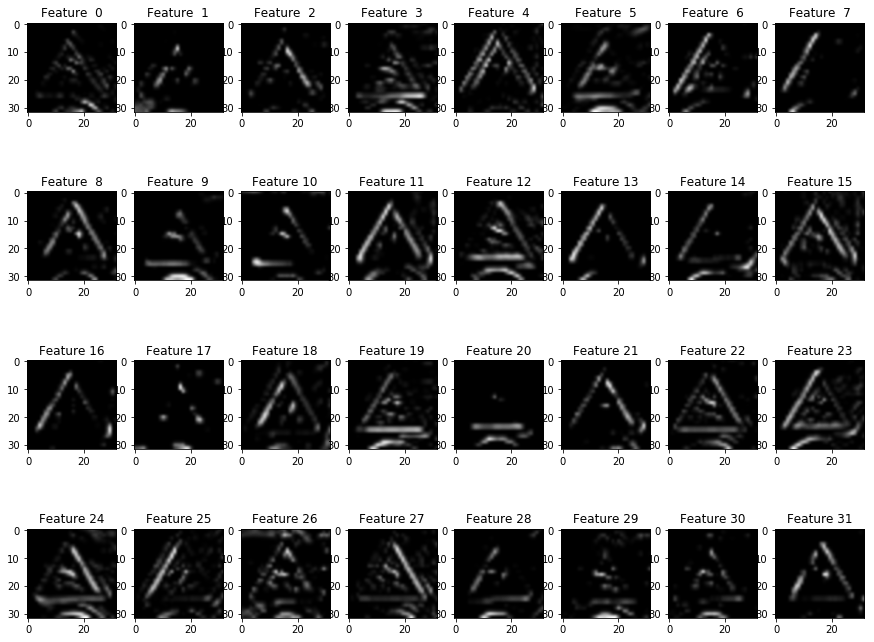

Layer 2


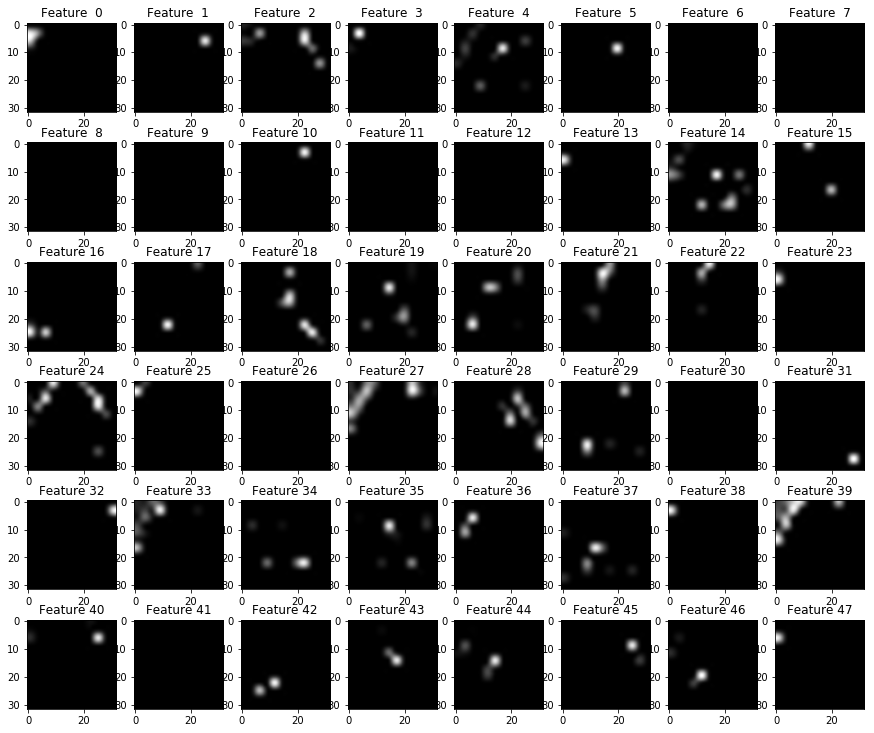

Layer 3


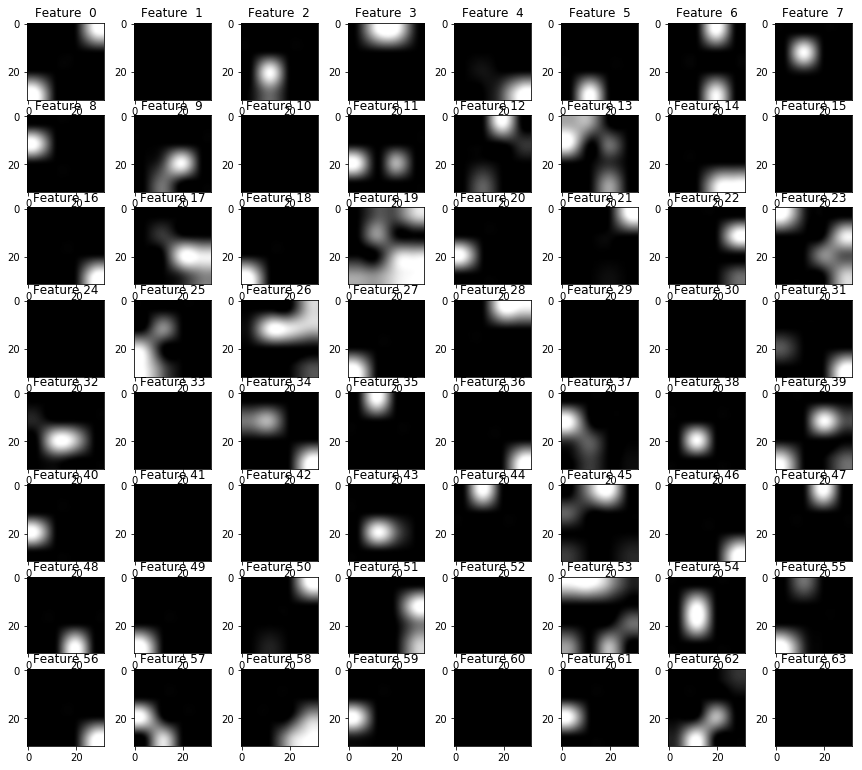

23 - Slippery road
    Predicted as: 23 - Slippery road


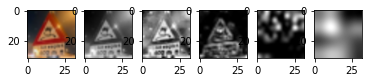

Layer 1


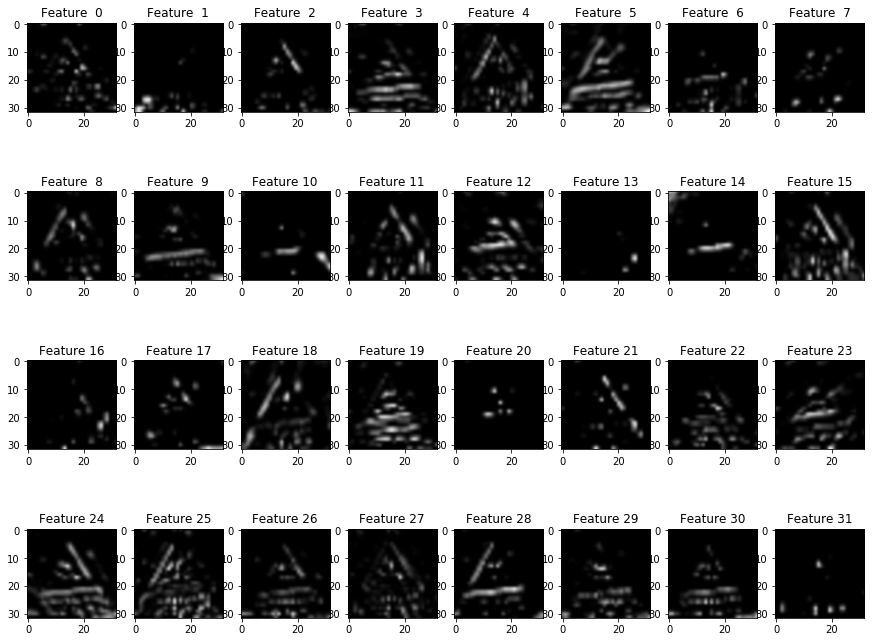

Layer 2


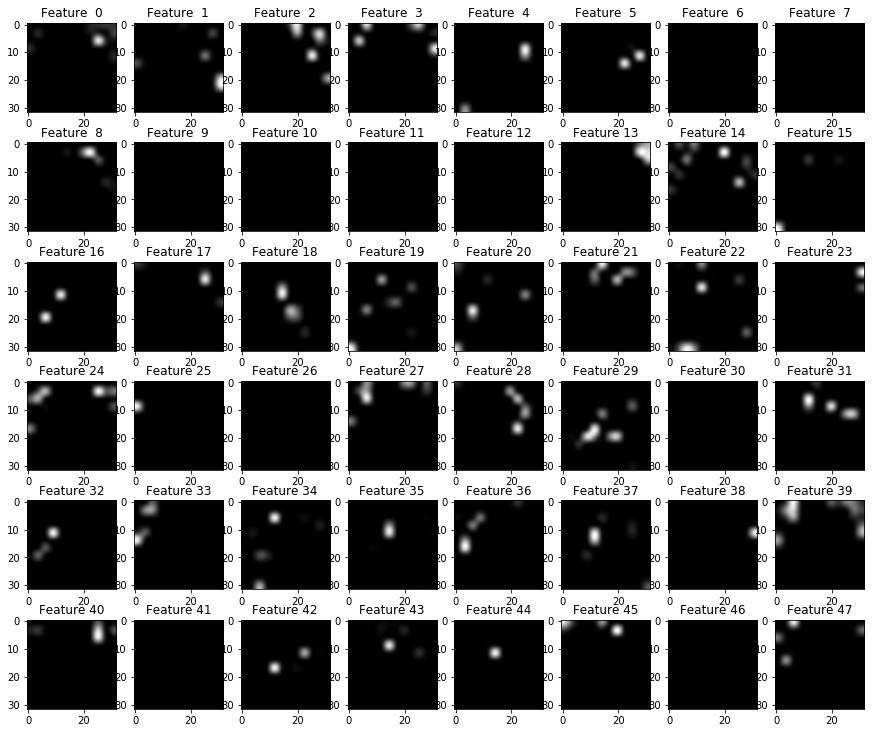

Layer 3


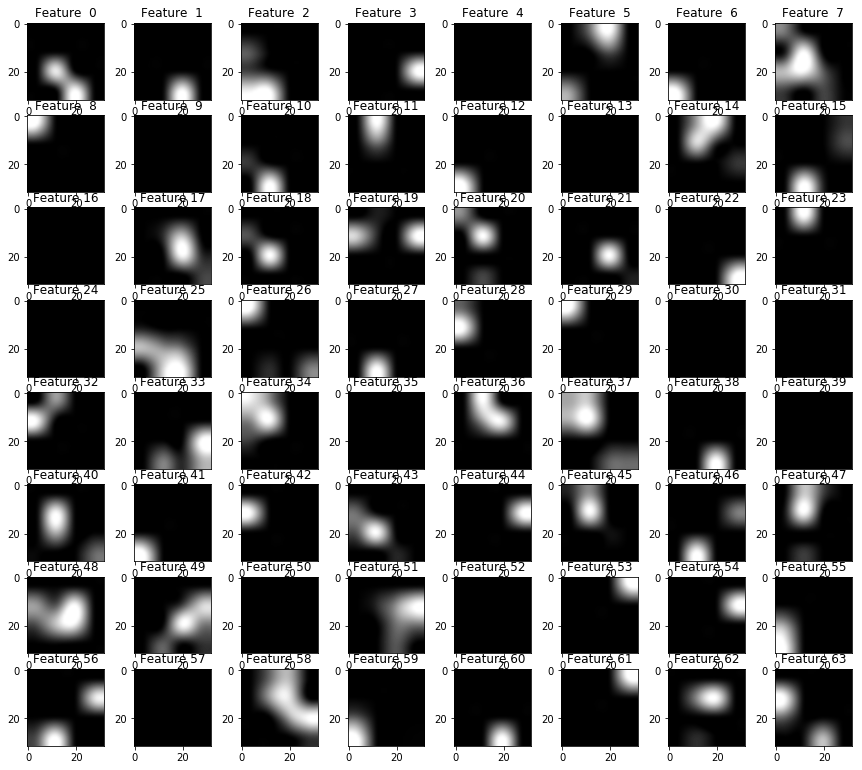

23 - Slippery road
    Predicted as: 23 - Slippery road


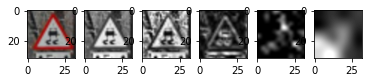

Layer 1


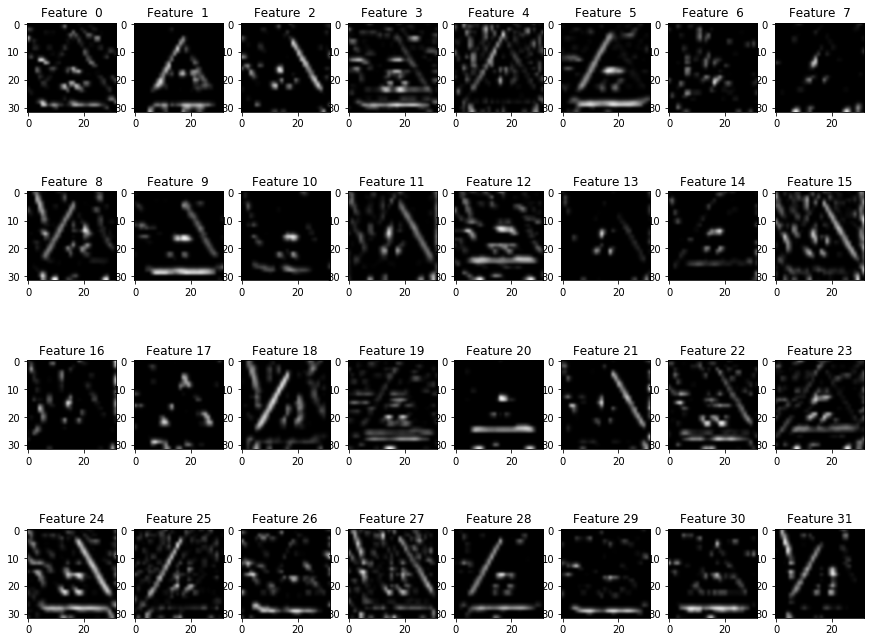

Layer 2


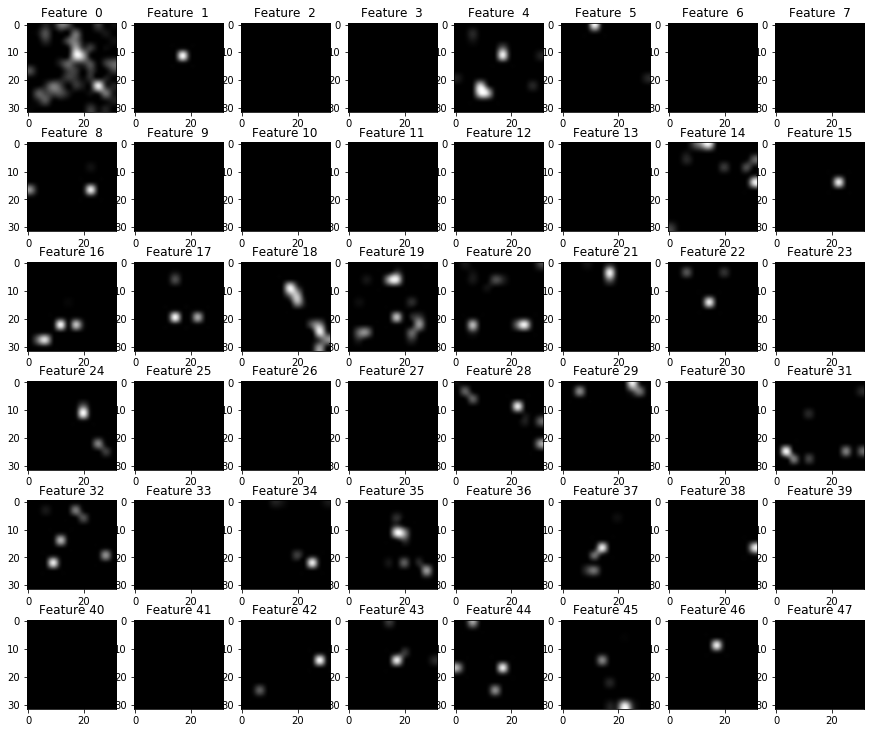

Layer 3


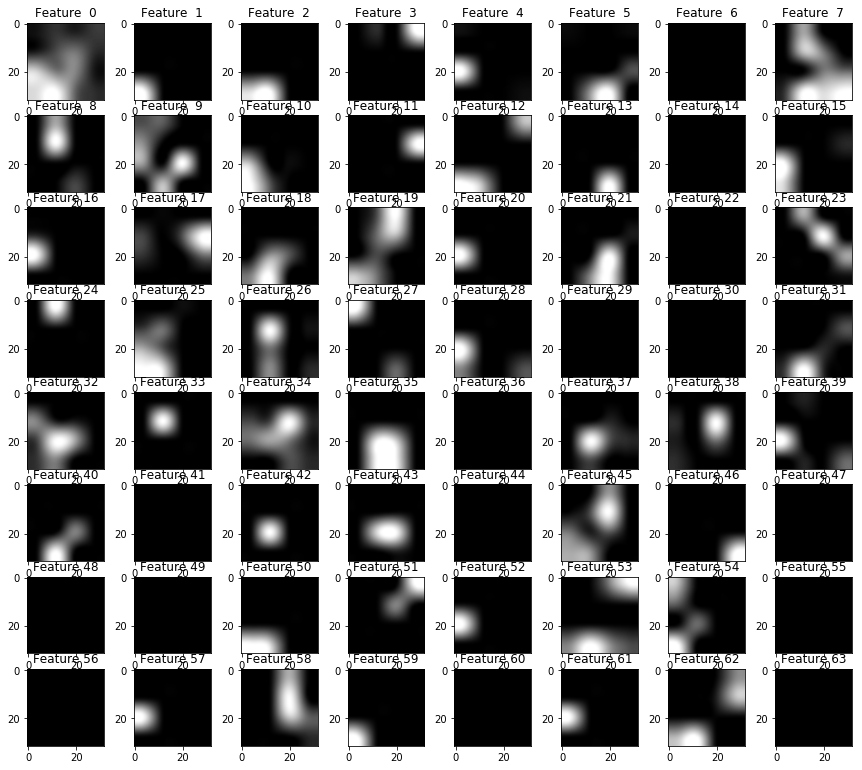

40 - Roundabout mandatory
    Predicted as: 40 - Roundabout mandatory


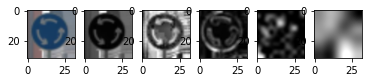

Layer 1


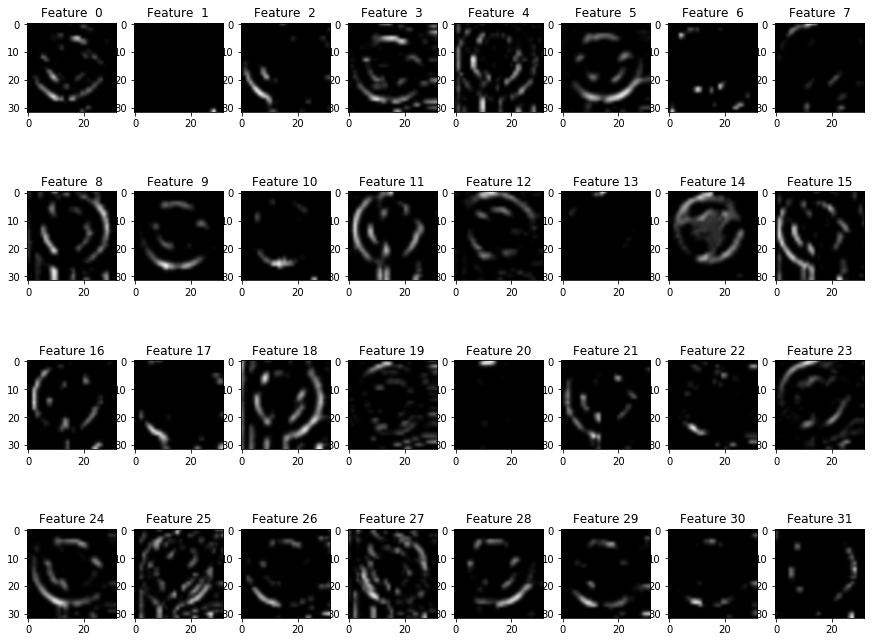

Layer 2


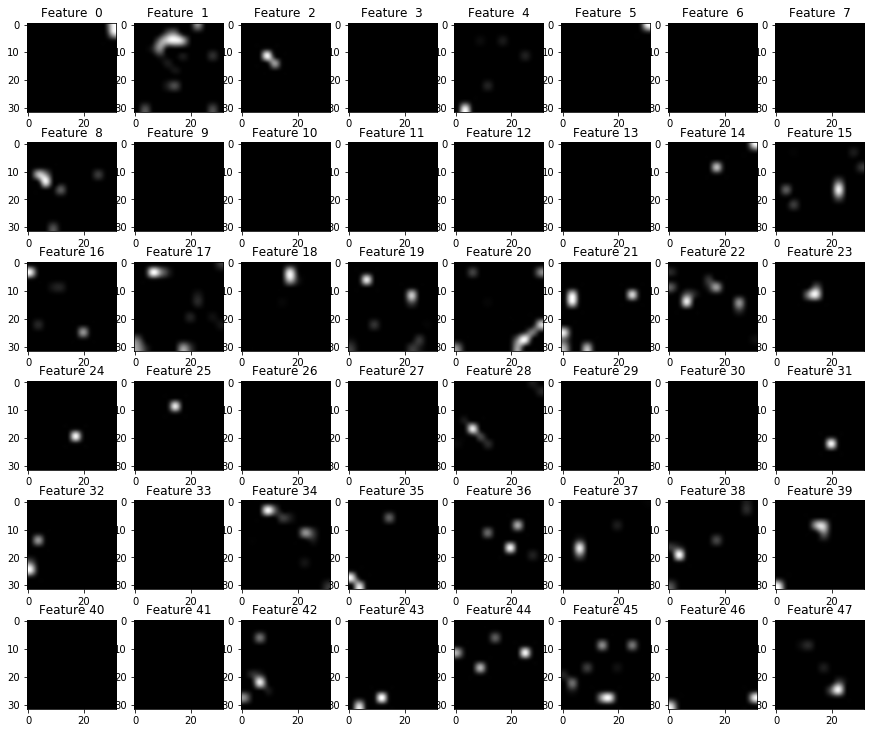

Layer 3


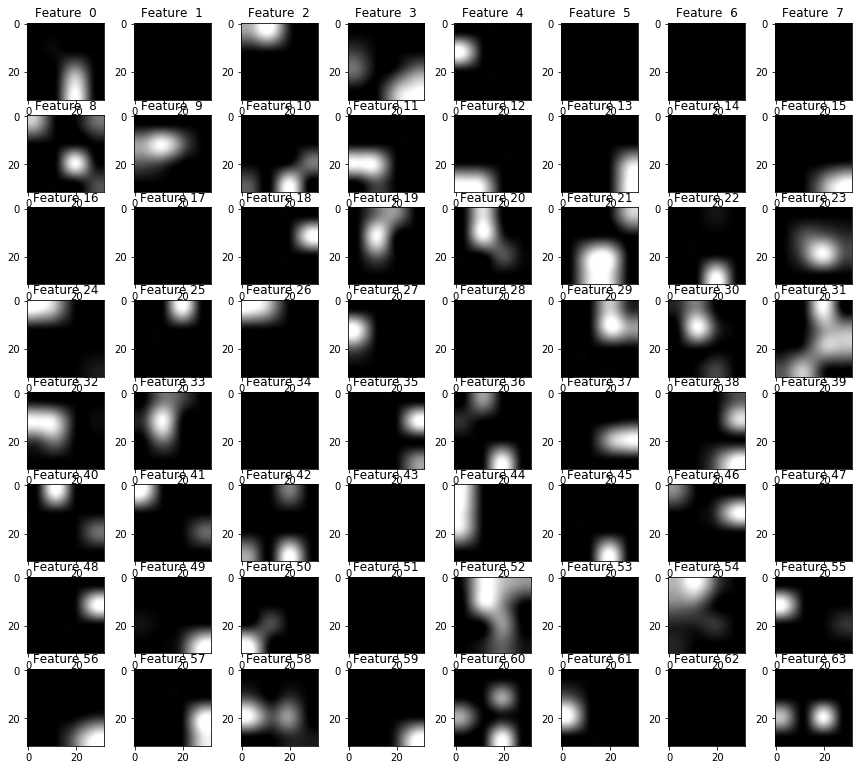

40 - Roundabout mandatory
    Predicted as: 40 - Roundabout mandatory


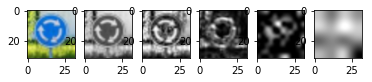

Layer 1


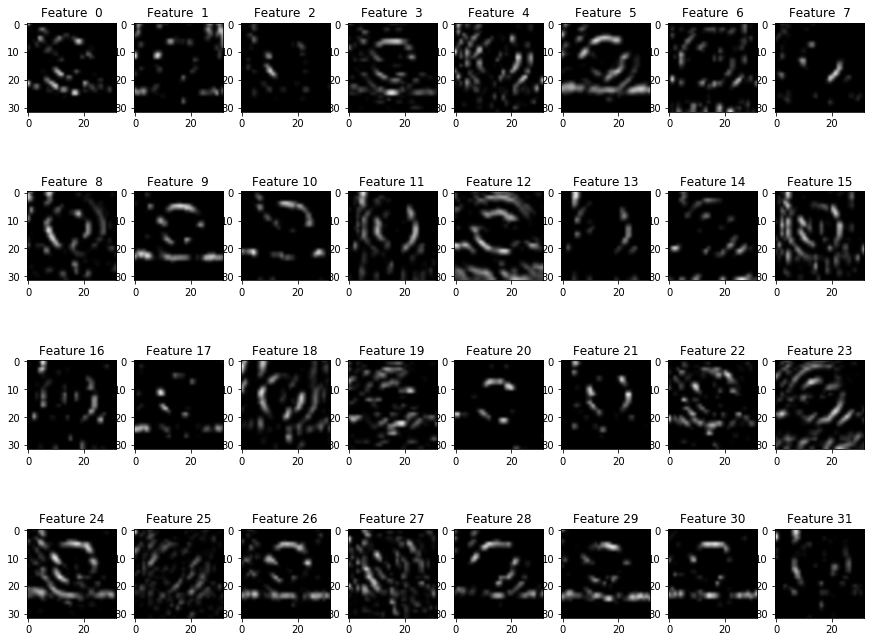

Layer 2


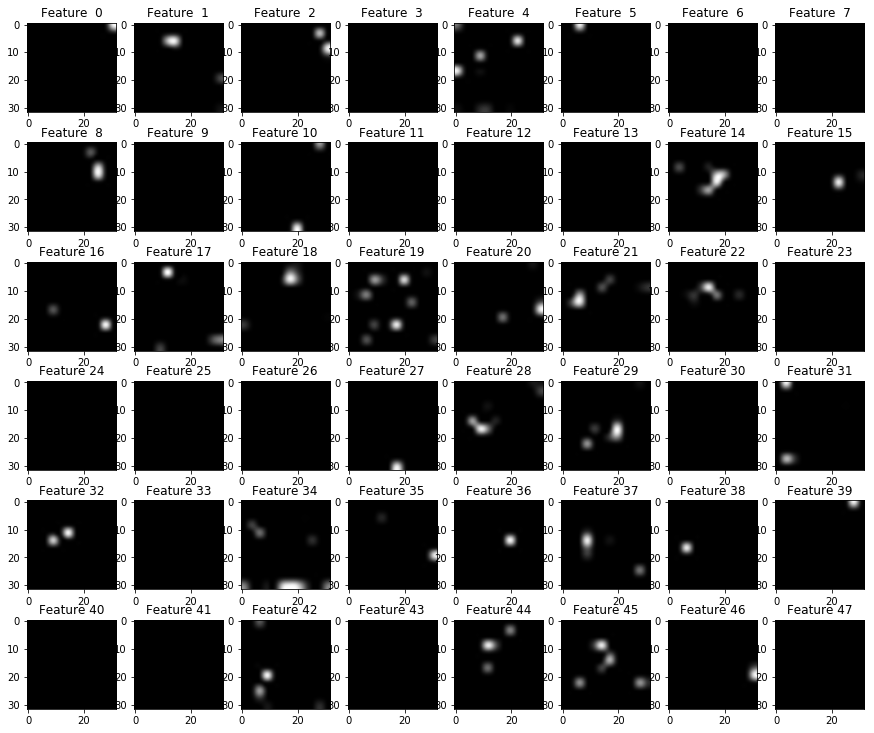

Layer 3


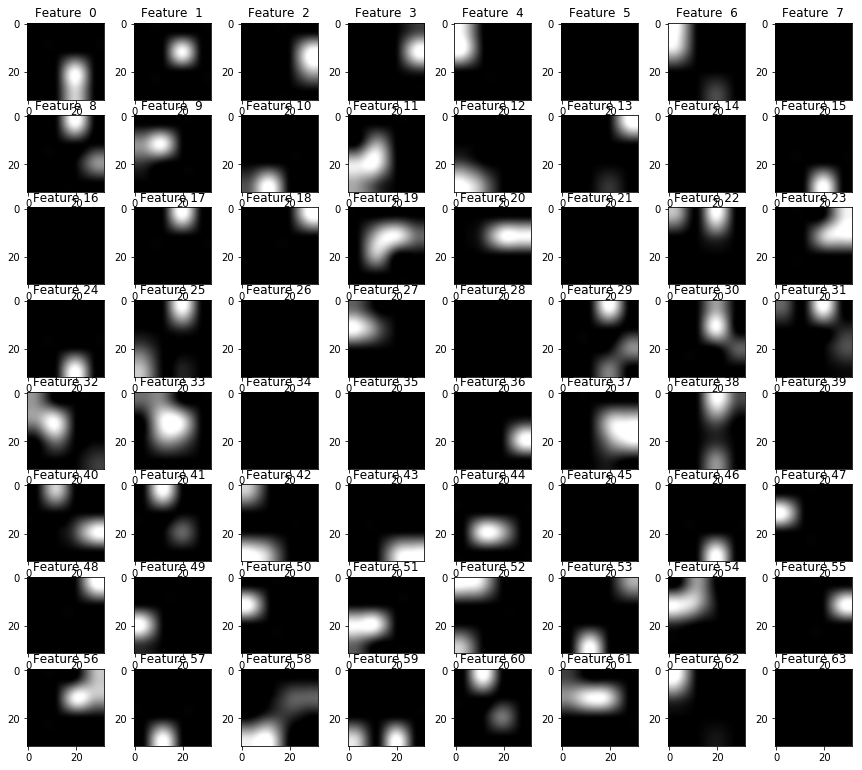

40 - Roundabout mandatory
    Predicted as: 7 - Speed limit (100km/h)


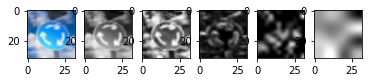

Layer 1


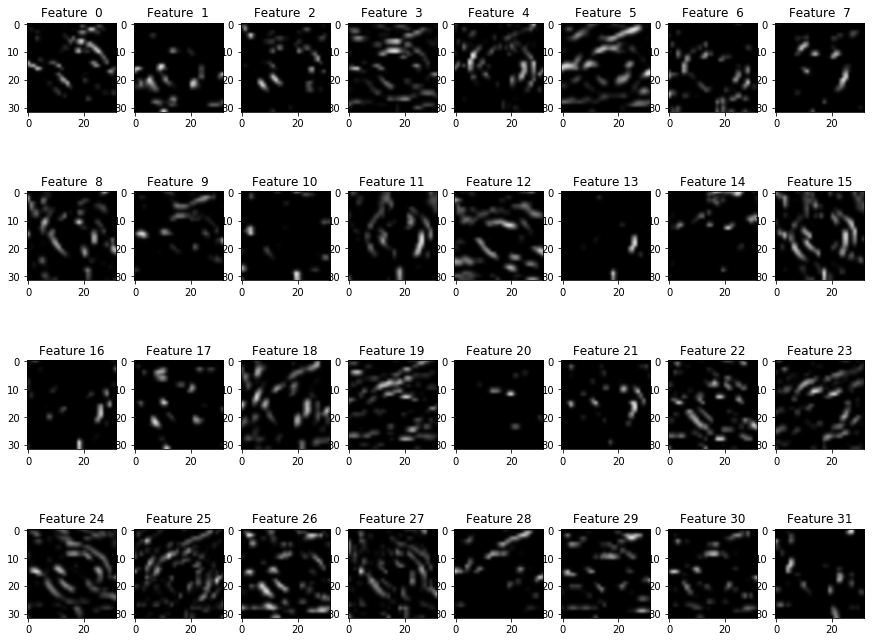

Layer 2


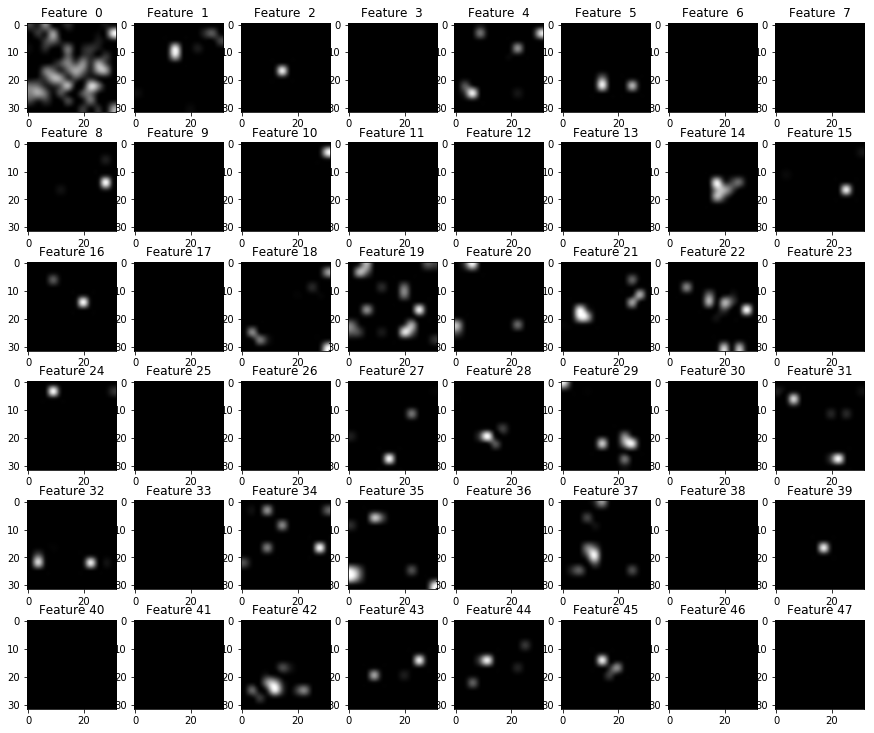

Layer 3


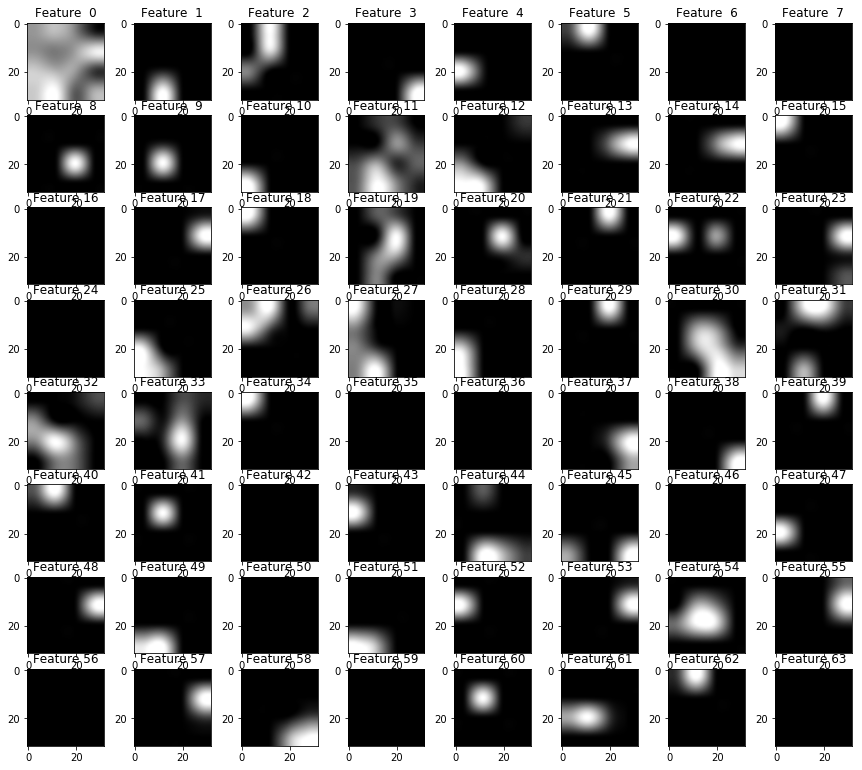

40 - Roundabout mandatory
    Predicted as: 40 - Roundabout mandatory


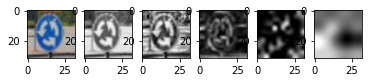

Layer 1


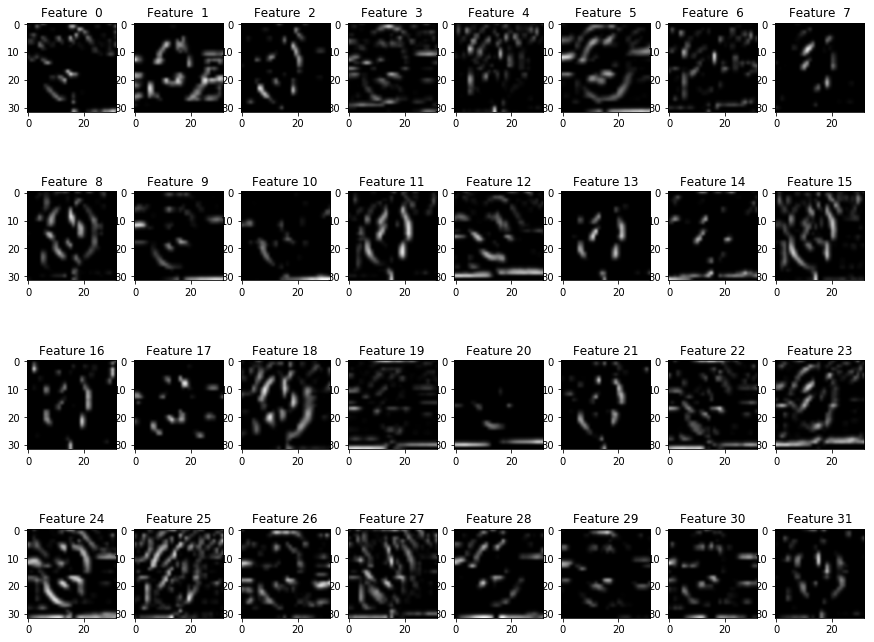

Layer 2


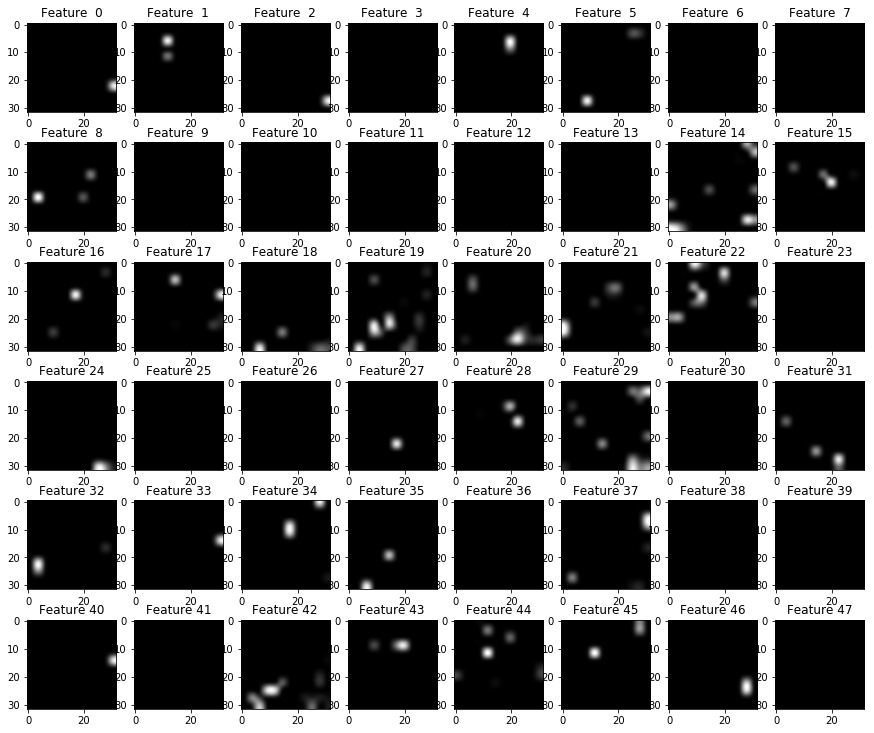

Layer 3


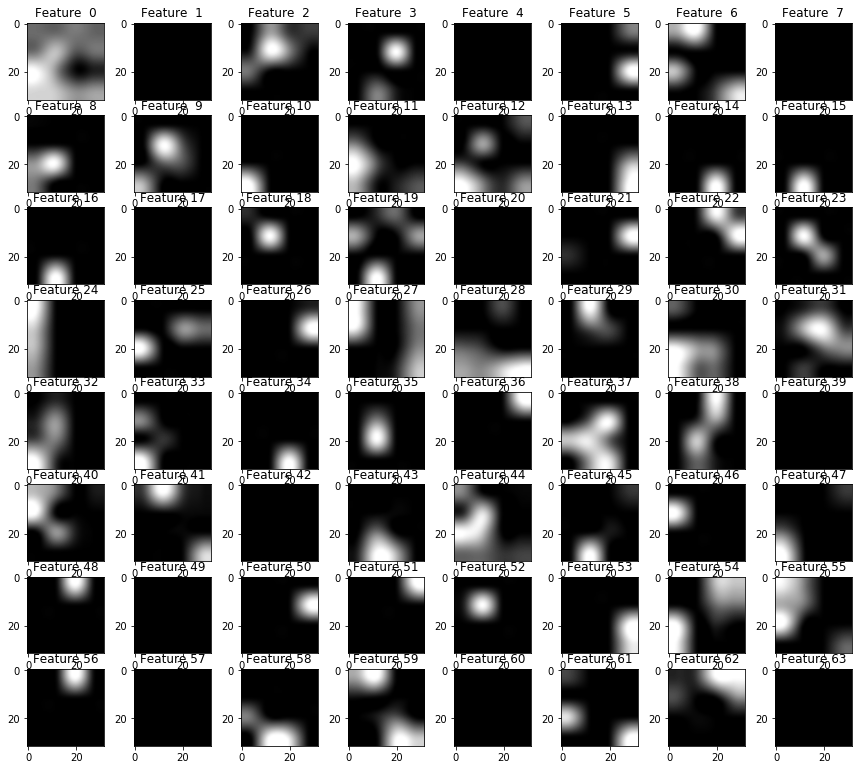

41 - End of no passing
    Predicted as: 41 - End of no passing


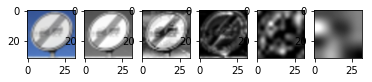

Layer 1


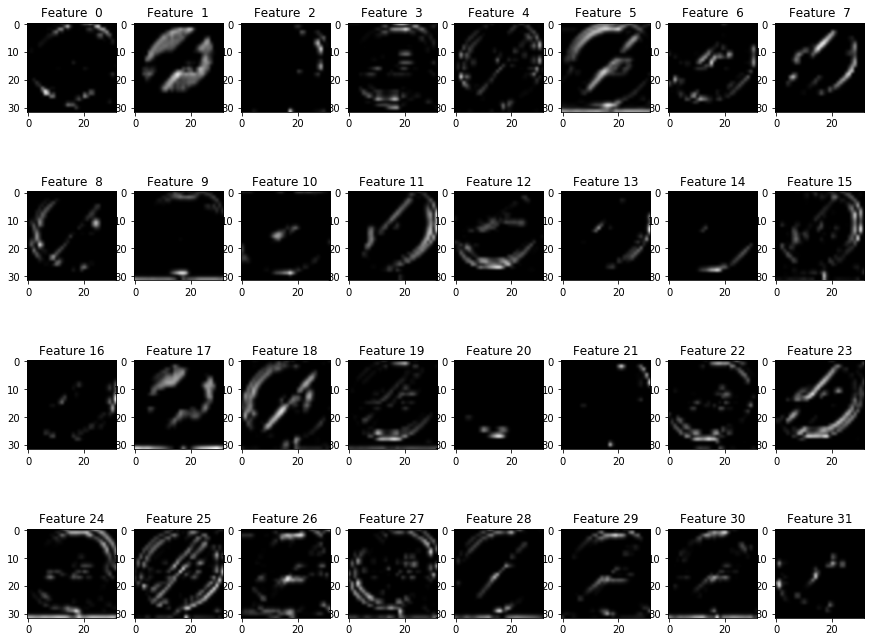

Layer 2


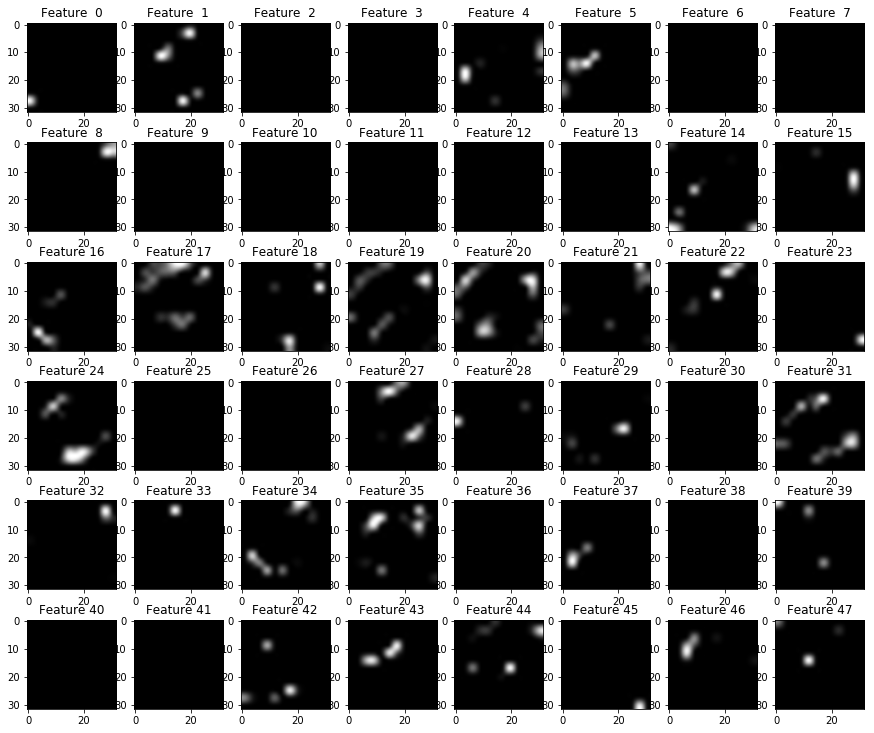

Layer 3


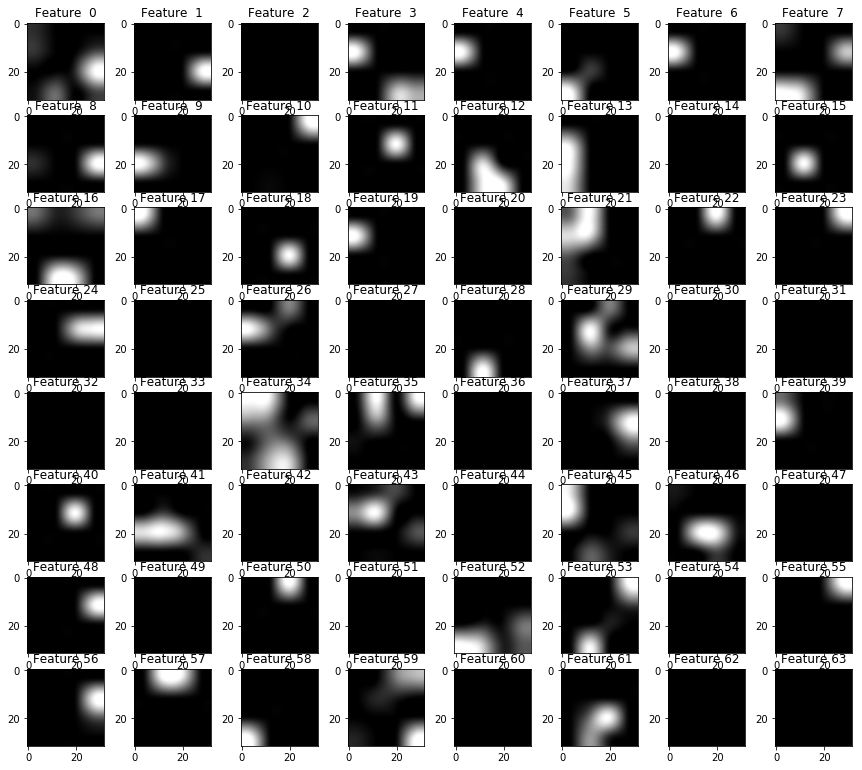

17 - No entry
    Predicted as: 7 - Speed limit (100km/h)


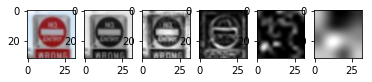

Layer 1


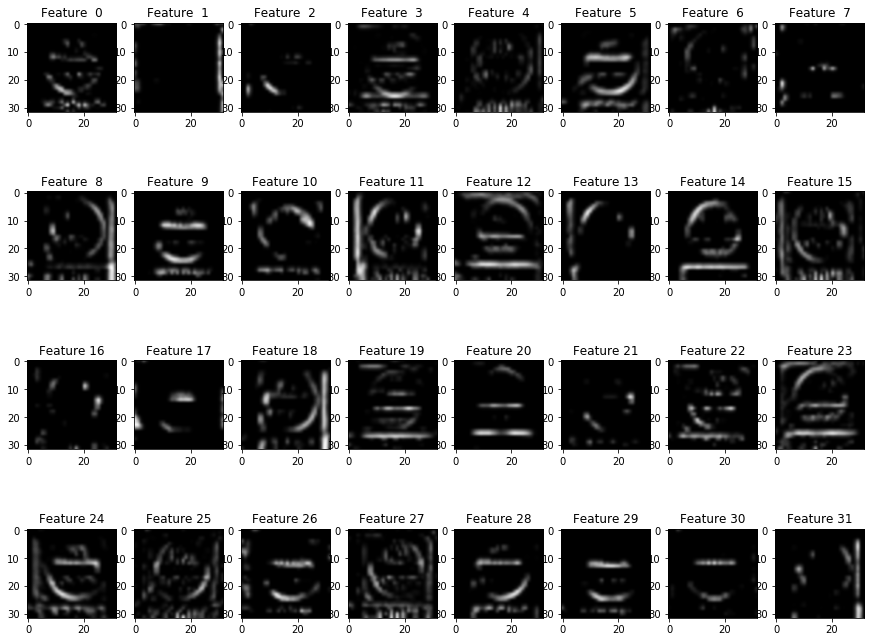

Layer 2


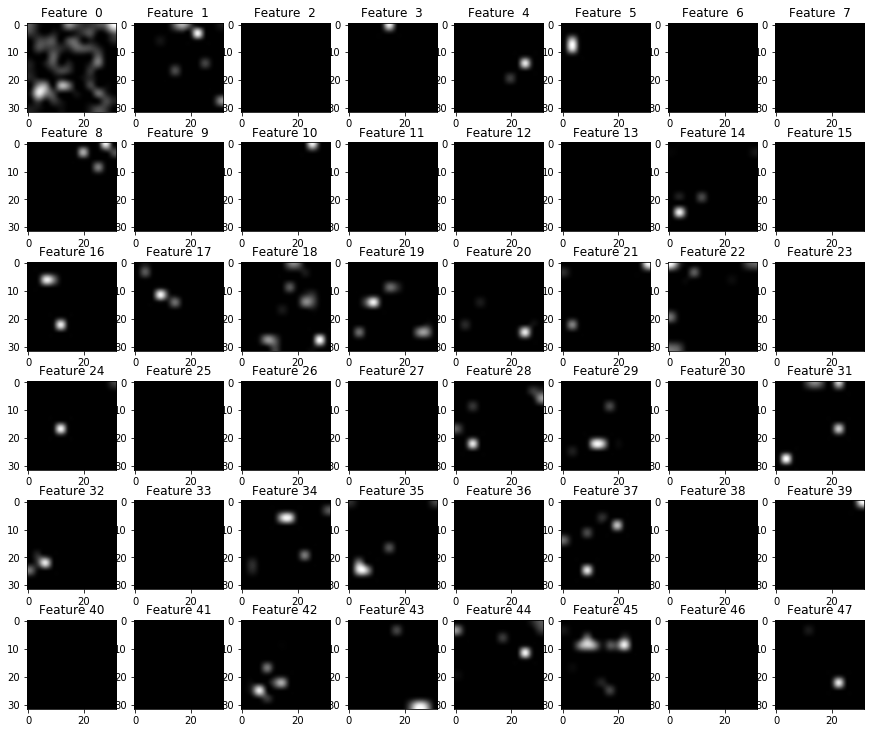

Layer 3


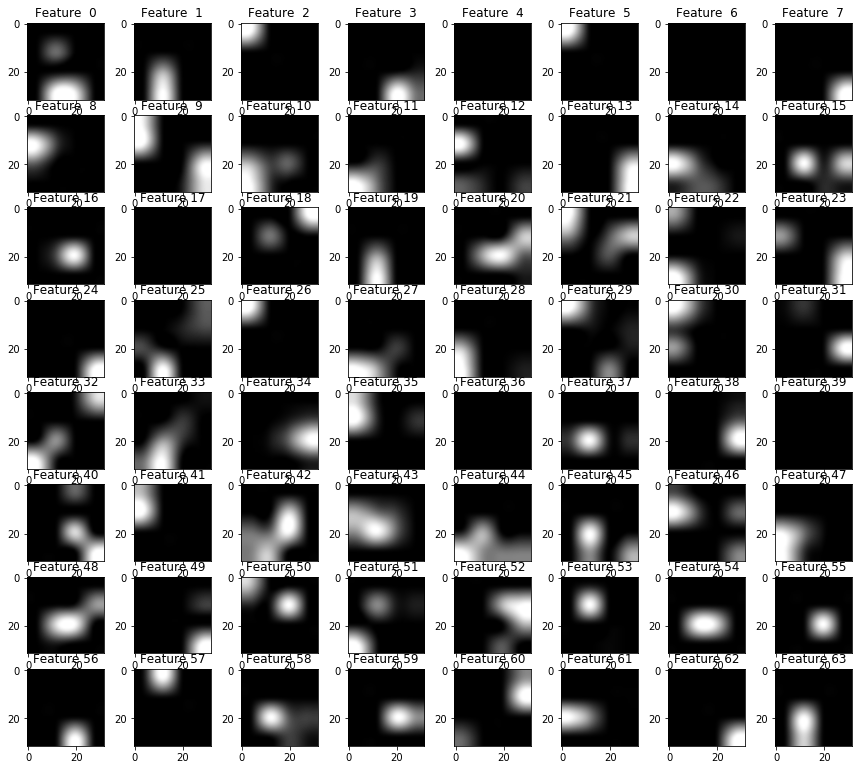

17 - No entry
    Predicted as: 17 - No entry


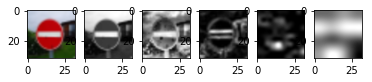

Layer 1


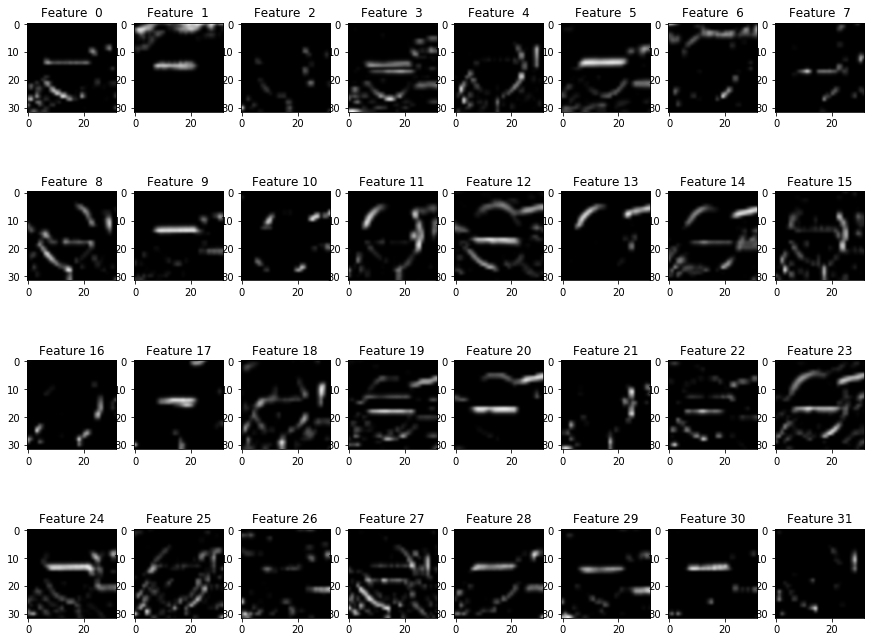

Layer 2


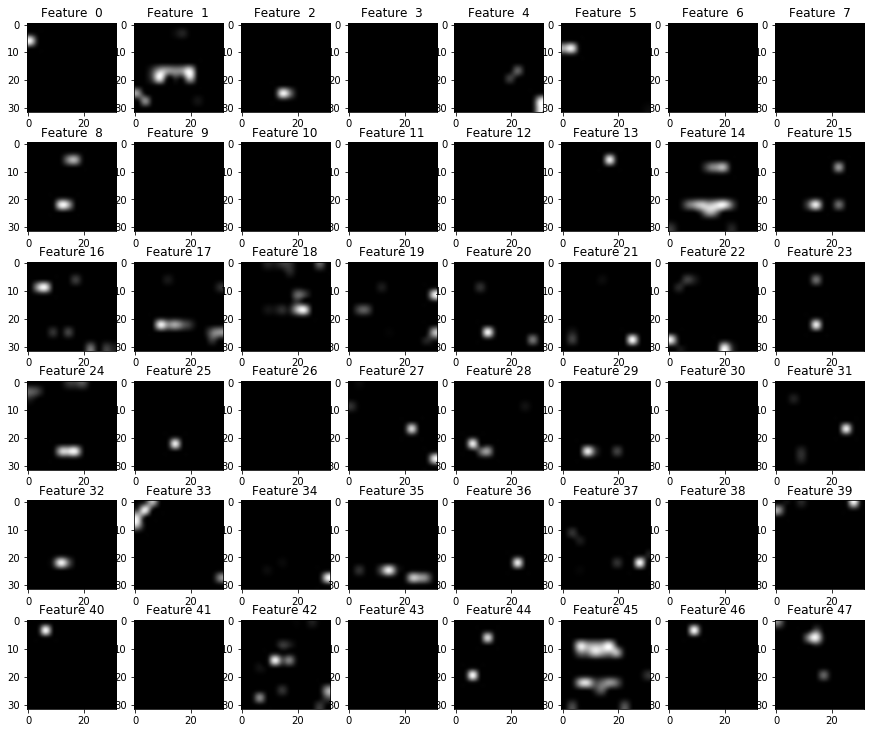

Layer 3


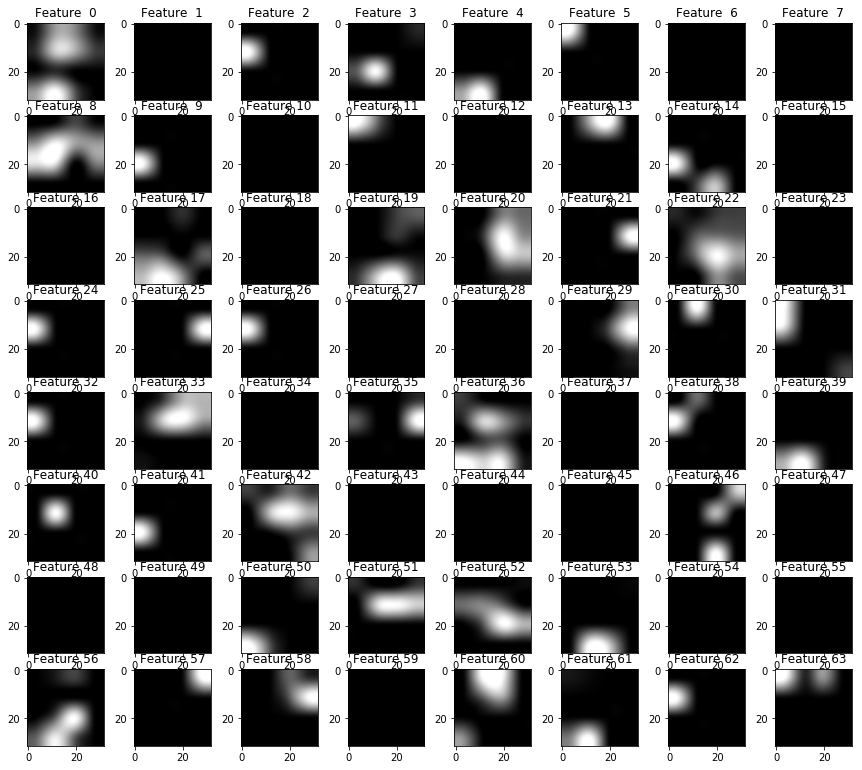

17 - No entry
    Predicted as: 17 - No entry


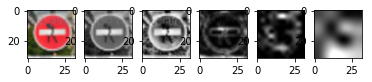

Layer 1


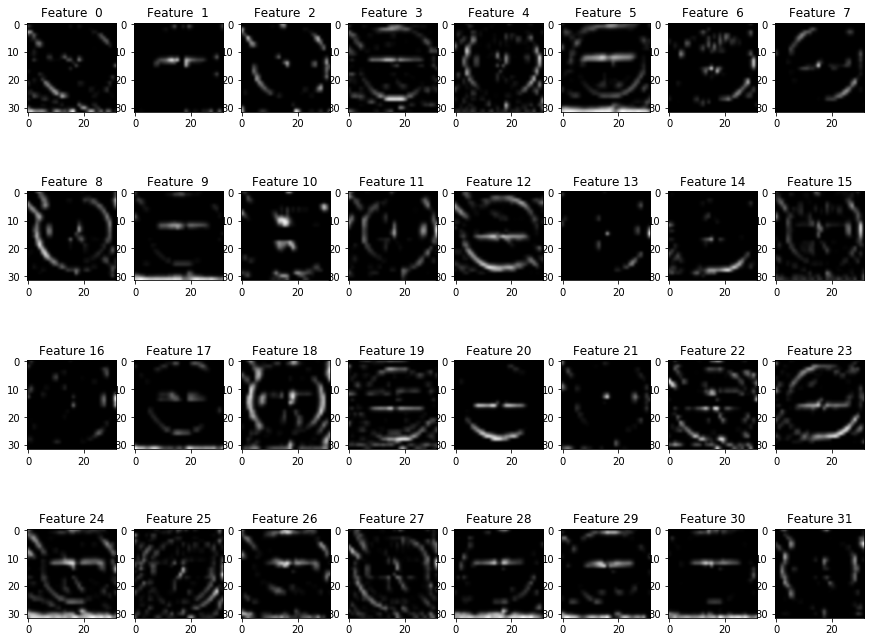

Layer 2


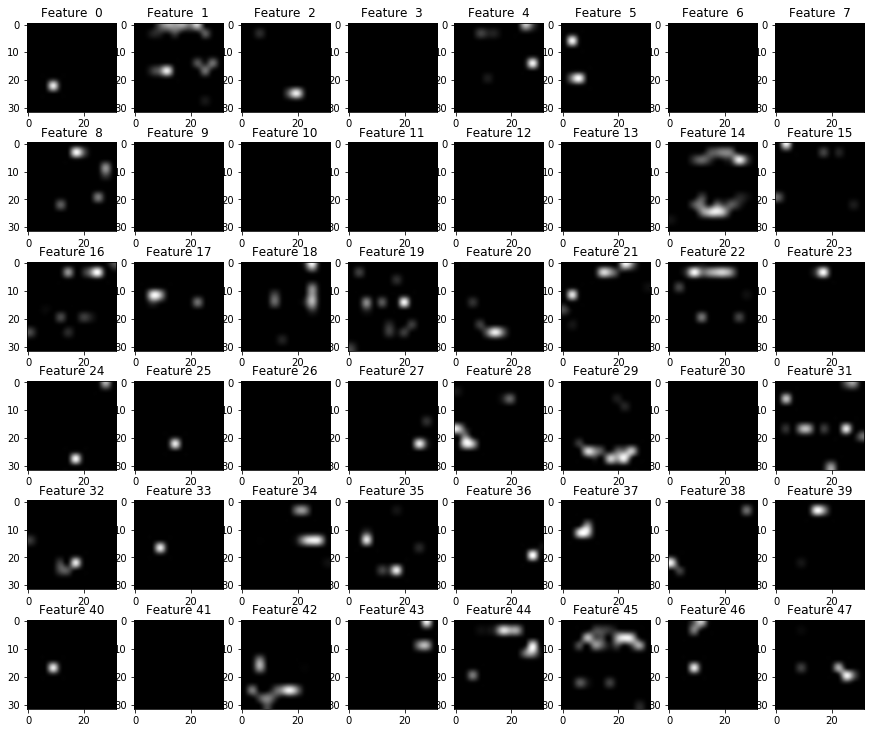

Layer 3


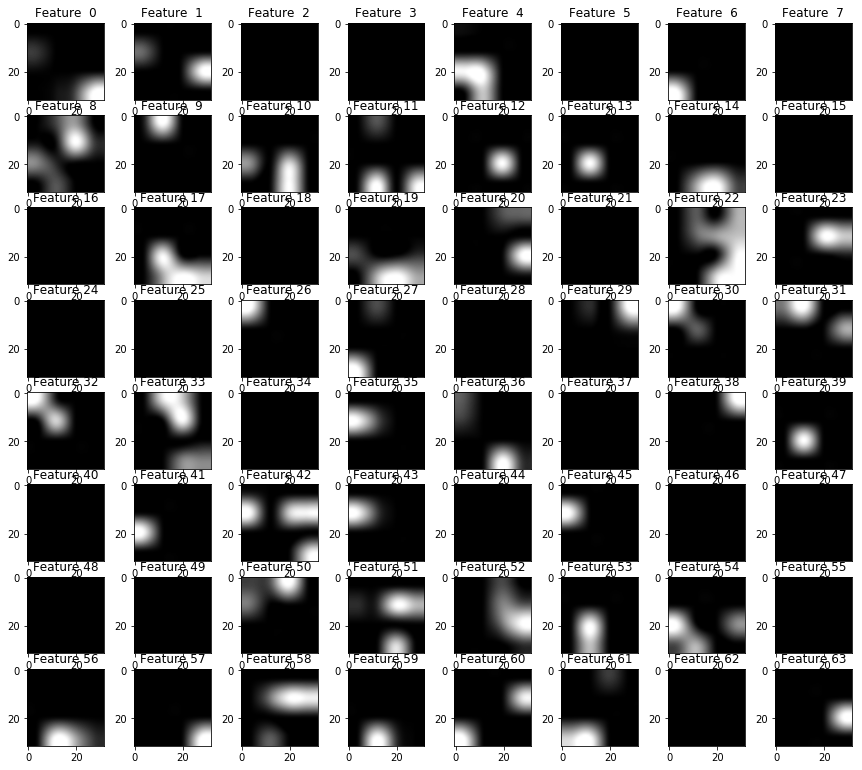

20 - Dangerous curve to the right
    Predicted as: 20 - Dangerous curve to the right


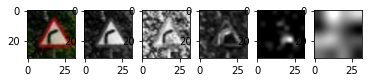

Layer 1


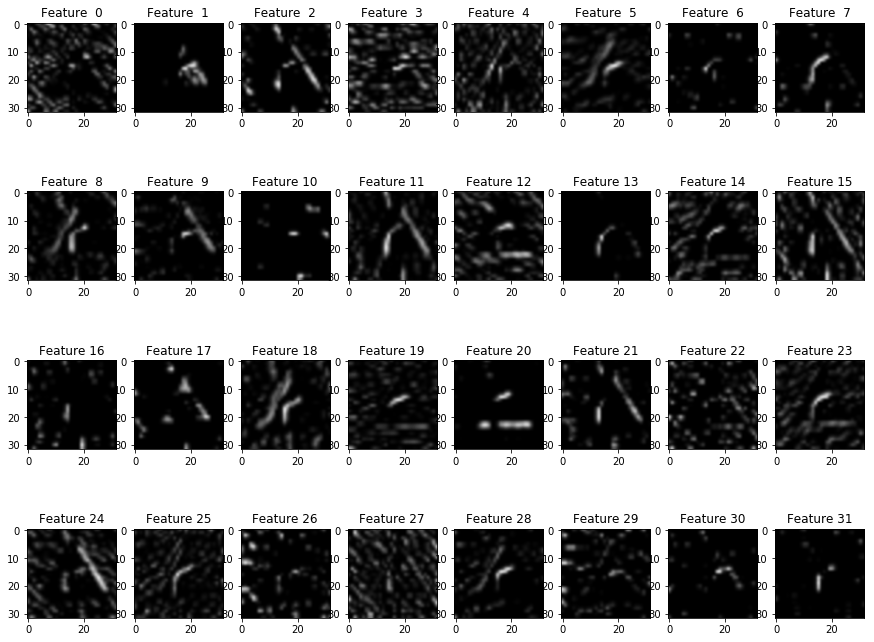

Layer 2


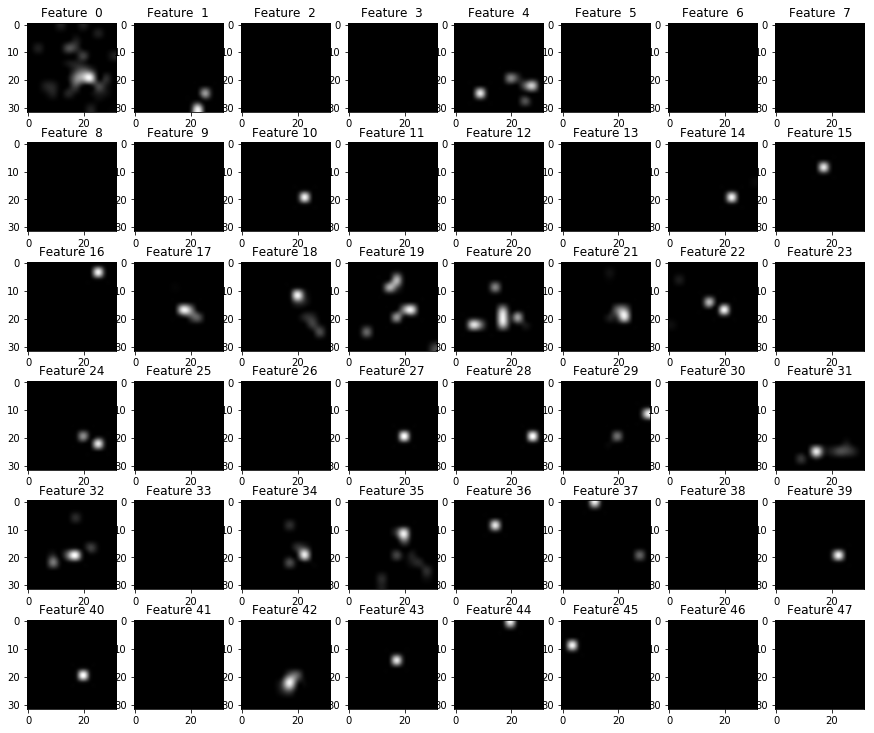

Layer 3


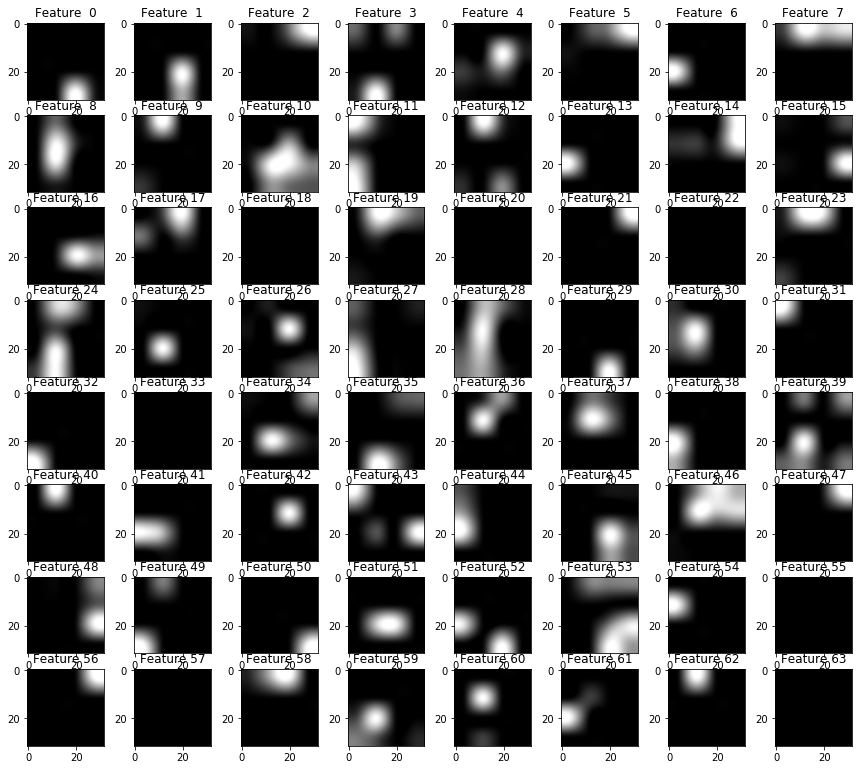

In [28]:
def print_layer_activations(data_set, activations_data, activation_min = None, activation_max = None, desc = 'Activations per layer:'):
    print(desc)

    isVirtualInt = int(data_set.isVirtual())
    img_shape = data_set.getImageShape()

    for data_idx in range(len(activations_data)):
        img, y_correct, y_predict, layer_act = activations_data[data_idx]

        print("{} - {}".format(y_correct, data_set.getDescriptions()[y_correct]))
        print("    Predicted as: {} - {}".format(y_predict, data_set.getDescriptions()[y_predict]))

        if isVirtualInt > 0:
            plt.subplot(1, img.shape[2] + isVirtualInt + len(layer_act), 1)
            plt.imshow(data_set.getData()[0][data_idx], interpolation="quadric")

        for img_idx in range(img.shape[2]):
            plt.subplot(1, img.shape[2] + isVirtualInt + len(layer_act), img_idx + 1 + isVirtualInt)
            plt.imshow(img[:, :, img_idx], interpolation="quadric", cmap="gray")

        layer_idx = 0
        for layer_act_w in layer_act:
            featuremaps = layer_act_w.shape[2]
            IsFirst = True

            for featuremap in range(featuremaps):
                cur_img = layer_act_w[:, :, featuremap]

                if activation_min == None:
                    val_min = np.min(cur_img)
                else:
                    val_min = activation_min

                if activation_max == None:
                    val_max = np.max(cur_img)
                else:
                    val_max = activation_max

                cur_img[cur_img < val_min] = val_min
                cur_img[cur_img > val_max] = val_max

                if val_min < val_max:
                    cur_img = ((cur_img - val_min) / (val_max - val_min)) * 255.0

                if IsFirst:
                    IsFirst = False
                    img_proc = cur_img
                else:
                    img_proc += cur_img

            img_proc /= featuremaps

            if activation_min == None:
                val_min = np.min(img_proc)
            else:
                val_min = activation_min

            if activation_max == None:
                val_max = np.max(img_proc)
            else:
                val_max = activation_max

            img_proc[img_proc < val_min] = val_min
            img_proc[img_proc > val_max] = val_max

            if val_min < val_max:
                img_proc = ((img_proc - val_min) / (val_max - val_min)) * 255.0

            img_proc = np.array(img_proc, dtype = np.uint8)
            img_proc = cv2.resize(img_proc, (img_shape[1], img_shape[0]), interpolation = cv2.INTER_CUBIC)

            plt.subplot(1, img.shape[2] + isVirtualInt + len(layer_act), img.shape[2] + 1 + isVirtualInt + layer_idx)
            plt.imshow(img_proc, interpolation="quadric", cmap="gray")

            layer_idx += 1
        
        plt.show()

        layer_num = 1
        for layer_act_w in layer_act:
            print("Layer {}".format(layer_num))
            plt.figure(figsize = (15, 15))

            featuremaps = layer_act_w.shape[2]
            for featuremap in range(featuremaps):
                plt.subplot(int((featuremaps / 8) + 1), 8, featuremap + 1)
                plt.title('Feature {:>2}'.format(featuremap))

                img_proc = layer_act_w[:, :, featuremap]
                if activation_min == None:
                    val_min = np.min(img_proc)
                else:
                    val_min = activation_min

                if activation_max == None:
                    val_max = np.max(img_proc)
                else:
                    val_max = activation_max

                img_proc[img_proc < val_min] = val_min
                img_proc[img_proc > val_max] = val_max

                if val_min < val_max:
                    img_proc = ((img_proc - val_min) / (val_max - val_min)) * 255.0

                img_proc = np.array(img_proc, dtype = np.uint8)
                img_proc = cv2.resize(img_proc, (img_shape[1], img_shape[0]), interpolation = cv2.INTER_CUBIC)

                plt.imshow(img_proc, interpolation="quadric", cmap="gray")

            layer_num += 1

            plt.show()
            
print_layer_activations(data_ext, model.get_batch_conv_activations(data_ext), activation_min = 0)